In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils 
import data
import torchvision
from torchvision import transforms

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import os
import glob 
from PIL import Image

In [3]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim
from skimage.measure import shannon_entropy

In [4]:
torch.__version__

'1.13.1+cu117'

In [5]:
#获取测试数据路径
# train_irimgs_path = glob.glob('data/MSRS-main/train/ir/*.png')
# train_viimgs_path = glob.glob('data/MSRS-main/train/vi/*.png')

train_irimgs_path = glob.glob('data/TNO/ir/*.png')
train_viimgs_path = glob.glob('data/TNO/vi/*.png')

#获取测试数据路径
test_irimgs_path = glob.glob('data/MSRS-main/test/ir/*.png')
test_viimgs_path = glob.glob('data/MSRS-main/test/vi/*.png')

In [6]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((256,256)),
    transforms.Normalize(mean=0.5,std=0.5)
])

In [7]:
vi_img = Image.open(train_viimgs_path[1])
ir_img = Image.open(train_irimgs_path[1])
ir_img = ir_img.convert('RGB')

In [8]:
np.array(ir_img).shape,np.array(vi_img).shape

((576, 768, 3), (576, 768, 3))

In [9]:
class FusionDataset(data.Dataset):
    def __init__(self,ir_path,vi_path):
        self.ir_path = train_irimgs_path
        self.vi_path = train_viimgs_path
    def __getitem__(self,idx):
        # 得到路径
        vi_path = self.vi_path[idx]
        ir_path = self.ir_path[idx]
        # 根据路径得到图片
        vi_img = Image.open(vi_path)
        ir_img = Image.open(ir_path) #ir红外读取为灰度秃了

        vi_img = transform(vi_img)
        ir_img = ir_img.convert('RGB')# 将灰度图转换为三通道再变化
        ir_img = transform(ir_img)
        return vi_img,ir_img
    def __len__(self):
        return len(self.ir_path)
        

In [10]:
train_ds = FusionDataset(train_irimgs_path,train_viimgs_path)
test_ds = FusionDataset(test_irimgs_path,test_viimgs_path)

In [11]:
BATCHSIZE = 32
train_dl = data.DataLoader(dataset=train_ds,
                          batch_size=BATCHSIZE,
                          shuffle=True)

test_dl = data.DataLoader(dataset=test_ds,
                          batch_size=BATCHSIZE,
                          shuffle=False)

In [12]:
ir_batch,vi_batch = next(iter(train_dl))

In [13]:
ir_batch.shape,vi_batch.shape

(torch.Size([32, 3, 256, 256]), torch.Size([32, 3, 256, 256]))

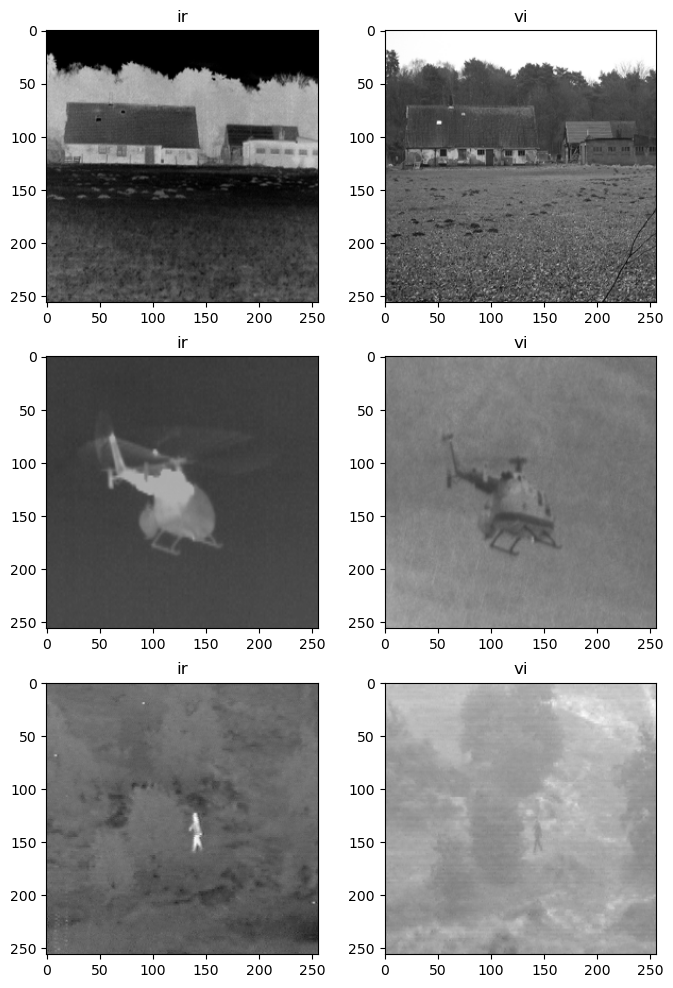

In [14]:
plt.figure(figsize = (8,12))
for i,(vi,ir) in enumerate(zip(ir_batch[:3],vi_batch[:3])):
    ir = (ir.permute(1,2,0).numpy()+1)/2
    vi = (vi.permute(1,2,0).numpy()+1)/2
    plt.subplot(3,2,2*i+1)
    plt.title('ir')
    plt.imshow(ir)
    plt.subplot(3,2,2*i+2)
    plt.title('vi')
    plt.imshow(vi)

In [15]:
#定义下采样模块
class Downsample(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(Downsample,self).__init__()
        self.conv_relu = nn.Sequential(
            nn.Conv2d(in_channels,out_channels,
                     kernel_size=3,
                     stride = 2,
                     padding=1),
            nn.LeakyReLU(inplace=True)
        )
        self.bn = nn.BatchNorm2d(out_channels)
    def forward(self,x,is_bn=True):
    # 生成器的输出层和判别器的输入层不使用BN
        x = self.conv_relu(x)
        if is_bn:
            x = self.bn(x)
        return x

In [16]:
#定义上采样模块
class Upsample(nn.Module):
    def __init__(self,in_channels,out_channels):
        super(Upsample,self).__init__()
        self.upconv_relu = nn.Sequential(
            nn.ConvTranspose2d(in_channels,out_channels,
                     kernel_size=3,
                     stride = 2,
                     padding=1,
                     output_padding=1),
            nn.LeakyReLU(inplace=True)
        )
        self.bn = nn.BatchNorm2d(out_channels)
    def forward(self,x,is_drop=False):
    # 生成器的输出层和判别器的输入层不使用BN
        x = self.upconv_relu(x)
        x = self.bn(x)
        if is_drop:
            x = F.dropout2d(x)
        return x

In [17]:
#下采样六次上采样5次
class Generator(nn.Module):
    def __init__(self):
        super(Generator,self).__init__()
        self.down1 = Downsample(6,64)
        self.down2 = Downsample(64,128)
        self.down3 = Downsample(128,256)
        self.down4 = Downsample(256,512)
        self.down5 = Downsample(512,512)
        self.down6 = Downsample(512,512)

        self.up1 = Upsample(512,512)
        self.up2 = Upsample(1024,512)
        self.up3 = Upsample(1024,256)
        self.up4 = Upsample(512,128)
        self.up5 = Upsample(256,64)
        
        self.last = nn.ConvTranspose2d(128,3,
                                      kernel_size=3,
                                      stride=2,
                                      padding=1,
                                      output_padding=1)
    def forward(self,vi,ir):
        x = torch.cat([vi,ir],dim=1)
        x1 = self.down1(x)
        x2 = self.down2(x1)
        x3 = self.down3(x2)
        x4 = self.down4(x3)
        x5 = self.down5(x4)
        x6 = self.down6(x5)

        x6 = self.up1(x6,is_drop = True)
        x6 = torch.cat([x6,x5],dim = 1)

        x6 = self.up2(x6,is_drop = True)
        x6 = torch.cat([x6,x4],dim = 1)

        x6 = self.up3(x6,is_drop = True)
        x6 = torch.cat([x6,x3],dim = 1)

        x6 = self.up4(x6)
        x6 = torch.cat([x6,x2],dim = 1)

        x6 = self.up5(x6)
        x6 = torch.cat([x6,x1],dim = 1)

        x6 = torch.tanh(self.last(x6))

        return x6

In [18]:
class Discriminator(nn.Module):
    # ir + vi concat
    def __init__(self):
        super(Discriminator,self).__init__()
        self.down1 = Downsample(3,64)
        self.down2 = Downsample(64,128)
        self.conv1 = nn.Conv2d(128,256,3)
        self.bn = nn.BatchNorm2d(256)
        self.last = nn.Conv2d(256,1,3)
    def forward(self,ir,vi):
        # x = torch.cat([ir,vi],axis = 1)
        x =vi
        x = self.down1(x,is_bn=False)
        x = self.down2(x)
        x = F.dropout2d(self.bn(F.leaky_relu(self.conv1(x))))
        x = torch.sigmoid(self.last(x))
        return x

In [19]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [20]:
gen = Generator().to(device)
dis = Discriminator().to(device)

In [21]:
d_optimizer = torch.optim.Adam(dis.parameters(),lr = 1e-3,betas=(0.5,0.999))
g_optimizer = torch.optim.Adam(gen.parameters(),lr = 1e-3,betas=(0.5,0.999))

In [22]:
# 定义损失函数
loss_fn = torch.nn.BCELoss()
# L1

In [23]:
LAMDA = 7

In [24]:
def calculate_metrics(vi, ir,fusion):
    # Information Entropy (EN)
    def calculate_entropy(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        entropy_value = shannon_entropy(img_gray)
        return entropy_value

    # Standard Deviation (SD)
    def calculate_sd(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        sd_value = np.std(img_gray)
        return sd_value

    # Structural Similarity Index (SSIM)
    def calculate_ssim(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        ssim_index_A, _ = ssim(img1_gray, fusion_gray, full=True)
        ssim_index_B, _ = ssim(img2_gray, fusion_gray, full=True)
        return (ssim_index_A + ssim_index_B)/2 

    

    # Correlation Coefficient (CC)
    def calculate_cc(vi, ir ,fusion):
        img1_flat = vi.flatten()
        img2_flat = ir.flatten()
        fusion_flat = fusion.flatten()
        
        correlation_coefficient_A = np.corrcoef(img1_flat, fusion_flat)[0, 1]
        correlation_coefficient_B = np.corrcoef(img2_flat, fusion_flat)[0, 1]
        
        return (correlation_coefficient_A + correlation_coefficient_B)/2

    # Spatial Frequency (SF)
    def calculate_sf(fusion):
        img_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        f = np.fft.fft2(img_gray)
        fshift = np.fft.fftshift(f)
        magnitude_spectrum = 20 * np.log(np.abs(fshift))
        spatial_frequency = np.sum(magnitude_spectrum) / img_gray.size
        return spatial_frequency

    # Variable Luminance Fusion Index (VLF)
    def calculate_vlf(vi, ir ,fusion):
        img1_gray = cv2.cvtColor(vi, cv2.COLOR_BGR2GRAY)
        img2_gray = cv2.cvtColor(ir, cv2.COLOR_BGR2GRAY)
        fusion_gray = cv2.cvtColor(fusion, cv2.COLOR_BGR2GRAY)
        
        vlf_value_A = np.sum(np.abs(img1_gray - fusion_gray)) / img1_gray.size
        vlf_value_B = np.sum(np.abs(img2_gray - fusion_gray)) / img2_gray.size
        
        return (vlf_value_A + vlf_value_B)/2

    # Calculate metrics
    entropy_value = calculate_entropy(fusion)
    sd_value = calculate_sd(fusion)
    ssim_value = calculate_ssim(vi, ir,fusion)
    cc_value = calculate_cc(vi, ir,fusion)
    sf_value = calculate_sf(fusion)
    vlf_value = calculate_vlf(vi, ir,fusion)
    return {
        'Entropy': entropy_value,
        'Standard Deviation': sd_value,
        'SSIM': ssim_value,
        'Correlation Coefficient': cc_value,
        'Spatial Frequency': sf_value,
        'Variable Luminance Fusion Index': vlf_value
    }

In [25]:
def genarate_images(model,ir,vi):
    prediction = model(vi,ir).permute(0,2,3,1).detach().cpu().numpy()
    ir = ir.permute(0,2,3,1).cpu().numpy()
    vi = vi.permute(0,2,3,1).cpu().numpy()
    plt.figure(figsize=(10,10))
    display_list = [ir[0],vi[0],prediction[0]]
    fusion_result = calculate_metrics(vi[0], ir[0],prediction[0])
    print(fusion_result)
    title = ['ir','vi','fusion']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(title[i])
        plt.imshow(display_list[i]*0.5+0.5)
        plt.axis('off')
    plt.show()
    return fusion_result

Epoch: 0 {'Entropy': 15.99859619140625, 'Standard Deviation': 0.47318342, 'SSIM': 0.014842370204849721, 'Correlation Coefficient': 0.29480767465605473, 'Spatial Frequency': 77.15537549466094, 'Variable Luminance Fusion Index': 0.4506591260433197}


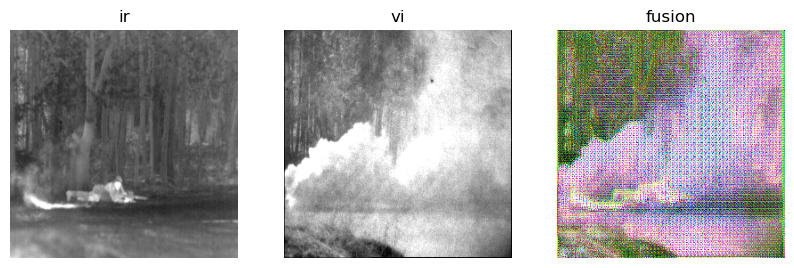

D_epoch_loss:2.069250464439392,G_epoch_loss5.178660154342651
Epoch: 1 D_epoch_loss:1.4472351670265198,G_epoch_loss3.6442646980285645
Epoch: 2 D_epoch_loss:1.396469235420227,G_epoch_loss3.1211085319519043
Epoch: 3 D_epoch_loss:1.3885048031806946,G_epoch_loss2.7601699829101562
Epoch: 4 D_epoch_loss:1.4851614236831665,G_epoch_loss2.5577398538589478
Epoch: 5 D_epoch_loss:1.3827764987945557,G_epoch_loss2.467715263366699
Epoch: 6 D_epoch_loss:1.3350796699523926,G_epoch_loss2.2823915481567383
Epoch: 7 D_epoch_loss:1.4262386560440063,G_epoch_loss2.382050633430481
Epoch: 8 D_epoch_loss:1.4020981192588806,G_epoch_loss2.1611474752426147
Epoch: 9 D_epoch_loss:1.403028964996338,G_epoch_loss2.1667078733444214
Epoch: 10 D_epoch_loss:1.3334261178970337,G_epoch_loss2.2188873291015625
Epoch: 11 D_epoch_loss:1.234817922115326,G_epoch_loss2.175206422805786
Epoch: 12 D_epoch_loss:1.4600849747657776,G_epoch_loss2.1996856927871704
Epoch: 13 D_epoch_loss:1.4227280616760254,G_epoch_loss2.0926231145858765
Epoch

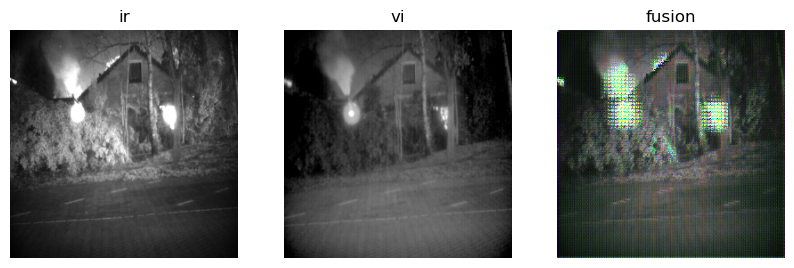

D_epoch_loss:0.9109179675579071,G_epoch_loss2.346006751060486
Epoch: 48 D_epoch_loss:0.7492766082286835,G_epoch_loss2.510529041290283
Epoch: 49 D_epoch_loss:0.8926333785057068,G_epoch_loss2.421630859375
Epoch: 50 D_epoch_loss:0.7394155263900757,G_epoch_loss2.3581374883651733
Epoch: 51 D_epoch_loss:0.7959185242652893,G_epoch_loss2.5896639823913574
Epoch: 52 D_epoch_loss:0.8562212884426117,G_epoch_loss2.6498876810073853
Epoch: 53 D_epoch_loss:0.8272996246814728,G_epoch_loss2.658432722091675
Epoch: 54 D_epoch_loss:0.7521409392356873,G_epoch_loss2.696537733078003
Epoch: 55 D_epoch_loss:0.7284533083438873,G_epoch_loss2.544669270515442
Epoch: 56 D_epoch_loss:0.7777851223945618,G_epoch_loss2.6273778676986694
Epoch: 57 D_epoch_loss:0.7692822217941284,G_epoch_loss2.6890727281570435
Epoch: 58 D_epoch_loss:0.7711023688316345,G_epoch_loss2.52899706363678
Epoch: 59 D_epoch_loss:0.8050298392772675,G_epoch_loss2.4899567365646362
Epoch: 60 D_epoch_loss:0.900516152381897,G_epoch_loss2.732550024986267
E

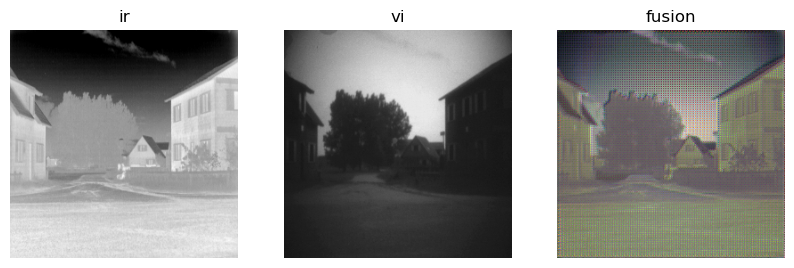

D_epoch_loss:0.42953938245773315,G_epoch_loss3.4596238136291504
Epoch: 95 D_epoch_loss:0.42515838146209717,G_epoch_loss3.749101400375366
Epoch: 96 D_epoch_loss:0.4122540056705475,G_epoch_loss3.769823670387268
Epoch: 97 D_epoch_loss:0.33370745182037354,G_epoch_loss3.629643678665161
Epoch: 98 D_epoch_loss:0.39800044894218445,G_epoch_loss3.831738233566284
Epoch: 99 D_epoch_loss:0.3692898005247116,G_epoch_loss3.701138973236084
Epoch: 100 D_epoch_loss:0.32807016372680664,G_epoch_loss3.715899348258972
Epoch: 101 D_epoch_loss:0.30907265841960907,G_epoch_loss3.797208786010742
Epoch: 102 D_epoch_loss:0.33215804398059845,G_epoch_loss3.9926230907440186
Epoch: 103 D_epoch_loss:0.3907204121351242,G_epoch_loss3.856379508972168
Epoch: 104 D_epoch_loss:0.28055956959724426,G_epoch_loss4.204171895980835
Epoch: 105 D_epoch_loss:0.34666454792022705,G_epoch_loss4.118541240692139
Epoch: 106 D_epoch_loss:0.32151125371456146,G_epoch_loss3.9865036010742188
Epoch: 107 D_epoch_loss:0.36676788330078125,G_epoch_lo

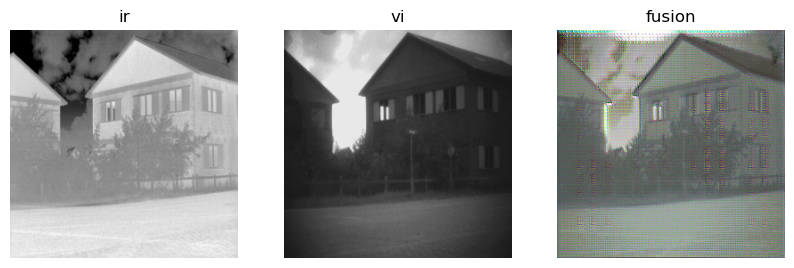

D_epoch_loss:0.31731116771698,G_epoch_loss3.9701786041259766
Epoch: 142 D_epoch_loss:0.31551823019981384,G_epoch_loss4.300538063049316
Epoch: 143 D_epoch_loss:0.30714747309684753,G_epoch_loss4.920109987258911
Epoch: 144 D_epoch_loss:0.2652241289615631,G_epoch_loss4.571572303771973
Epoch: 145 D_epoch_loss:0.32656168937683105,G_epoch_loss4.359068393707275
Epoch: 146 D_epoch_loss:0.3527340590953827,G_epoch_loss4.421722173690796
Epoch: 147 D_epoch_loss:0.31233522295951843,G_epoch_loss4.559267520904541
Epoch: 148 D_epoch_loss:0.27863016724586487,G_epoch_loss4.519006252288818
Epoch: 149 D_epoch_loss:0.24230900406837463,G_epoch_loss4.4941699504852295
Epoch: 150 D_epoch_loss:0.2844778895378113,G_epoch_loss4.57587742805481
Epoch: 151 D_epoch_loss:0.2563117817044258,G_epoch_loss4.424779891967773
Epoch: 152 D_epoch_loss:0.21423622965812683,G_epoch_loss4.498189449310303
Epoch: 153 D_epoch_loss:0.2954583168029785,G_epoch_loss4.554223299026489
Epoch: 154 D_epoch_loss:0.23110853135585785,G_epoch_loss

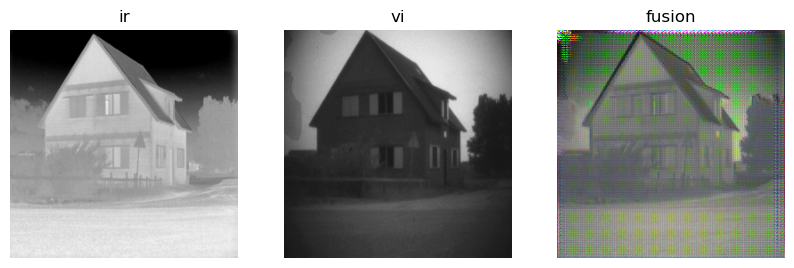

D_epoch_loss:0.13062608987092972,G_epoch_loss5.345822334289551
Epoch: 189 D_epoch_loss:0.1108919084072113,G_epoch_loss5.485881567001343
Epoch: 190 D_epoch_loss:0.11018683016300201,G_epoch_loss5.358947038650513
Epoch: 191 D_epoch_loss:0.12772345542907715,G_epoch_loss5.19498348236084
Epoch: 192 D_epoch_loss:0.09334895387291908,G_epoch_loss5.5511391162872314
Epoch: 193 D_epoch_loss:0.1576383262872696,G_epoch_loss5.612856149673462
Epoch: 194 D_epoch_loss:0.09712032601237297,G_epoch_loss5.601780891418457
Epoch: 195 D_epoch_loss:0.13925687968730927,G_epoch_loss5.855924129486084
Epoch: 196 D_epoch_loss:0.11951889842748642,G_epoch_loss5.621938943862915
Epoch: 197 D_epoch_loss:0.08658808097243309,G_epoch_loss5.673152446746826
Epoch: 198 D_epoch_loss:0.09379091486334801,G_epoch_loss5.526339054107666
Epoch: 199 D_epoch_loss:0.10100402683019638,G_epoch_loss5.616976976394653
Epoch: 200 D_epoch_loss:0.08881311491131783,G_epoch_loss5.5015869140625
Epoch: 201 D_epoch_loss:0.12268245965242386,G_epoch_l

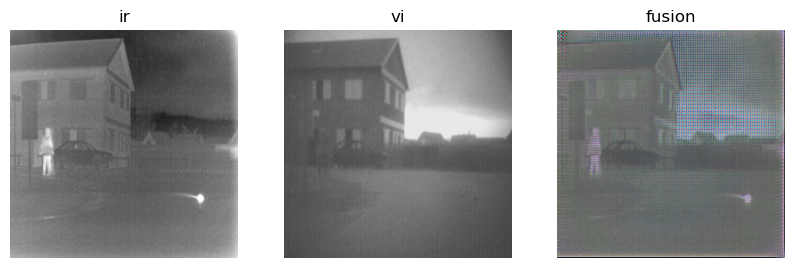

D_epoch_loss:0.25686217844486237,G_epoch_loss3.875690460205078
Epoch: 236 D_epoch_loss:0.23977941274642944,G_epoch_loss4.690825700759888
Epoch: 237 D_epoch_loss:0.1966513842344284,G_epoch_loss4.384160280227661
Epoch: 238 D_epoch_loss:0.19963304698467255,G_epoch_loss4.031908988952637
Epoch: 239 D_epoch_loss:0.20028739422559738,G_epoch_loss4.426720857620239
Epoch: 240 D_epoch_loss:0.21351690590381622,G_epoch_loss4.042621612548828
Epoch: 241 D_epoch_loss:0.1607709527015686,G_epoch_loss4.657881259918213
Epoch: 242 D_epoch_loss:0.19032356142997742,G_epoch_loss4.3647308349609375
Epoch: 243 D_epoch_loss:0.16201531887054443,G_epoch_loss4.491629123687744
Epoch: 244 D_epoch_loss:0.16363698989152908,G_epoch_loss4.278022527694702
Epoch: 245 D_epoch_loss:0.16094151139259338,G_epoch_loss4.295165300369263
Epoch: 246 D_epoch_loss:0.16956771910190582,G_epoch_loss4.534563064575195
Epoch: 247 D_epoch_loss:0.13271277397871017,G_epoch_loss4.854022026062012
Epoch: 248 D_epoch_loss:0.12319904565811157,G_epoc

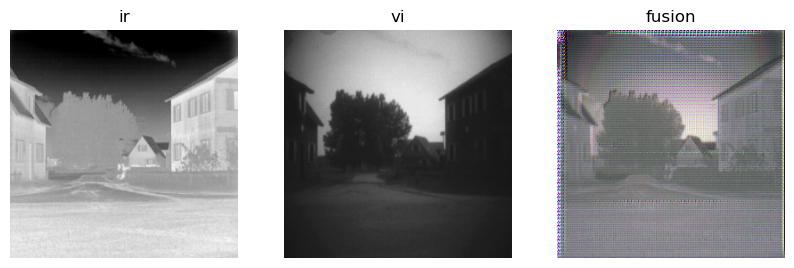

D_epoch_loss:0.07314914092421532,G_epoch_loss5.444603204727173
Epoch: 283 D_epoch_loss:0.07645193114876747,G_epoch_loss5.509973049163818
Epoch: 284 D_epoch_loss:0.07782311737537384,G_epoch_loss5.89793062210083
Epoch: 285 D_epoch_loss:0.04898270219564438,G_epoch_loss6.072279930114746
Epoch: 286 D_epoch_loss:0.04154149815440178,G_epoch_loss5.979001045227051
Epoch: 287 D_epoch_loss:0.04926443658769131,G_epoch_loss5.424334287643433
Epoch: 288 D_epoch_loss:0.05803595669567585,G_epoch_loss5.442291259765625
Epoch: 289 D_epoch_loss:0.0387290995568037,G_epoch_loss6.292067289352417
Epoch: 290 D_epoch_loss:0.03999197483062744,G_epoch_loss6.257385492324829
Epoch: 291 D_epoch_loss:0.06260142475366592,G_epoch_loss6.146722793579102
Epoch: 292 D_epoch_loss:0.04872790537774563,G_epoch_loss6.245773077011108
Epoch: 293 D_epoch_loss:0.04255227372050285,G_epoch_loss5.734872341156006
Epoch: 294 D_epoch_loss:0.04192465916275978,G_epoch_loss6.097924709320068
Epoch: 295 D_epoch_loss:0.05603313073515892,G_epoch

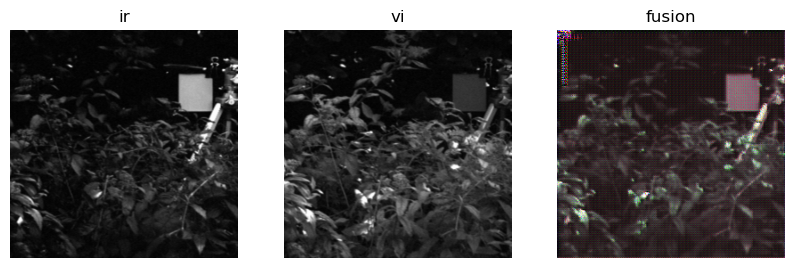

D_epoch_loss:0.03069473337382078,G_epoch_loss7.2551844120025635
Epoch: 330 D_epoch_loss:0.029960081912577152,G_epoch_loss7.270156145095825
Epoch: 331 D_epoch_loss:0.022232932969927788,G_epoch_loss7.3363730907440186
Epoch: 332 D_epoch_loss:0.020551453344523907,G_epoch_loss7.172791242599487
Epoch: 333 D_epoch_loss:0.034101126715540886,G_epoch_loss6.721327781677246
Epoch: 334 D_epoch_loss:0.029064470902085304,G_epoch_loss6.204967737197876
Epoch: 335 D_epoch_loss:0.03124730009585619,G_epoch_loss7.181646108627319
Epoch: 336 D_epoch_loss:0.028965458273887634,G_epoch_loss7.187611818313599
Epoch: 337 D_epoch_loss:0.025726143270730972,G_epoch_loss6.904376268386841
Epoch: 338 D_epoch_loss:0.027131948620080948,G_epoch_loss6.3537304401397705
Epoch: 339 D_epoch_loss:0.04549929313361645,G_epoch_loss6.567063570022583
Epoch: 340 D_epoch_loss:0.033019919879734516,G_epoch_loss6.888060569763184
Epoch: 341 D_epoch_loss:0.02701741922646761,G_epoch_loss6.874795436859131
Epoch: 342 D_epoch_loss:0.03314071334

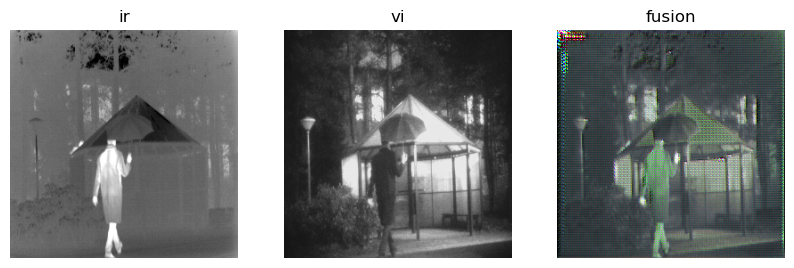

D_epoch_loss:0.021760113537311554,G_epoch_loss7.564639568328857
Epoch: 377 D_epoch_loss:0.027582594193518162,G_epoch_loss6.762393951416016
Epoch: 378 D_epoch_loss:0.02902087289839983,G_epoch_loss6.830477237701416
Epoch: 379 D_epoch_loss:0.026465742848813534,G_epoch_loss6.654531002044678
Epoch: 380 D_epoch_loss:0.03287731111049652,G_epoch_loss6.458852767944336
Epoch: 381 D_epoch_loss:0.045308250933885574,G_epoch_loss6.950002670288086
Epoch: 382 D_epoch_loss:0.024674358777701855,G_epoch_loss7.784435272216797
Epoch: 383 D_epoch_loss:0.019812826067209244,G_epoch_loss7.652246713638306
Epoch: 384 D_epoch_loss:0.024201677180826664,G_epoch_loss7.0763115882873535
Epoch: 385 D_epoch_loss:0.01933592837303877,G_epoch_loss7.458558559417725
Epoch: 386 D_epoch_loss:0.022639302536845207,G_epoch_loss7.263725757598877
Epoch: 387 D_epoch_loss:0.018406130373477936,G_epoch_loss6.811260938644409
Epoch: 388 D_epoch_loss:0.021965225227177143,G_epoch_loss7.154412269592285
Epoch: 389 D_epoch_loss:0.023459525778

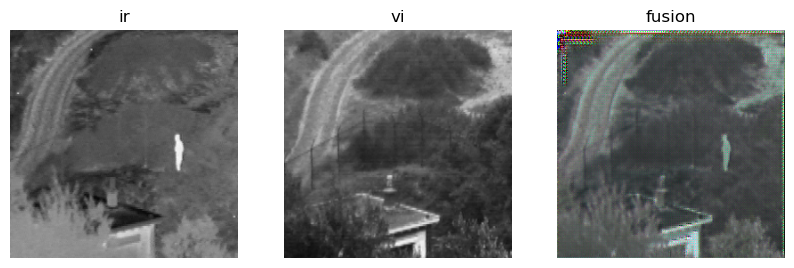

D_epoch_loss:0.023288301192224026,G_epoch_loss6.954559087753296
Epoch: 424 D_epoch_loss:0.018981944769620895,G_epoch_loss7.025630712509155
Epoch: 425 D_epoch_loss:0.018693423829972744,G_epoch_loss6.8250298500061035
Epoch: 426 D_epoch_loss:0.01524412352591753,G_epoch_loss7.655643939971924
Epoch: 427 D_epoch_loss:0.012949446216225624,G_epoch_loss7.743694067001343
Epoch: 428 D_epoch_loss:0.015669325832277536,G_epoch_loss7.090521335601807
Epoch: 429 D_epoch_loss:0.022173598408699036,G_epoch_loss6.76240611076355
Epoch: 430 D_epoch_loss:0.010851682629436255,G_epoch_loss8.579801082611084
Epoch: 431 D_epoch_loss:0.008362785913050175,G_epoch_loss8.477123737335205
Epoch: 432 D_epoch_loss:0.012477243784815073,G_epoch_loss7.278744459152222
Epoch: 433 D_epoch_loss:0.01337618101388216,G_epoch_loss7.8059492111206055
Epoch: 434 D_epoch_loss:0.00897634169086814,G_epoch_loss7.6545634269714355
Epoch: 435 D_epoch_loss:0.014290925581008196,G_epoch_loss7.361870765686035
Epoch: 436 D_epoch_loss:0.01070142723

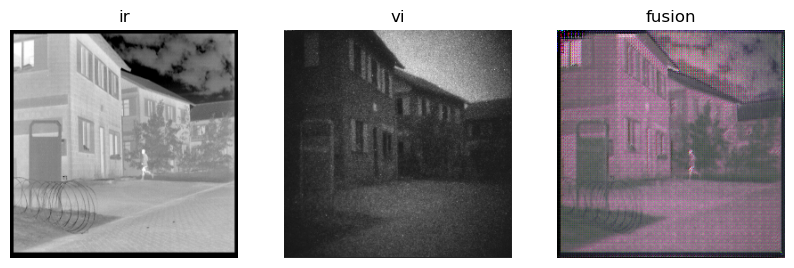

D_epoch_loss:0.3413625806570053,G_epoch_loss4.520878076553345
Epoch: 471 D_epoch_loss:0.18587128072977066,G_epoch_loss5.79534649848938
Epoch: 472 D_epoch_loss:0.1228874921798706,G_epoch_loss5.544068336486816
Epoch: 473 D_epoch_loss:0.23494477570056915,G_epoch_loss4.728529453277588
Epoch: 474 D_epoch_loss:0.1618713065981865,G_epoch_loss5.016982078552246
Epoch: 475 D_epoch_loss:0.15897928178310394,G_epoch_loss4.841063737869263
Epoch: 476 D_epoch_loss:0.21497488021850586,G_epoch_loss4.81453275680542
Epoch: 477 D_epoch_loss:0.35205692052841187,G_epoch_loss3.8944027423858643
Epoch: 478 D_epoch_loss:0.27483931183815,G_epoch_loss4.462220668792725
Epoch: 479 D_epoch_loss:0.20249005407094955,G_epoch_loss4.517924547195435
Epoch: 480 D_epoch_loss:0.18536527454853058,G_epoch_loss4.642542362213135
Epoch: 481 D_epoch_loss:0.15853875875473022,G_epoch_loss4.602165460586548
Epoch: 482 D_epoch_loss:0.11694615334272385,G_epoch_loss5.486627578735352
Epoch: 483 D_epoch_loss:0.12740907818078995,G_epoch_loss

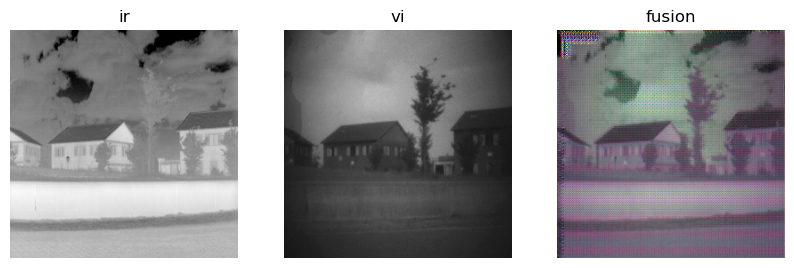

D_epoch_loss:0.0782412588596344,G_epoch_loss5.652618646621704
Epoch: 518 D_epoch_loss:0.043131373822689056,G_epoch_loss7.524369716644287
Epoch: 519 D_epoch_loss:0.039238329976797104,G_epoch_loss7.207143306732178
Epoch: 520 D_epoch_loss:0.03238446172326803,G_epoch_loss6.896605730056763
Epoch: 521 D_epoch_loss:0.03845617733895779,G_epoch_loss6.016701936721802
Epoch: 522 D_epoch_loss:0.027526509016752243,G_epoch_loss7.248969316482544
Epoch: 523 D_epoch_loss:0.03610917180776596,G_epoch_loss6.702815532684326
Epoch: 524 D_epoch_loss:0.042348284274339676,G_epoch_loss6.045362710952759
Epoch: 525 D_epoch_loss:0.051096612587571144,G_epoch_loss5.712322235107422
Epoch: 526 D_epoch_loss:0.05544729717075825,G_epoch_loss5.569254636764526
Epoch: 527 D_epoch_loss:0.06051233038306236,G_epoch_loss5.880645513534546
Epoch: 528 D_epoch_loss:0.05312732607126236,G_epoch_loss5.353747367858887
Epoch: 529 D_epoch_loss:0.04128449410200119,G_epoch_loss6.845125198364258
Epoch: 530 D_epoch_loss:0.026673165149986744,

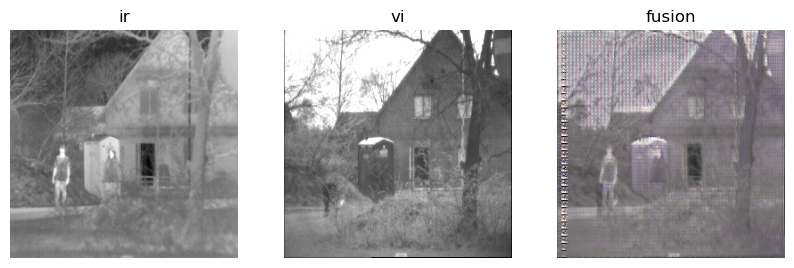

D_epoch_loss:0.029708245769143105,G_epoch_loss6.228692054748535
Epoch: 565 D_epoch_loss:0.028578354977071285,G_epoch_loss6.037832260131836
Epoch: 566 D_epoch_loss:0.031379325315356255,G_epoch_loss6.67158317565918
Epoch: 567 D_epoch_loss:0.03020261973142624,G_epoch_loss6.676609992980957
Epoch: 568 D_epoch_loss:0.027868973091244698,G_epoch_loss6.229531764984131
Epoch: 569 D_epoch_loss:0.037094637751579285,G_epoch_loss6.135279655456543
Epoch: 570 D_epoch_loss:0.036898013204336166,G_epoch_loss6.081480979919434
Epoch: 571 D_epoch_loss:0.04061144217848778,G_epoch_loss8.914017677307129
Epoch: 572 D_epoch_loss:0.03316440433263779,G_epoch_loss8.966782569885254
Epoch: 573 D_epoch_loss:0.019598831422626972,G_epoch_loss8.803482055664062
Epoch: 574 D_epoch_loss:0.02180625218898058,G_epoch_loss8.940358638763428
Epoch: 575 D_epoch_loss:0.01244767289608717,G_epoch_loss8.736055850982666
Epoch: 576 D_epoch_loss:0.016586586833000183,G_epoch_loss8.38207197189331
Epoch: 577 D_epoch_loss:0.01752827968448400

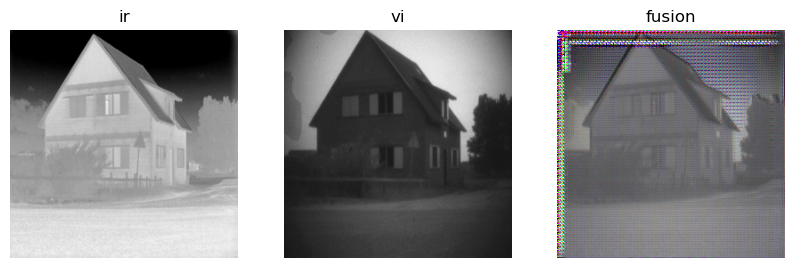

D_epoch_loss:0.03237255848944187,G_epoch_loss7.450881481170654
Epoch: 612 D_epoch_loss:0.02122553437948227,G_epoch_loss7.744021415710449
Epoch: 613 D_epoch_loss:0.013304523658007383,G_epoch_loss7.652423858642578
Epoch: 614 D_epoch_loss:0.017242902889847755,G_epoch_loss7.504617214202881
Epoch: 615 D_epoch_loss:0.01757676061242819,G_epoch_loss7.3734962940216064
Epoch: 616 D_epoch_loss:0.025123129598796368,G_epoch_loss7.01189923286438
Epoch: 617 D_epoch_loss:0.012986681424081326,G_epoch_loss8.012889862060547
Epoch: 618 D_epoch_loss:0.01771615631878376,G_epoch_loss7.65381383895874
Epoch: 619 D_epoch_loss:0.02589377947151661,G_epoch_loss7.276657581329346
Epoch: 620 D_epoch_loss:0.028315910138189793,G_epoch_loss6.621206045150757
Epoch: 621 D_epoch_loss:0.022731437347829342,G_epoch_loss6.719611644744873
Epoch: 622 D_epoch_loss:0.016796212643384933,G_epoch_loss7.661925554275513
Epoch: 623 D_epoch_loss:0.01156840194016695,G_epoch_loss7.7629101276397705
Epoch: 624 D_epoch_loss:0.0206617768853902

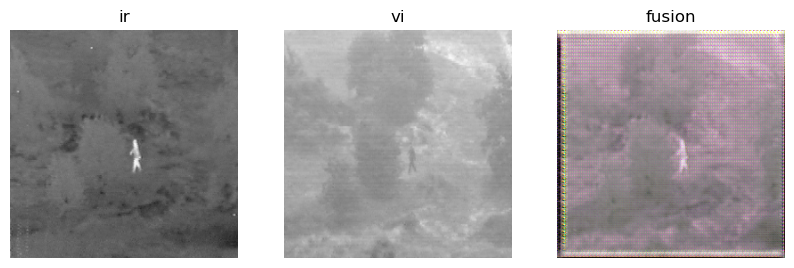

D_epoch_loss:0.015126197598874569,G_epoch_loss7.744298219680786
Epoch: 659 D_epoch_loss:0.014768216758966446,G_epoch_loss7.953130006790161
Epoch: 660 D_epoch_loss:0.019594352692365646,G_epoch_loss6.841884613037109
Epoch: 661 D_epoch_loss:0.020000841468572617,G_epoch_loss6.773779392242432
Epoch: 662 D_epoch_loss:0.020343437790870667,G_epoch_loss6.586489677429199
Epoch: 663 D_epoch_loss:0.022693649865686893,G_epoch_loss6.6717681884765625
Epoch: 664 D_epoch_loss:0.014951959252357483,G_epoch_loss8.065263748168945
Epoch: 665 D_epoch_loss:0.009010815992951393,G_epoch_loss9.412839412689209
Epoch: 666 D_epoch_loss:0.0075332424603402615,G_epoch_loss9.780141353607178
Epoch: 667 D_epoch_loss:0.012430559378117323,G_epoch_loss9.580204010009766
Epoch: 668 D_epoch_loss:0.010225955862551928,G_epoch_loss9.115848064422607
Epoch: 669 D_epoch_loss:0.025250385981053114,G_epoch_loss8.348926305770874
Epoch: 670 D_epoch_loss:0.014424629509449005,G_epoch_loss7.666213512420654
Epoch: 671 D_epoch_loss:0.01343314

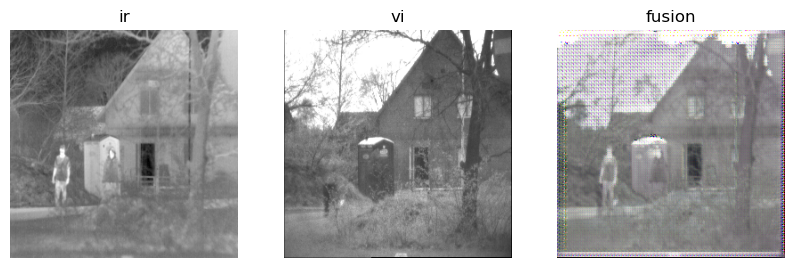

D_epoch_loss:0.01450481778010726,G_epoch_loss7.080913305282593
Epoch: 706 D_epoch_loss:0.01868461910635233,G_epoch_loss7.192200422286987
Epoch: 707 D_epoch_loss:0.00715606682933867,G_epoch_loss10.368463039398193
Epoch: 708 D_epoch_loss:0.009177593048661947,G_epoch_loss9.656085014343262
Epoch: 709 D_epoch_loss:0.00814496073871851,G_epoch_loss9.030519008636475
Epoch: 710 D_epoch_loss:0.008077816804870963,G_epoch_loss8.400638580322266
Epoch: 711 D_epoch_loss:0.012647085823118687,G_epoch_loss7.4802234172821045
Epoch: 712 D_epoch_loss:0.020464842207729816,G_epoch_loss6.973477840423584
Epoch: 713 D_epoch_loss:0.011173693463206291,G_epoch_loss7.983486652374268
Epoch: 714 D_epoch_loss:0.018997379578649998,G_epoch_loss7.241850137710571
Epoch: 715 D_epoch_loss:0.017072928603738546,G_epoch_loss6.999109268188477
Epoch: 716 D_epoch_loss:0.01541842520236969,G_epoch_loss7.061868667602539
Epoch: 717 D_epoch_loss:0.013739234302192926,G_epoch_loss6.843767166137695
Epoch: 718 D_epoch_loss:0.0181534383445

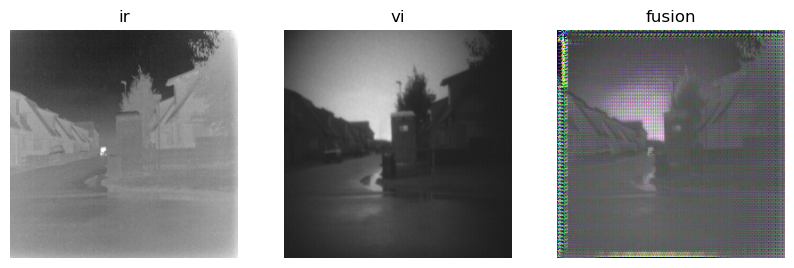

D_epoch_loss:0.012466067913919687,G_epoch_loss7.591141939163208
Epoch: 753 D_epoch_loss:0.01753462152555585,G_epoch_loss8.061732292175293
Epoch: 754 D_epoch_loss:0.012997849844396114,G_epoch_loss8.230154514312744
Epoch: 755 D_epoch_loss:0.01209187414497137,G_epoch_loss8.558602333068848
Epoch: 756 D_epoch_loss:0.015202488750219345,G_epoch_loss7.671575307846069
Epoch: 757 D_epoch_loss:0.015038879122585058,G_epoch_loss7.615123271942139
Epoch: 758 D_epoch_loss:0.006443756632506847,G_epoch_loss10.669393062591553
Epoch: 759 D_epoch_loss:0.0053445626981556416,G_epoch_loss10.522233486175537
Epoch: 760 D_epoch_loss:0.0061311854515224695,G_epoch_loss9.654857158660889
Epoch: 761 D_epoch_loss:0.007699787151068449,G_epoch_loss8.078642845153809
Epoch: 762 D_epoch_loss:0.010197333060204983,G_epoch_loss7.3863232135772705
Epoch: 763 D_epoch_loss:0.013477688189595938,G_epoch_loss7.203350067138672
Epoch: 764 D_epoch_loss:0.011735237669199705,G_epoch_loss7.0864152908325195
Epoch: 765 D_epoch_loss:0.007173

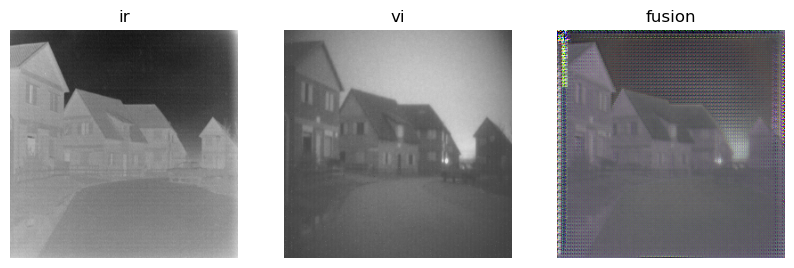

D_epoch_loss:0.005708952434360981,G_epoch_loss9.532816410064697
Epoch: 800 D_epoch_loss:0.009422327857464552,G_epoch_loss7.68860650062561
Epoch: 801 D_epoch_loss:0.010420725680887699,G_epoch_loss7.247800350189209
Epoch: 802 D_epoch_loss:0.006671452429145575,G_epoch_loss8.810174942016602
Epoch: 803 D_epoch_loss:0.005920000607147813,G_epoch_loss9.192842721939087
Epoch: 804 D_epoch_loss:0.0052295628702268004,G_epoch_loss9.761795043945312
Epoch: 805 D_epoch_loss:0.0072976353112608194,G_epoch_loss8.560929298400879
Epoch: 806 D_epoch_loss:0.010642958339303732,G_epoch_loss7.473883390426636
Epoch: 807 D_epoch_loss:0.006517903180792928,G_epoch_loss8.695504665374756
Epoch: 808 D_epoch_loss:0.00850066589191556,G_epoch_loss7.990163326263428
Epoch: 809 D_epoch_loss:0.0071286591701209545,G_epoch_loss7.549346208572388
Epoch: 810 D_epoch_loss:0.010488832369446754,G_epoch_loss7.181568145751953
Epoch: 811 D_epoch_loss:0.009585739811882377,G_epoch_loss9.023782014846802
Epoch: 812 D_epoch_loss:0.004001967

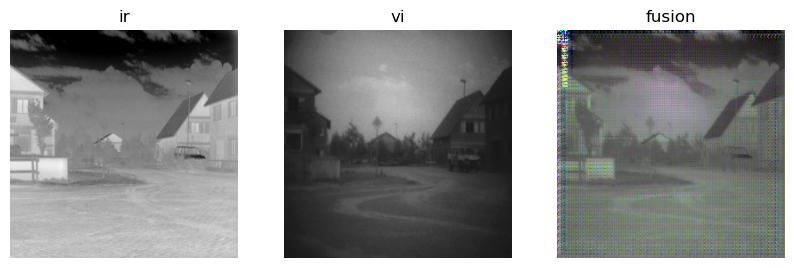

D_epoch_loss:0.0040779749397188425,G_epoch_loss9.088596820831299
Epoch: 847 D_epoch_loss:0.005866415798664093,G_epoch_loss8.61914873123169
Epoch: 848 D_epoch_loss:0.005245408974587917,G_epoch_loss8.960197448730469
Epoch: 849 D_epoch_loss:0.007637512870132923,G_epoch_loss7.7509846687316895
Epoch: 850 D_epoch_loss:0.00473340111784637,G_epoch_loss8.770586967468262
Epoch: 851 D_epoch_loss:0.008700642734766006,G_epoch_loss8.734964370727539
Epoch: 852 D_epoch_loss:0.005455478560179472,G_epoch_loss8.430177688598633
Epoch: 853 D_epoch_loss:0.005830975715070963,G_epoch_loss8.7246732711792
Epoch: 854 D_epoch_loss:0.007705756463110447,G_epoch_loss7.651448726654053
Epoch: 855 D_epoch_loss:0.005691343918442726,G_epoch_loss8.641621589660645
Epoch: 856 D_epoch_loss:0.004943575244396925,G_epoch_loss8.597607612609863
Epoch: 857 D_epoch_loss:0.0068260058760643005,G_epoch_loss7.854106903076172
Epoch: 858 D_epoch_loss:0.010695741046220064,G_epoch_loss7.585192441940308
Epoch: 859 D_epoch_loss:0.00419711438

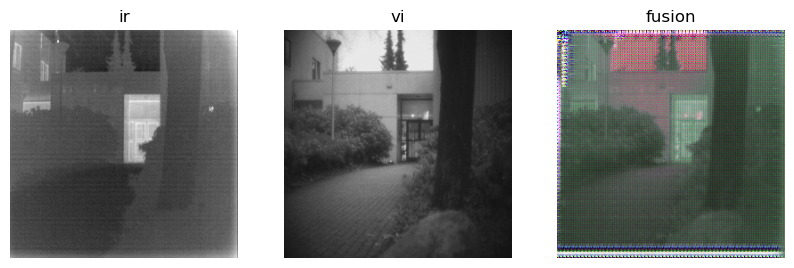

D_epoch_loss:0.005348883336409926,G_epoch_loss9.730047702789307
Epoch: 894 D_epoch_loss:0.004844766343012452,G_epoch_loss9.862033367156982
Epoch: 895 D_epoch_loss:0.005977391265332699,G_epoch_loss9.858807563781738
Epoch: 896 D_epoch_loss:0.006897743791341782,G_epoch_loss9.901699542999268
Epoch: 897 D_epoch_loss:0.00563237234018743,G_epoch_loss10.153607845306396
Epoch: 898 D_epoch_loss:0.004951757844537497,G_epoch_loss10.23456621170044
Epoch: 899 D_epoch_loss:0.00429426075424999,G_epoch_loss9.783609867095947
Epoch: 900 D_epoch_loss:0.004570143064484,G_epoch_loss9.896232604980469
Epoch: 901 D_epoch_loss:0.0066999108530581,G_epoch_loss10.05126667022705
Epoch: 902 D_epoch_loss:0.005274254363030195,G_epoch_loss9.798734188079834
Epoch: 903 D_epoch_loss:0.0055912022944539785,G_epoch_loss10.01309871673584
Epoch: 904 D_epoch_loss:0.005149047821760178,G_epoch_loss9.765310287475586
Epoch: 905 D_epoch_loss:0.005137178115546703,G_epoch_loss9.784789085388184
Epoch: 906 D_epoch_loss:0.009251797106117

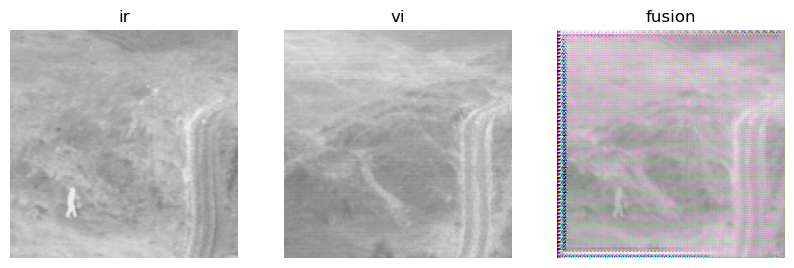

D_epoch_loss:0.005377731751650572,G_epoch_loss10.412353038787842
Epoch: 941 D_epoch_loss:0.0028474965365603566,G_epoch_loss10.099859237670898
Epoch: 942 D_epoch_loss:0.0037283211713656783,G_epoch_loss9.152854919433594
Epoch: 943 D_epoch_loss:0.004978090524673462,G_epoch_loss8.74422311782837
Epoch: 944 D_epoch_loss:0.0049966005608439445,G_epoch_loss8.075159788131714
Epoch: 945 D_epoch_loss:0.0076017859391868114,G_epoch_loss8.38611650466919
Epoch: 946 D_epoch_loss:0.003478805534541607,G_epoch_loss11.829209804534912
Epoch: 947 D_epoch_loss:0.002909053466282785,G_epoch_loss11.503961563110352
Epoch: 948 D_epoch_loss:0.002960411016829312,G_epoch_loss10.895139217376709
Epoch: 949 D_epoch_loss:0.003000853816047311,G_epoch_loss9.92471981048584
Epoch: 950 D_epoch_loss:0.005643934477120638,G_epoch_loss8.361375331878662
Epoch: 951 D_epoch_loss:0.006256258115172386,G_epoch_loss9.448536396026611
Epoch: 952 D_epoch_loss:0.00465799099765718,G_epoch_loss9.000554084777832
Epoch: 953 D_epoch_loss:0.00797

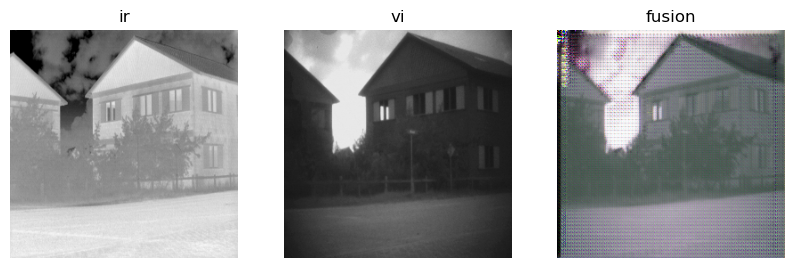

D_epoch_loss:0.0035448551643639803,G_epoch_loss10.033051490783691
Epoch: 988 D_epoch_loss:0.0031195353949442506,G_epoch_loss9.715822696685791
Epoch: 989 D_epoch_loss:0.0046697978395968676,G_epoch_loss9.042125701904297
Epoch: 990 D_epoch_loss:0.0054230899550020695,G_epoch_loss9.550309658050537
Epoch: 991 D_epoch_loss:0.0036976655246689916,G_epoch_loss8.608057022094727
Epoch: 992 D_epoch_loss:0.0055647664703428745,G_epoch_loss8.471714973449707
Epoch: 993 D_epoch_loss:0.007827810011804104,G_epoch_loss7.985446929931641
Epoch: 994 D_epoch_loss:0.002568981610238552,G_epoch_loss11.402072429656982
Epoch: 995 D_epoch_loss:0.004624282009899616,G_epoch_loss8.896260261535645
Epoch: 996 D_epoch_loss:0.007313125301152468,G_epoch_loss8.352343559265137
Epoch: 997 D_epoch_loss:0.009071213658899069,G_epoch_loss7.986717700958252
Epoch: 998 D_epoch_loss:0.008605713956058025,G_epoch_loss12.601658344268799
Epoch: 999 D_epoch_loss:0.00249007111415267,G_epoch_loss12.042699813842773
Epoch: 1000 D_epoch_loss:0.

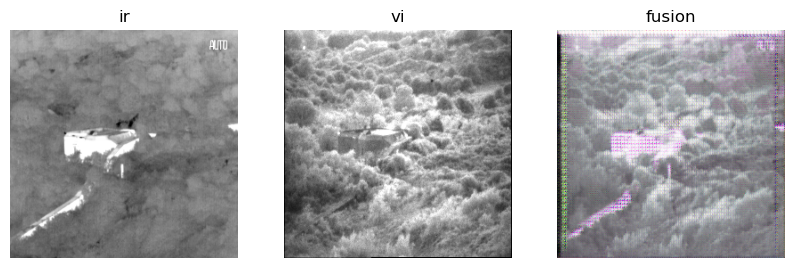

D_epoch_loss:0.0030619886238127947,G_epoch_loss9.818548202514648
Epoch: 1035 D_epoch_loss:0.0026051733875647187,G_epoch_loss9.530972003936768
Epoch: 1036 D_epoch_loss:0.0041913577588275075,G_epoch_loss8.998237609863281
Epoch: 1037 D_epoch_loss:0.004011291079223156,G_epoch_loss9.306756019592285
Epoch: 1038 D_epoch_loss:0.005589695414528251,G_epoch_loss8.257041931152344
Epoch: 1039 D_epoch_loss:0.00699634850025177,G_epoch_loss8.625344038009644
Epoch: 1040 D_epoch_loss:0.002927906229160726,G_epoch_loss11.397367477416992
Epoch: 1041 D_epoch_loss:0.002958824741654098,G_epoch_loss10.443026065826416
Epoch: 1042 D_epoch_loss:0.004243077244609594,G_epoch_loss9.193732261657715
Epoch: 1043 D_epoch_loss:0.0036493096267804503,G_epoch_loss9.935370922088623
Epoch: 1044 D_epoch_loss:0.003780544036999345,G_epoch_loss8.798850536346436
Epoch: 1045 D_epoch_loss:0.005456190323457122,G_epoch_loss8.812317848205566
Epoch: 1046 D_epoch_loss:0.00503803975880146,G_epoch_loss9.22141408920288
Epoch: 1047 D_epoch_l

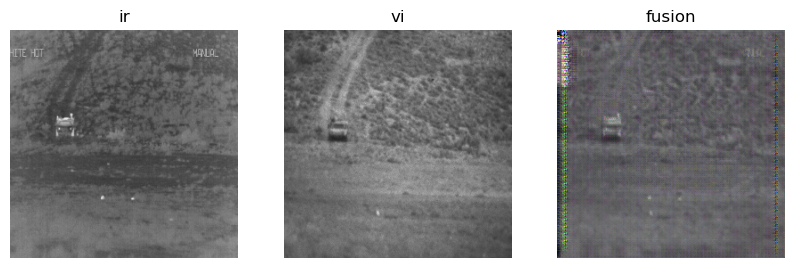

D_epoch_loss:0.003519346471875906,G_epoch_loss8.909762859344482
Epoch: 1082 D_epoch_loss:0.004656193777918816,G_epoch_loss9.080448627471924
Epoch: 1083 D_epoch_loss:0.002000666339881718,G_epoch_loss10.266233444213867
Epoch: 1084 D_epoch_loss:0.00277588953031227,G_epoch_loss9.133941173553467
Epoch: 1085 D_epoch_loss:0.003527113818563521,G_epoch_loss9.243293762207031
Epoch: 1086 D_epoch_loss:0.003869610372930765,G_epoch_loss8.541511535644531
Epoch: 1087 D_epoch_loss:0.0037942659109830856,G_epoch_loss8.748217582702637
Epoch: 1088 D_epoch_loss:0.004538376699201763,G_epoch_loss10.633539199829102
Epoch: 1089 D_epoch_loss:0.0024556442513130605,G_epoch_loss12.50774097442627
Epoch: 1090 D_epoch_loss:0.0015060202567838132,G_epoch_loss12.307142734527588
Epoch: 1091 D_epoch_loss:0.002608003676868975,G_epoch_loss12.526421070098877
Epoch: 1092 D_epoch_loss:0.001245458028279245,G_epoch_loss11.663413524627686
Epoch: 1093 D_epoch_loss:0.00172299868427217,G_epoch_loss11.52599811553955
Epoch: 1094 D_epoc

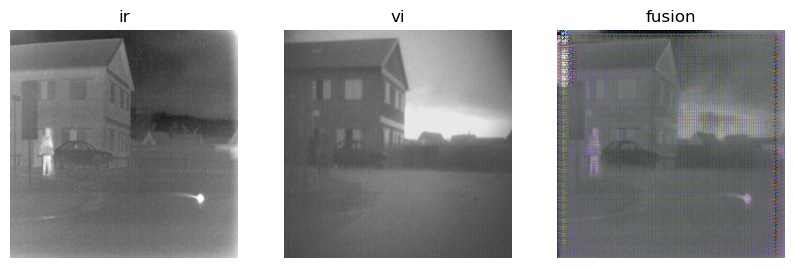

D_epoch_loss:0.002113060443662107,G_epoch_loss11.049083232879639
Epoch: 1129 D_epoch_loss:0.002190234838053584,G_epoch_loss9.307026386260986
Epoch: 1130 D_epoch_loss:0.0035229483619332314,G_epoch_loss9.331628799438477
Epoch: 1131 D_epoch_loss:0.0018238966586068273,G_epoch_loss9.969378471374512
Epoch: 1132 D_epoch_loss:0.0024146786890923977,G_epoch_loss9.646051406860352
Epoch: 1133 D_epoch_loss:0.00288423546589911,G_epoch_loss8.733031749725342
Epoch: 1134 D_epoch_loss:0.010516137816011906,G_epoch_loss8.114144802093506
Epoch: 1135 D_epoch_loss:0.002924883854575455,G_epoch_loss10.219606876373291
Epoch: 1136 D_epoch_loss:0.0037288714665919542,G_epoch_loss9.84078073501587
Epoch: 1137 D_epoch_loss:0.002073352923616767,G_epoch_loss10.623469829559326
Epoch: 1138 D_epoch_loss:0.002310465381015092,G_epoch_loss9.77105188369751
Epoch: 1139 D_epoch_loss:0.0024611272383481264,G_epoch_loss9.57364273071289
Epoch: 1140 D_epoch_loss:0.003671531565487385,G_epoch_loss8.696191310882568
Epoch: 1141 D_epoch_

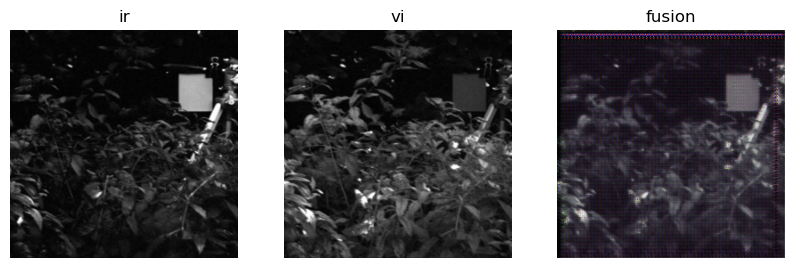

D_epoch_loss:0.0018147580558434129,G_epoch_loss10.595141410827637
Epoch: 1176 D_epoch_loss:0.00276257679797709,G_epoch_loss9.604652881622314
Epoch: 1177 D_epoch_loss:0.004683822626248002,G_epoch_loss8.630469799041748
Epoch: 1178 D_epoch_loss:0.004708355059847236,G_epoch_loss9.592488288879395
Epoch: 1179 D_epoch_loss:0.0015624549705535173,G_epoch_loss10.467346668243408
Epoch: 1180 D_epoch_loss:0.0022438897285610437,G_epoch_loss10.179037094116211
Epoch: 1181 D_epoch_loss:0.003244495135731995,G_epoch_loss9.02148962020874
Epoch: 1182 D_epoch_loss:0.004019875079393387,G_epoch_loss8.637940406799316
Epoch: 1183 D_epoch_loss:0.0041105898562818766,G_epoch_loss8.381873846054077
Epoch: 1184 D_epoch_loss:0.0032026462722569704,G_epoch_loss9.446377754211426
Epoch: 1185 D_epoch_loss:0.00364070717478171,G_epoch_loss10.208474159240723
Epoch: 1186 D_epoch_loss:0.0034014538396149874,G_epoch_loss9.518964767456055
Epoch: 1187 D_epoch_loss:0.004132568137720227,G_epoch_loss9.071569442749023
Epoch: 1188 D_epo

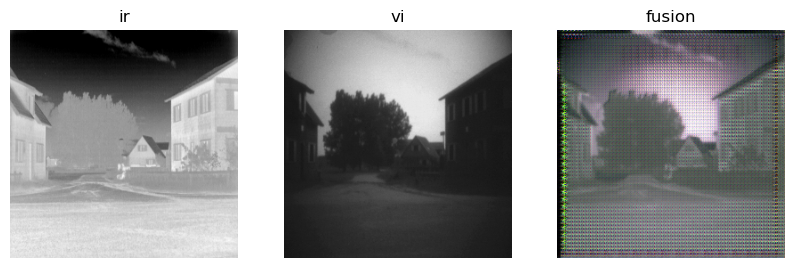

D_epoch_loss:0.002299151965416968,G_epoch_loss12.155506610870361
Epoch: 1223 D_epoch_loss:0.002371423412114382,G_epoch_loss11.282895565032959
Epoch: 1224 D_epoch_loss:0.002884526737034321,G_epoch_loss9.617095947265625
Epoch: 1225 D_epoch_loss:0.0034911573166027665,G_epoch_loss9.27247428894043
Epoch: 1226 D_epoch_loss:0.0022231414914131165,G_epoch_loss10.53400993347168
Epoch: 1227 D_epoch_loss:0.0025372763630002737,G_epoch_loss10.072180271148682
Epoch: 1228 D_epoch_loss:0.0036996043054386973,G_epoch_loss8.687637329101562
Epoch: 1229 D_epoch_loss:0.0036322339437901974,G_epoch_loss9.2346773147583
Epoch: 1230 D_epoch_loss:0.002573700970970094,G_epoch_loss11.597379207611084
Epoch: 1231 D_epoch_loss:0.0028769623022526503,G_epoch_loss10.87812614440918
Epoch: 1232 D_epoch_loss:0.002484734868630767,G_epoch_loss9.40401315689087
Epoch: 1233 D_epoch_loss:0.0028588006971403956,G_epoch_loss9.785782814025879
Epoch: 1234 D_epoch_loss:0.004288924857974052,G_epoch_loss10.182029247283936
Epoch: 1235 D_ep

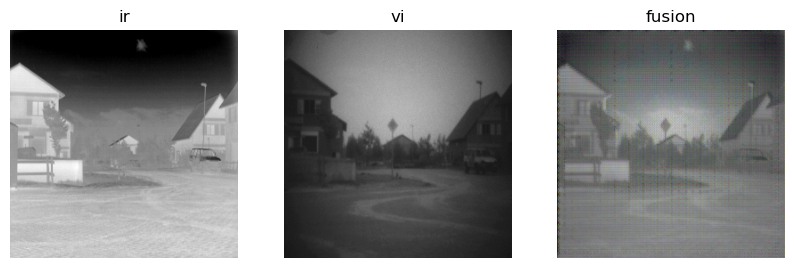

D_epoch_loss:1.9556376934051514,G_epoch_loss1.7530824542045593
Epoch: 1270 D_epoch_loss:1.630646824836731,G_epoch_loss2.091154098510742
Epoch: 1271 D_epoch_loss:1.275462567806244,G_epoch_loss2.6371378898620605
Epoch: 1272 D_epoch_loss:0.8128411769866943,G_epoch_loss3.357839584350586
Epoch: 1273 D_epoch_loss:1.3935689330101013,G_epoch_loss2.8220651149749756
Epoch: 1274 D_epoch_loss:1.0734001994132996,G_epoch_loss3.618135929107666
Epoch: 1275 D_epoch_loss:1.0396745800971985,G_epoch_loss3.0160157680511475
Epoch: 1276 D_epoch_loss:0.6544497013092041,G_epoch_loss3.0975959300994873
Epoch: 1277 D_epoch_loss:1.2218742072582245,G_epoch_loss2.9407246112823486
Epoch: 1278 D_epoch_loss:1.7736456990242004,G_epoch_loss2.8854410648345947
Epoch: 1279 D_epoch_loss:1.1766786575317383,G_epoch_loss2.372122645378113
Epoch: 1280 D_epoch_loss:1.9569529294967651,G_epoch_loss2.1210063695907593
Epoch: 1281 D_epoch_loss:0.969811350107193,G_epoch_loss2.76190185546875
Epoch: 1282 D_epoch_loss:0.5271139442920685,G_

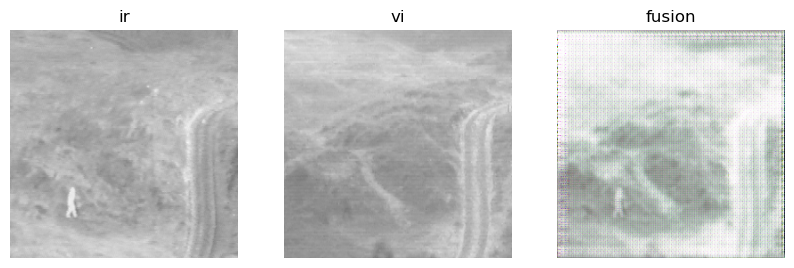

D_epoch_loss:0.08058483526110649,G_epoch_loss6.421878337860107
Epoch: 1317 D_epoch_loss:0.07299097254872322,G_epoch_loss5.757026672363281
Epoch: 1318 D_epoch_loss:0.13863947242498398,G_epoch_loss4.865803956985474
Epoch: 1319 D_epoch_loss:0.10900680348277092,G_epoch_loss5.1591949462890625
Epoch: 1320 D_epoch_loss:0.13856087625026703,G_epoch_loss4.628941297531128
Epoch: 1321 D_epoch_loss:0.06927789002656937,G_epoch_loss6.637450456619263
Epoch: 1322 D_epoch_loss:0.10561336576938629,G_epoch_loss5.37849235534668
Epoch: 1323 D_epoch_loss:0.08144282177090645,G_epoch_loss5.74746036529541
Epoch: 1324 D_epoch_loss:0.13930082321166992,G_epoch_loss5.204538583755493
Epoch: 1325 D_epoch_loss:0.07945119962096214,G_epoch_loss6.007874250411987
Epoch: 1326 D_epoch_loss:0.0635913796722889,G_epoch_loss6.084543228149414
Epoch: 1327 D_epoch_loss:0.0730675719678402,G_epoch_loss5.880603313446045
Epoch: 1328 D_epoch_loss:0.12875305861234665,G_epoch_loss5.5611913204193115
Epoch: 1329 D_epoch_loss:0.082390159368

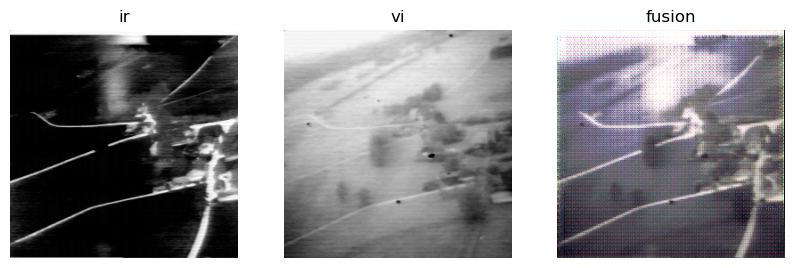

D_epoch_loss:0.04139619320631027,G_epoch_loss7.721104860305786
Epoch: 1364 D_epoch_loss:0.047917380928993225,G_epoch_loss7.062156677246094
Epoch: 1365 D_epoch_loss:0.03605363331735134,G_epoch_loss6.66470742225647
Epoch: 1366 D_epoch_loss:0.03952549025416374,G_epoch_loss6.412961959838867
Epoch: 1367 D_epoch_loss:0.0389450266957283,G_epoch_loss6.582199573516846
Epoch: 1368 D_epoch_loss:0.03216533362865448,G_epoch_loss6.432129383087158
Epoch: 1369 D_epoch_loss:0.03177492134273052,G_epoch_loss6.870410442352295
Epoch: 1370 D_epoch_loss:0.02928617224097252,G_epoch_loss6.925522327423096
Epoch: 1371 D_epoch_loss:0.04410160519182682,G_epoch_loss6.620494365692139
Epoch: 1372 D_epoch_loss:0.028968797996640205,G_epoch_loss6.292510032653809
Epoch: 1373 D_epoch_loss:0.041306598111987114,G_epoch_loss7.268250942230225
Epoch: 1374 D_epoch_loss:0.04400843754410744,G_epoch_loss7.085753679275513
Epoch: 1375 D_epoch_loss:0.04420386254787445,G_epoch_loss6.184954881668091
Epoch: 1376 D_epoch_loss:0.023209806

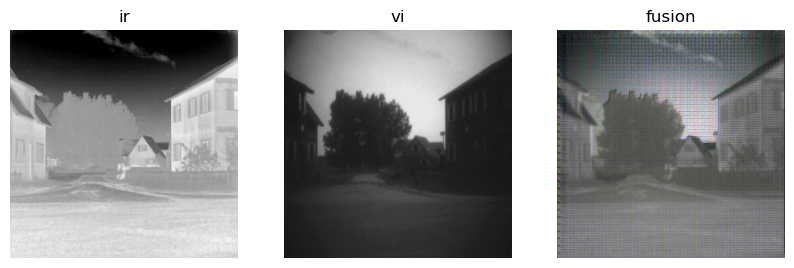

D_epoch_loss:0.7782326638698578,G_epoch_loss2.6895354986190796
Epoch: 1411 D_epoch_loss:1.617073893547058,G_epoch_loss2.8085484504699707
Epoch: 1412 D_epoch_loss:1.4862162470817566,G_epoch_loss2.0936168432235718
Epoch: 1413 D_epoch_loss:1.669285535812378,G_epoch_loss1.9699479341506958
Epoch: 1414 D_epoch_loss:1.3064459562301636,G_epoch_loss2.040912389755249
Epoch: 1415 D_epoch_loss:1.8077882528305054,G_epoch_loss1.865073323249817
Epoch: 1416 D_epoch_loss:1.5412397384643555,G_epoch_loss2.0329002737998962
Epoch: 1417 D_epoch_loss:1.6952404379844666,G_epoch_loss1.8526012897491455
Epoch: 1418 D_epoch_loss:1.5360881090164185,G_epoch_loss1.873593807220459
Epoch: 1419 D_epoch_loss:1.5126547813415527,G_epoch_loss1.8414320349693298
Epoch: 1420 D_epoch_loss:1.419615387916565,G_epoch_loss1.9946552515029907
Epoch: 1421 D_epoch_loss:1.3154854774475098,G_epoch_loss2.3139912486076355
Epoch: 1422 D_epoch_loss:2.496614456176758,G_epoch_loss1.6621437072753906
Epoch: 1423 D_epoch_loss:1.6428343653678894,

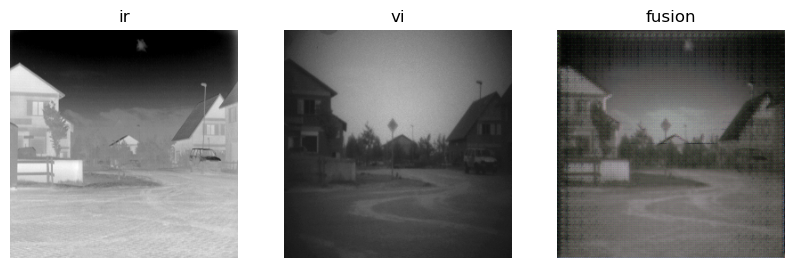

D_epoch_loss:1.4841341376304626,G_epoch_loss2.2429065704345703
Epoch: 1458 D_epoch_loss:1.561961829662323,G_epoch_loss2.2165080308914185
Epoch: 1459 D_epoch_loss:1.3713245391845703,G_epoch_loss1.5819705724716187
Epoch: 1460 D_epoch_loss:1.570771038532257,G_epoch_loss2.22884064912796
Epoch: 1461 D_epoch_loss:1.5481644868850708,G_epoch_loss1.928704023361206
Epoch: 1462 D_epoch_loss:1.352826714515686,G_epoch_loss1.7224644422531128
Epoch: 1463 D_epoch_loss:1.2699090242385864,G_epoch_loss1.9788134098052979
Epoch: 1464 D_epoch_loss:1.2623103857040405,G_epoch_loss1.968949019908905
Epoch: 1465 D_epoch_loss:1.2611875534057617,G_epoch_loss2.2145248651504517
Epoch: 1466 D_epoch_loss:1.3583409190177917,G_epoch_loss1.947350025177002
Epoch: 1467 D_epoch_loss:1.55983304977417,G_epoch_loss1.816042423248291
Epoch: 1468 D_epoch_loss:1.7272107005119324,G_epoch_loss2.1647019386291504
Epoch: 1469 D_epoch_loss:1.348681926727295,G_epoch_loss1.9597078561782837
Epoch: 1470 D_epoch_loss:1.7527796030044556,G_epo

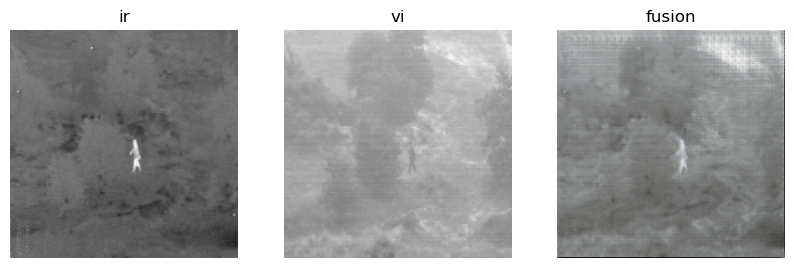

D_epoch_loss:1.4132122993469238,G_epoch_loss2.2057098746299744
Epoch: 1505 D_epoch_loss:1.347568929195404,G_epoch_loss2.0075836181640625
Epoch: 1506 D_epoch_loss:1.310153841972351,G_epoch_loss2.2980681657791138
Epoch: 1507 D_epoch_loss:1.4290686249732971,G_epoch_loss1.9353629350662231
Epoch: 1508 D_epoch_loss:1.179523766040802,G_epoch_loss1.9690707921981812
Epoch: 1509 D_epoch_loss:1.3047162294387817,G_epoch_loss1.910019338130951
Epoch: 1510 D_epoch_loss:1.370803415775299,G_epoch_loss2.5279147028923035
Epoch: 1511 D_epoch_loss:1.4324774742126465,G_epoch_loss1.6683842539787292
Epoch: 1512 D_epoch_loss:1.349827766418457,G_epoch_loss2.197689473628998
Epoch: 1513 D_epoch_loss:1.4613792300224304,G_epoch_loss1.9901204109191895
Epoch: 1514 D_epoch_loss:1.2388898134231567,G_epoch_loss2.015157699584961
Epoch: 1515 D_epoch_loss:1.333254635334015,G_epoch_loss1.9876448512077332
Epoch: 1516 D_epoch_loss:1.387707233428955,G_epoch_loss1.8005213141441345
Epoch: 1517 D_epoch_loss:1.4707876443862915,G_e

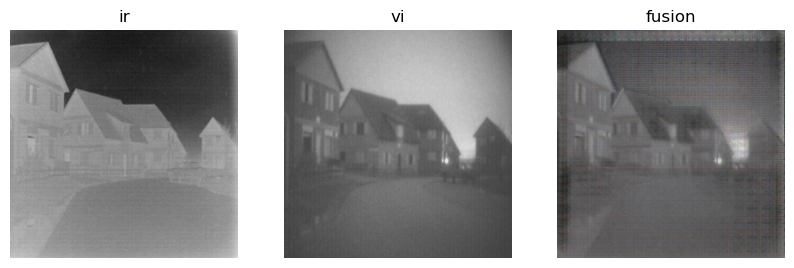

D_epoch_loss:1.5395187735557556,G_epoch_loss2.272548198699951
Epoch: 1552 D_epoch_loss:1.1478939652442932,G_epoch_loss2.1804510354995728
Epoch: 1553 D_epoch_loss:1.2326966524124146,G_epoch_loss1.98041570186615
Epoch: 1554 D_epoch_loss:1.1148169040679932,G_epoch_loss2.1887420415878296
Epoch: 1555 D_epoch_loss:1.1202349066734314,G_epoch_loss2.016395688056946
Epoch: 1556 D_epoch_loss:1.1533161997795105,G_epoch_loss2.112271308898926
Epoch: 1557 D_epoch_loss:1.2301100492477417,G_epoch_loss2.1349291801452637
Epoch: 1558 D_epoch_loss:1.3037612438201904,G_epoch_loss2.153597593307495
Epoch: 1559 D_epoch_loss:1.550162434577942,G_epoch_loss2.3986496925354004
Epoch: 1560 D_epoch_loss:1.734227180480957,G_epoch_loss2.4615180492401123
Epoch: 1561 D_epoch_loss:1.66916024684906,G_epoch_loss2.188992142677307
Epoch: 1562 D_epoch_loss:1.5994545221328735,G_epoch_loss1.9897786378860474
Epoch: 1563 D_epoch_loss:1.776310682296753,G_epoch_loss2.093249201774597
Epoch: 1564 D_epoch_loss:1.4169743657112122,G_epoc

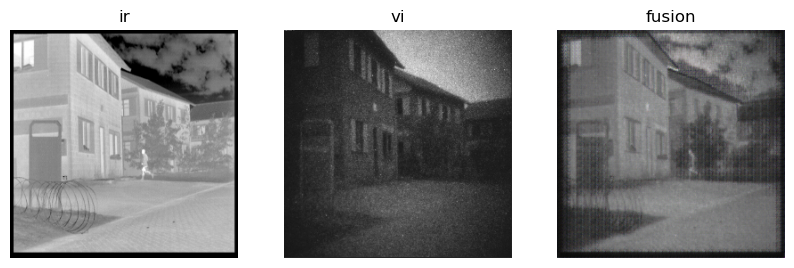

D_epoch_loss:1.1772575974464417,G_epoch_loss2.4104323387145996
Epoch: 1599 D_epoch_loss:1.63850736618042,G_epoch_loss1.934006690979004
Epoch: 1600 D_epoch_loss:1.5158475637435913,G_epoch_loss2.0138351917266846
Epoch: 1601 D_epoch_loss:1.224028468132019,G_epoch_loss2.0274727940559387
Epoch: 1602 D_epoch_loss:1.132334053516388,G_epoch_loss2.0405821800231934
Epoch: 1603 D_epoch_loss:1.4057504534721375,G_epoch_loss2.0432573556900024
Epoch: 1604 D_epoch_loss:1.2115758061408997,G_epoch_loss2.0156137347221375
Epoch: 1605 D_epoch_loss:1.35750412940979,G_epoch_loss2.4499452114105225
Epoch: 1606 D_epoch_loss:1.7087952494621277,G_epoch_loss1.7205380201339722
Epoch: 1607 D_epoch_loss:1.3136139512062073,G_epoch_loss2.1722973585128784
Epoch: 1608 D_epoch_loss:1.3813923597335815,G_epoch_loss1.8439380526542664
Epoch: 1609 D_epoch_loss:1.247199833393097,G_epoch_loss2.02168345451355
Epoch: 1610 D_epoch_loss:1.354601263999939,G_epoch_loss1.9009733200073242
Epoch: 1611 D_epoch_loss:1.148983359336853,G_epo

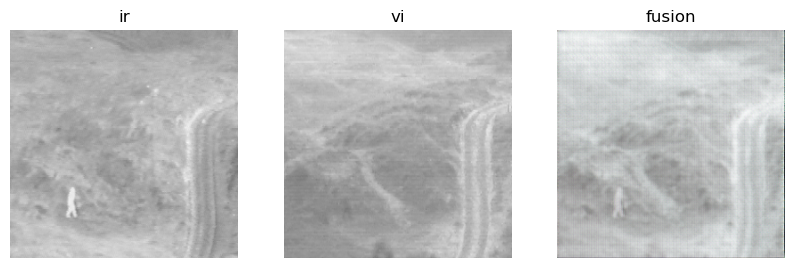

D_epoch_loss:1.5831860303878784,G_epoch_loss2.258057475090027
Epoch: 1646 D_epoch_loss:1.4035019874572754,G_epoch_loss1.8453679084777832
Epoch: 1647 D_epoch_loss:1.1828960180282593,G_epoch_loss2.049696922302246
Epoch: 1648 D_epoch_loss:1.5027871131896973,G_epoch_loss1.9317821860313416
Epoch: 1649 D_epoch_loss:1.4151384234428406,G_epoch_loss1.9258190989494324
Epoch: 1650 D_epoch_loss:1.3221662640571594,G_epoch_loss1.869910717010498
Epoch: 1651 D_epoch_loss:1.2063226103782654,G_epoch_loss1.9986794590950012
Epoch: 1652 D_epoch_loss:1.2622250318527222,G_epoch_loss1.9299675226211548
Epoch: 1653 D_epoch_loss:1.3167665600776672,G_epoch_loss2.158424496650696
Epoch: 1654 D_epoch_loss:1.3479669690132141,G_epoch_loss1.8192524909973145
Epoch: 1655 D_epoch_loss:1.35090970993042,G_epoch_loss2.0075223445892334
Epoch: 1656 D_epoch_loss:1.3258814215660095,G_epoch_loss1.8531721234321594
Epoch: 1657 D_epoch_loss:1.4477339386940002,G_epoch_loss1.9940006136894226
Epoch: 1658 D_epoch_loss:1.4934408068656921

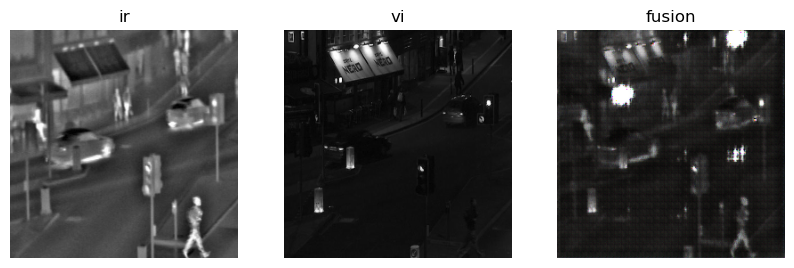

D_epoch_loss:1.1165447235107422,G_epoch_loss2.114652156829834
Epoch: 1693 D_epoch_loss:1.2744402289390564,G_epoch_loss2.0116416811943054
Epoch: 1694 D_epoch_loss:1.3010236024856567,G_epoch_loss2.301564931869507
Epoch: 1695 D_epoch_loss:1.3884121775627136,G_epoch_loss1.9842947721481323
Epoch: 1696 D_epoch_loss:1.2332152128219604,G_epoch_loss2.008702516555786
Epoch: 1697 D_epoch_loss:1.4521889686584473,G_epoch_loss2.145349860191345
Epoch: 1698 D_epoch_loss:1.3750751614570618,G_epoch_loss2.1928176879882812
Epoch: 1699 D_epoch_loss:1.4425550699234009,G_epoch_loss2.1298071146011353
Epoch: 1700 D_epoch_loss:1.1850003004074097,G_epoch_loss2.1324389576911926
Epoch: 1701 D_epoch_loss:1.2374150156974792,G_epoch_loss2.1736152172088623
Epoch: 1702 D_epoch_loss:1.297163486480713,G_epoch_loss1.961677074432373
Epoch: 1703 D_epoch_loss:1.391767978668213,G_epoch_loss2.2129368782043457
Epoch: 1704 D_epoch_loss:1.260355532169342,G_epoch_loss2.381438732147217
Epoch: 1705 D_epoch_loss:1.1947559118270874,G_

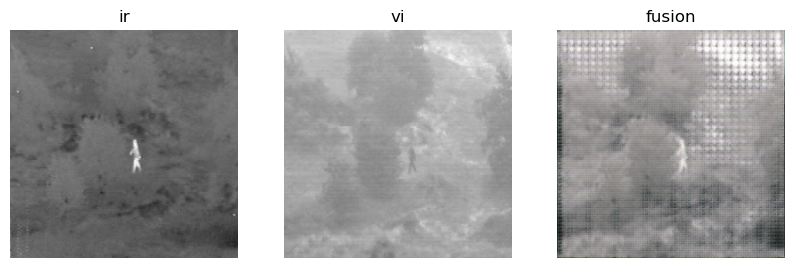

D_epoch_loss:1.4609864056110382,G_epoch_loss2.9926021099090576
Epoch: 1740 D_epoch_loss:0.596235990524292,G_epoch_loss3.240607976913452
Epoch: 1741 D_epoch_loss:0.4608721137046814,G_epoch_loss3.360244631767273
Epoch: 1742 D_epoch_loss:0.5417643487453461,G_epoch_loss3.4676547050476074
Epoch: 1743 D_epoch_loss:1.0101088881492615,G_epoch_loss4.139576435089111
Epoch: 1744 D_epoch_loss:1.1146310865879059,G_epoch_loss3.5984671115875244
Epoch: 1745 D_epoch_loss:0.4130164086818695,G_epoch_loss3.790303349494934
Epoch: 1746 D_epoch_loss:0.5481533110141754,G_epoch_loss4.638932704925537
Epoch: 1747 D_epoch_loss:0.3945477306842804,G_epoch_loss4.8553478717803955
Epoch: 1748 D_epoch_loss:0.2731783762574196,G_epoch_loss4.144532799720764
Epoch: 1749 D_epoch_loss:0.31317274272441864,G_epoch_loss4.044607758522034
Epoch: 1750 D_epoch_loss:0.12493927776813507,G_epoch_loss5.26448655128479
Epoch: 1751 D_epoch_loss:0.2371576428413391,G_epoch_loss4.106433629989624
Epoch: 1752 D_epoch_loss:0.2385592982172966,G_

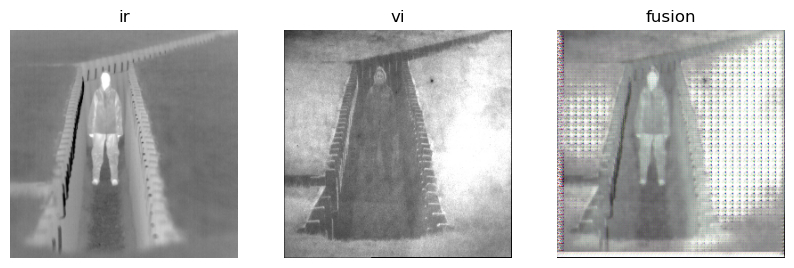

D_epoch_loss:0.057255810126662254,G_epoch_loss5.50974440574646
Epoch: 1787 D_epoch_loss:0.08825143799185753,G_epoch_loss5.333488464355469
Epoch: 1788 D_epoch_loss:0.06381312757730484,G_epoch_loss5.712901592254639
Epoch: 1789 D_epoch_loss:0.10017755627632141,G_epoch_loss5.734459161758423
Epoch: 1790 D_epoch_loss:0.08170009031891823,G_epoch_loss5.158270835876465
Epoch: 1791 D_epoch_loss:0.07018420100212097,G_epoch_loss5.33871603012085
Epoch: 1792 D_epoch_loss:0.07109808921813965,G_epoch_loss5.403403043746948
Epoch: 1793 D_epoch_loss:0.06420382484793663,G_epoch_loss5.570669174194336
Epoch: 1794 D_epoch_loss:0.0518094040453434,G_epoch_loss5.8352484703063965
Epoch: 1795 D_epoch_loss:0.04882935993373394,G_epoch_loss6.124396562576294
Epoch: 1796 D_epoch_loss:0.0655081681907177,G_epoch_loss5.027863264083862
Epoch: 1797 D_epoch_loss:0.04400962218642235,G_epoch_loss5.855098485946655
Epoch: 1798 D_epoch_loss:0.043910497799515724,G_epoch_loss5.602327585220337
Epoch: 1799 D_epoch_loss:0.05065016448

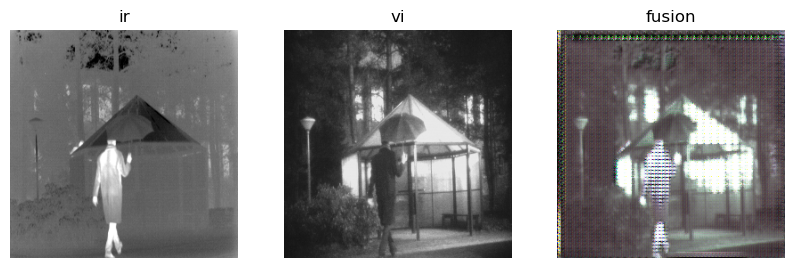

D_epoch_loss:0.03958854451775551,G_epoch_loss6.675260066986084
Epoch: 1834 D_epoch_loss:0.05520924739539623,G_epoch_loss6.133887052536011
Epoch: 1835 D_epoch_loss:0.038346339017152786,G_epoch_loss6.661769866943359
Epoch: 1836 D_epoch_loss:0.03385002911090851,G_epoch_loss6.615918397903442
Epoch: 1837 D_epoch_loss:0.031841134652495384,G_epoch_loss9.326802730560303
Epoch: 1838 D_epoch_loss:0.028456028550863266,G_epoch_loss8.68922758102417
Epoch: 1839 D_epoch_loss:0.02585824392735958,G_epoch_loss7.655671119689941
Epoch: 1840 D_epoch_loss:0.024807928130030632,G_epoch_loss6.681771278381348
Epoch: 1841 D_epoch_loss:0.02908277977257967,G_epoch_loss6.47912073135376
Epoch: 1842 D_epoch_loss:0.024411503225564957,G_epoch_loss6.147616386413574
Epoch: 1843 D_epoch_loss:0.062269967049360275,G_epoch_loss5.4590935707092285
Epoch: 1844 D_epoch_loss:0.03030468989163637,G_epoch_loss8.860936641693115
Epoch: 1845 D_epoch_loss:0.0314492704346776,G_epoch_loss7.742672443389893
Epoch: 1846 D_epoch_loss:0.031465

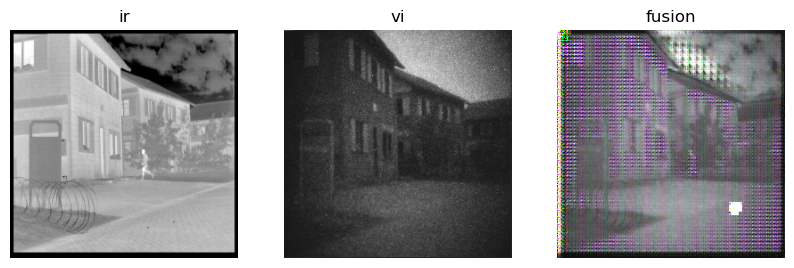

D_epoch_loss:0.026902681216597557,G_epoch_loss6.6360390186309814
Epoch: 1881 D_epoch_loss:0.0314258374273777,G_epoch_loss6.263246297836304
Epoch: 1882 D_epoch_loss:0.02313948981463909,G_epoch_loss7.174861907958984
Epoch: 1883 D_epoch_loss:0.025104299187660217,G_epoch_loss7.259477376937866
Epoch: 1884 D_epoch_loss:0.035137539729475975,G_epoch_loss6.17759895324707
Epoch: 1885 D_epoch_loss:0.04339331388473511,G_epoch_loss6.16153883934021
Epoch: 1886 D_epoch_loss:0.027233337983489037,G_epoch_loss6.264869689941406
Epoch: 1887 D_epoch_loss:0.025156596675515175,G_epoch_loss6.939252138137817
Epoch: 1888 D_epoch_loss:0.03422986716032028,G_epoch_loss6.915945529937744
Epoch: 1889 D_epoch_loss:0.031162088736891747,G_epoch_loss6.394495487213135
Epoch: 1890 D_epoch_loss:0.03349125757813454,G_epoch_loss5.957846164703369
Epoch: 1891 D_epoch_loss:0.03611440397799015,G_epoch_loss6.135416030883789
Epoch: 1892 D_epoch_loss:0.013152812607586384,G_epoch_loss8.88029146194458
Epoch: 1893 D_epoch_loss:0.023176

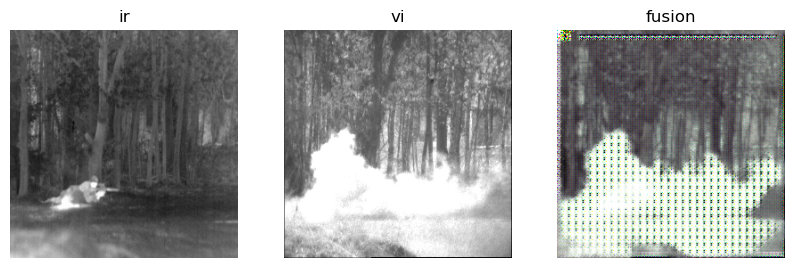

D_epoch_loss:0.015787788201123476,G_epoch_loss6.750216484069824
Epoch: 1928 D_epoch_loss:0.01533585973083973,G_epoch_loss7.446533441543579
Epoch: 1929 D_epoch_loss:0.016493353992700577,G_epoch_loss7.039736986160278
Epoch: 1930 D_epoch_loss:0.015613794792443514,G_epoch_loss7.473119258880615
Epoch: 1931 D_epoch_loss:0.01624200539663434,G_epoch_loss7.399547100067139
Epoch: 1932 D_epoch_loss:0.025234373286366463,G_epoch_loss7.378175258636475
Epoch: 1933 D_epoch_loss:0.020817961543798447,G_epoch_loss6.736475706100464
Epoch: 1934 D_epoch_loss:0.01603214954957366,G_epoch_loss7.277925968170166
Epoch: 1935 D_epoch_loss:0.017694639042019844,G_epoch_loss7.025526523590088
Epoch: 1936 D_epoch_loss:0.016520739533007145,G_epoch_loss7.099708080291748
Epoch: 1937 D_epoch_loss:0.01665274053812027,G_epoch_loss6.932188272476196
Epoch: 1938 D_epoch_loss:0.0146168009378016,G_epoch_loss7.178697109222412
Epoch: 1939 D_epoch_loss:0.016081873793154955,G_epoch_loss7.14092493057251
Epoch: 1940 D_epoch_loss:0.0221

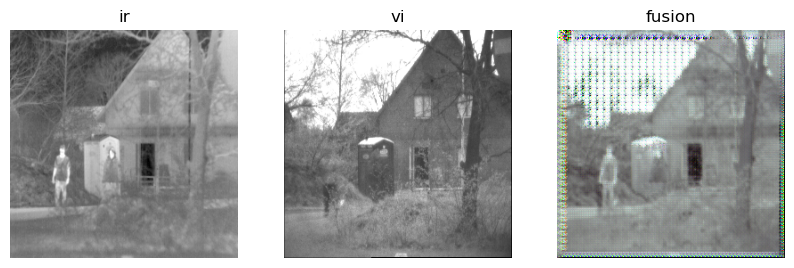

D_epoch_loss:0.02365410141646862,G_epoch_loss6.769577741622925
Epoch: 1975 D_epoch_loss:0.01776964869350195,G_epoch_loss7.759712219238281
Epoch: 1976 D_epoch_loss:0.015921161510050297,G_epoch_loss8.101813793182373
Epoch: 1977 D_epoch_loss:0.016854965593665838,G_epoch_loss7.642541885375977
Epoch: 1978 D_epoch_loss:0.01541580818593502,G_epoch_loss7.11763596534729
Epoch: 1979 D_epoch_loss:0.013441132847219706,G_epoch_loss7.086747407913208
Epoch: 1980 D_epoch_loss:0.016190693713724613,G_epoch_loss6.983269214630127
Epoch: 1981 D_epoch_loss:0.01846426259726286,G_epoch_loss7.272266626358032
Epoch: 1982 D_epoch_loss:0.010927037801593542,G_epoch_loss7.095409393310547
Epoch: 1983 D_epoch_loss:0.01506054773926735,G_epoch_loss7.318553447723389
Epoch: 1984 D_epoch_loss:0.011550697032362223,G_epoch_loss7.234078407287598
Epoch: 1985 D_epoch_loss:0.01382353762164712,G_epoch_loss7.1025919914245605
Epoch: 1986 D_epoch_loss:0.013030799105763435,G_epoch_loss7.4599409103393555
Epoch: 1987 D_epoch_loss:0.01

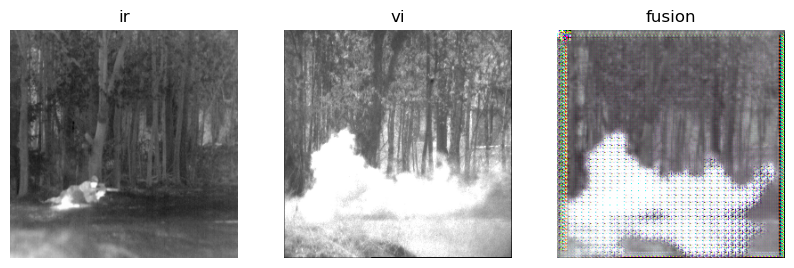

D_epoch_loss:0.015783846843987703,G_epoch_loss8.776847839355469
Epoch: 2022 D_epoch_loss:0.013000620063394308,G_epoch_loss7.503079175949097
Epoch: 2023 D_epoch_loss:0.016958470456302166,G_epoch_loss8.351317644119263
Epoch: 2024 D_epoch_loss:0.01959360670298338,G_epoch_loss7.563181161880493
Epoch: 2025 D_epoch_loss:0.009452634025365114,G_epoch_loss8.921907424926758
Epoch: 2026 D_epoch_loss:0.00993006955832243,G_epoch_loss8.29720687866211
Epoch: 2027 D_epoch_loss:0.008266985416412354,G_epoch_loss8.935509204864502
Epoch: 2028 D_epoch_loss:0.010445103980600834,G_epoch_loss9.118852138519287
Epoch: 2029 D_epoch_loss:0.011516525875777006,G_epoch_loss7.982659339904785
Epoch: 2030 D_epoch_loss:0.011347806546837091,G_epoch_loss8.145707130432129
Epoch: 2031 D_epoch_loss:0.013660293072462082,G_epoch_loss7.812783718109131
Epoch: 2032 D_epoch_loss:0.01598770869895816,G_epoch_loss8.050823211669922
Epoch: 2033 D_epoch_loss:0.008922614622861147,G_epoch_loss8.613333463668823
Epoch: 2034 D_epoch_loss:0.0

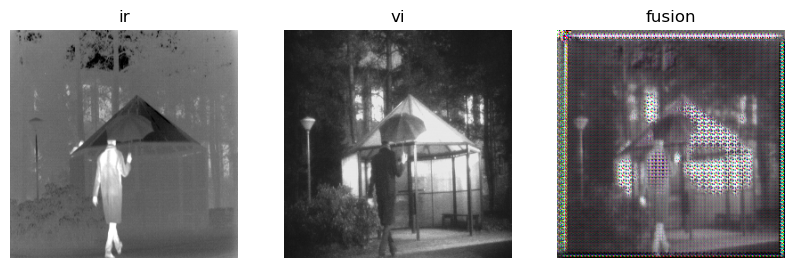

D_epoch_loss:0.011112700449302793,G_epoch_loss9.009597301483154
Epoch: 2069 D_epoch_loss:0.009665069170296192,G_epoch_loss9.500996112823486
Epoch: 2070 D_epoch_loss:0.009991241618990898,G_epoch_loss8.942867279052734
Epoch: 2071 D_epoch_loss:0.007048573810607195,G_epoch_loss9.05670690536499
Epoch: 2072 D_epoch_loss:0.0174097940325737,G_epoch_loss8.046146631240845
Epoch: 2073 D_epoch_loss:0.02729129884392023,G_epoch_loss6.9175615310668945
Epoch: 2074 D_epoch_loss:0.013095114380121231,G_epoch_loss8.6958589553833
Epoch: 2075 D_epoch_loss:0.013669461943209171,G_epoch_loss8.226807594299316
Epoch: 2076 D_epoch_loss:0.018546124920248985,G_epoch_loss7.863311767578125
Epoch: 2077 D_epoch_loss:0.02001443225890398,G_epoch_loss7.455048084259033
Epoch: 2078 D_epoch_loss:0.027793756686151028,G_epoch_loss7.837457895278931
Epoch: 2079 D_epoch_loss:0.015904847532510757,G_epoch_loss8.162353038787842
Epoch: 2080 D_epoch_loss:0.023053990676999092,G_epoch_loss8.527073383331299
Epoch: 2081 D_epoch_loss:0.014

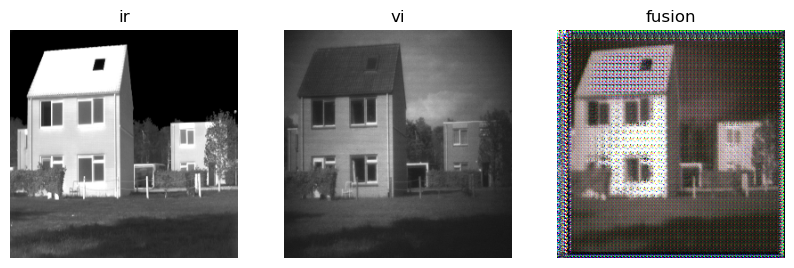

D_epoch_loss:0.009869338944554329,G_epoch_loss9.542328357696533
Epoch: 2116 D_epoch_loss:0.007328649517148733,G_epoch_loss9.187135219573975
Epoch: 2117 D_epoch_loss:0.008672233670949936,G_epoch_loss9.453172206878662
Epoch: 2118 D_epoch_loss:0.007868318352848291,G_epoch_loss9.914963245391846
Epoch: 2119 D_epoch_loss:0.01153186708688736,G_epoch_loss9.674056053161621
Epoch: 2120 D_epoch_loss:0.007605836261063814,G_epoch_loss10.090784072875977
Epoch: 2121 D_epoch_loss:0.006296592764556408,G_epoch_loss9.958985805511475
Epoch: 2122 D_epoch_loss:0.007726567331701517,G_epoch_loss9.892298698425293
Epoch: 2123 D_epoch_loss:0.009995225351303816,G_epoch_loss10.178084373474121
Epoch: 2124 D_epoch_loss:0.008305210620164871,G_epoch_loss10.001933097839355
Epoch: 2125 D_epoch_loss:0.011437770444899797,G_epoch_loss10.0599684715271
Epoch: 2126 D_epoch_loss:0.010897357016801834,G_epoch_loss9.977017879486084
Epoch: 2127 D_epoch_loss:0.013072180096060038,G_epoch_loss9.836793899536133
Epoch: 2128 D_epoch_los

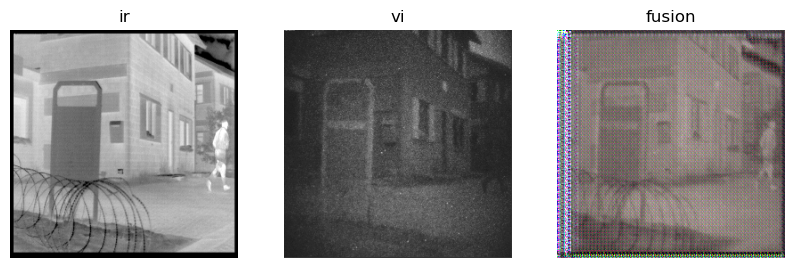

D_epoch_loss:0.00988099630922079,G_epoch_loss10.371634483337402
Epoch: 2163 D_epoch_loss:0.00950170448049903,G_epoch_loss10.920834064483643
Epoch: 2164 D_epoch_loss:0.008247506339102983,G_epoch_loss10.724344253540039
Epoch: 2165 D_epoch_loss:0.009112534113228321,G_epoch_loss10.83195686340332
Epoch: 2166 D_epoch_loss:0.017337101511657238,G_epoch_loss10.879878044128418
Epoch: 2167 D_epoch_loss:0.009480716660618782,G_epoch_loss10.743992805480957
Epoch: 2168 D_epoch_loss:0.008821846917271614,G_epoch_loss10.926281452178955
Epoch: 2169 D_epoch_loss:0.007135725114494562,G_epoch_loss10.625850677490234
Epoch: 2170 D_epoch_loss:0.01082549337297678,G_epoch_loss10.716808319091797
Epoch: 2171 D_epoch_loss:0.010844960808753967,G_epoch_loss11.03934383392334
Epoch: 2172 D_epoch_loss:0.006780220195651054,G_epoch_loss11.001171588897705
Epoch: 2173 D_epoch_loss:0.007237955695018172,G_epoch_loss11.727872848510742
Epoch: 2174 D_epoch_loss:0.007074656197801232,G_epoch_loss11.068951606750488
Epoch: 2175 D_ep

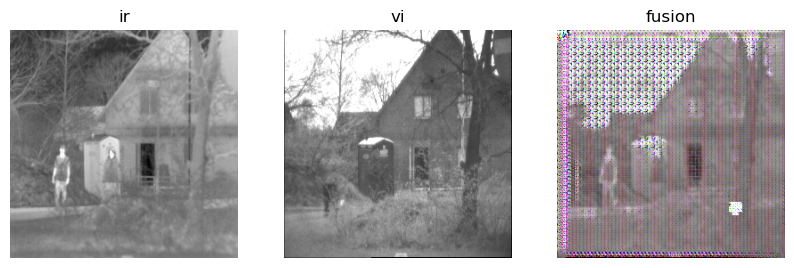

D_epoch_loss:0.006140610435977578,G_epoch_loss11.130040168762207
Epoch: 2210 D_epoch_loss:0.007358292117714882,G_epoch_loss10.97096586227417
Epoch: 2211 D_epoch_loss:0.007418586872518063,G_epoch_loss10.91381549835205
Epoch: 2212 D_epoch_loss:0.011228424496948719,G_epoch_loss10.81178092956543
Epoch: 2213 D_epoch_loss:0.008797791786491871,G_epoch_loss10.549928188323975
Epoch: 2214 D_epoch_loss:0.01038450002670288,G_epoch_loss10.552075386047363
Epoch: 2215 D_epoch_loss:0.007922388380393386,G_epoch_loss10.333682537078857
Epoch: 2216 D_epoch_loss:0.01539329206570983,G_epoch_loss10.498737335205078
Epoch: 2217 D_epoch_loss:0.009277467150241137,G_epoch_loss10.868914604187012
Epoch: 2218 D_epoch_loss:0.005539122503250837,G_epoch_loss11.208657264709473
Epoch: 2219 D_epoch_loss:0.008381841937080026,G_epoch_loss10.960536003112793
Epoch: 2220 D_epoch_loss:0.009339452721178532,G_epoch_loss10.437830448150635
Epoch: 2221 D_epoch_loss:0.006657285848632455,G_epoch_loss10.76417064666748
Epoch: 2222 D_epo

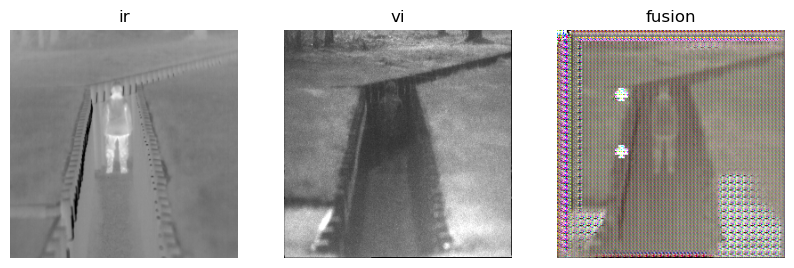

D_epoch_loss:0.00649021053686738,G_epoch_loss11.670868873596191
Epoch: 2257 D_epoch_loss:0.12787536159157753,G_epoch_loss12.010010719299316
Epoch: 2258 D_epoch_loss:3.076613128185272,G_epoch_loss9.119028091430664
Epoch: 2259 D_epoch_loss:0.8206645548343658,G_epoch_loss11.353114128112793
Epoch: 2260 D_epoch_loss:0.3880828619003296,G_epoch_loss8.808422088623047
Epoch: 2261 D_epoch_loss:0.22650350630283356,G_epoch_loss9.925726413726807
Epoch: 2262 D_epoch_loss:0.1250409223139286,G_epoch_loss8.914890766143799
Epoch: 2263 D_epoch_loss:0.13603006303310394,G_epoch_loss8.706176280975342
Epoch: 2264 D_epoch_loss:0.16026785969734192,G_epoch_loss7.3516459465026855
Epoch: 2265 D_epoch_loss:0.20189057290554047,G_epoch_loss6.574699401855469
Epoch: 2266 D_epoch_loss:0.20059197396039963,G_epoch_loss5.676711797714233
Epoch: 2267 D_epoch_loss:0.24784480780363083,G_epoch_loss5.9562578201293945
Epoch: 2268 D_epoch_loss:0.18934257328510284,G_epoch_loss4.890488624572754
Epoch: 2269 D_epoch_loss:0.0650764908

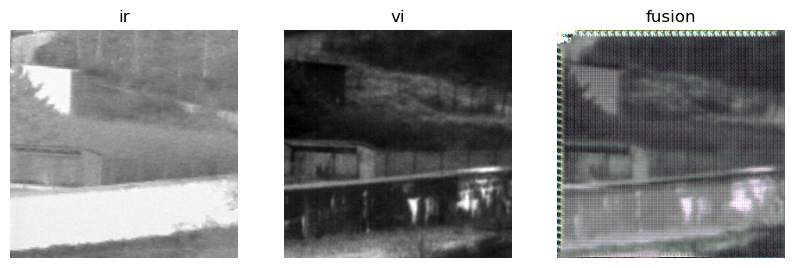

D_epoch_loss:0.03254805505275726,G_epoch_loss6.7252984046936035
Epoch: 2304 D_epoch_loss:0.03752761706709862,G_epoch_loss6.690506458282471
Epoch: 2305 D_epoch_loss:0.05327706225216389,G_epoch_loss7.5264928340911865
Epoch: 2306 D_epoch_loss:0.02800882328301668,G_epoch_loss8.05036997795105
Epoch: 2307 D_epoch_loss:0.0331115061417222,G_epoch_loss8.609408855438232
Epoch: 2308 D_epoch_loss:0.0723985992372036,G_epoch_loss6.482312917709351
Epoch: 2309 D_epoch_loss:0.13162240386009216,G_epoch_loss5.603187918663025
Epoch: 2310 D_epoch_loss:2.921488404273987,G_epoch_loss5.990780353546143
Epoch: 2311 D_epoch_loss:3.3282700777053833,G_epoch_loss4.062334060668945
Epoch: 2312 D_epoch_loss:2.914359211921692,G_epoch_loss4.013032674789429
Epoch: 2313 D_epoch_loss:2.11783105134964,G_epoch_loss3.999158263206482
Epoch: 2314 D_epoch_loss:4.59786319732666,G_epoch_loss3.2266765832901
Epoch: 2315 D_epoch_loss:5.001681923866272,G_epoch_loss2.122729182243347
Epoch: 2316 D_epoch_loss:2.074167490005493,G_epoch_lo

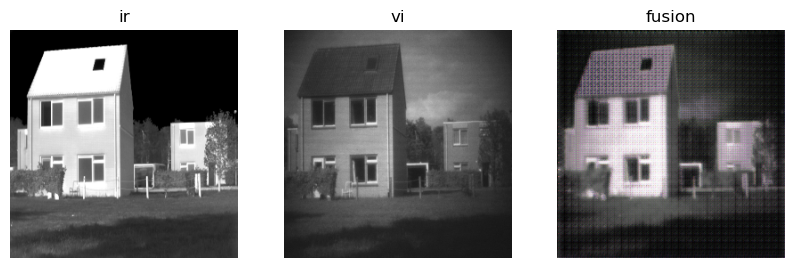

D_epoch_loss:0.30063992738723755,G_epoch_loss4.68540620803833
Epoch: 2351 D_epoch_loss:0.6916845440864563,G_epoch_loss6.753388404846191
Epoch: 2352 D_epoch_loss:1.0617107450962067,G_epoch_loss6.031878709793091
Epoch: 2353 D_epoch_loss:0.9446753263473511,G_epoch_loss4.203963279724121
Epoch: 2354 D_epoch_loss:0.5308521762490273,G_epoch_loss6.039663553237915
Epoch: 2355 D_epoch_loss:0.1787734031677246,G_epoch_loss5.90321683883667
Epoch: 2356 D_epoch_loss:0.2634287178516388,G_epoch_loss5.9862048625946045
Epoch: 2357 D_epoch_loss:0.3822873532772064,G_epoch_loss5.191371440887451
Epoch: 2358 D_epoch_loss:0.11501879617571831,G_epoch_loss6.920281171798706
Epoch: 2359 D_epoch_loss:0.3874828666448593,G_epoch_loss6.717613697052002
Epoch: 2360 D_epoch_loss:1.4312743544578552,G_epoch_loss5.20001757144928
Epoch: 2361 D_epoch_loss:1.287484049797058,G_epoch_loss4.201959252357483
Epoch: 2362 D_epoch_loss:1.6059823632240295,G_epoch_loss4.2354347705841064
Epoch: 2363 D_epoch_loss:0.7296888530254364,G_epoc

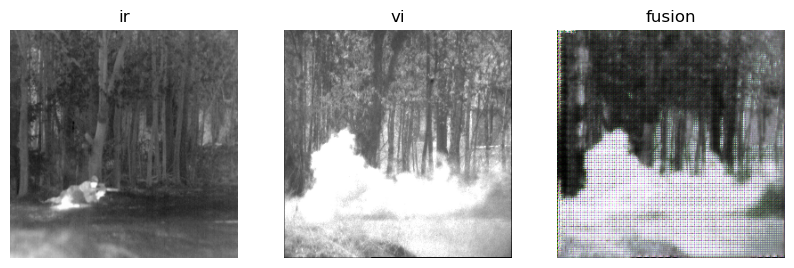

D_epoch_loss:0.12746896594762802,G_epoch_loss6.019695520401001
Epoch: 2398 D_epoch_loss:0.05461421236395836,G_epoch_loss5.876868009567261
Epoch: 2399 D_epoch_loss:0.08055473864078522,G_epoch_loss5.260186672210693
Epoch: 2400 D_epoch_loss:0.08541657030582428,G_epoch_loss5.390031337738037
Epoch: 2401 D_epoch_loss:0.07394220679998398,G_epoch_loss6.053605318069458
Epoch: 2402 D_epoch_loss:0.0647907443344593,G_epoch_loss5.346440553665161
Epoch: 2403 D_epoch_loss:0.10919739305973053,G_epoch_loss5.111180782318115
Epoch: 2404 D_epoch_loss:0.07411347329616547,G_epoch_loss5.552161931991577
Epoch: 2405 D_epoch_loss:0.06791941821575165,G_epoch_loss5.802460670471191
Epoch: 2406 D_epoch_loss:0.0767274759709835,G_epoch_loss5.752810955047607
Epoch: 2407 D_epoch_loss:0.036069586873054504,G_epoch_loss7.435337066650391
Epoch: 2408 D_epoch_loss:0.04793858900666237,G_epoch_loss6.552940845489502
Epoch: 2409 D_epoch_loss:0.07947022840380669,G_epoch_loss5.648885726928711
Epoch: 2410 D_epoch_loss:0.08556511998

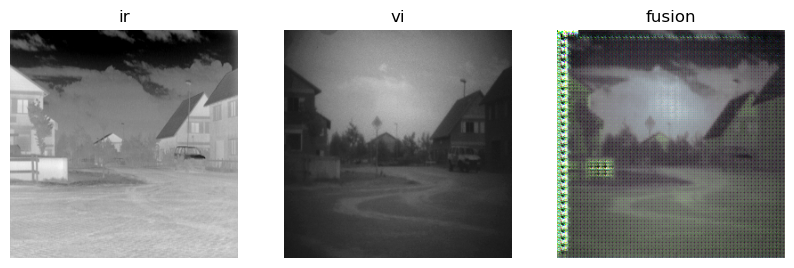

D_epoch_loss:0.023372658528387547,G_epoch_loss6.7523887157440186
Epoch: 2445 D_epoch_loss:0.018481598235666752,G_epoch_loss6.458374500274658
Epoch: 2446 D_epoch_loss:0.027844777330756187,G_epoch_loss6.597366094589233
Epoch: 2447 D_epoch_loss:0.014366613235324621,G_epoch_loss7.3568947315216064
Epoch: 2448 D_epoch_loss:0.02133751753717661,G_epoch_loss6.408400297164917
Epoch: 2449 D_epoch_loss:0.033798884600400925,G_epoch_loss6.194729566574097
Epoch: 2450 D_epoch_loss:0.021888283547013998,G_epoch_loss6.82979154586792
Epoch: 2451 D_epoch_loss:0.014915398322045803,G_epoch_loss7.2709996700286865
Epoch: 2452 D_epoch_loss:0.029711933806538582,G_epoch_loss6.043047189712524
Epoch: 2453 D_epoch_loss:0.04271624889224768,G_epoch_loss6.15010404586792
Epoch: 2454 D_epoch_loss:0.016649744473397732,G_epoch_loss9.062489986419678
Epoch: 2455 D_epoch_loss:0.015725976321846247,G_epoch_loss6.637218236923218
Epoch: 2456 D_epoch_loss:0.012166386470198631,G_epoch_loss8.234119892120361
Epoch: 2457 D_epoch_loss:

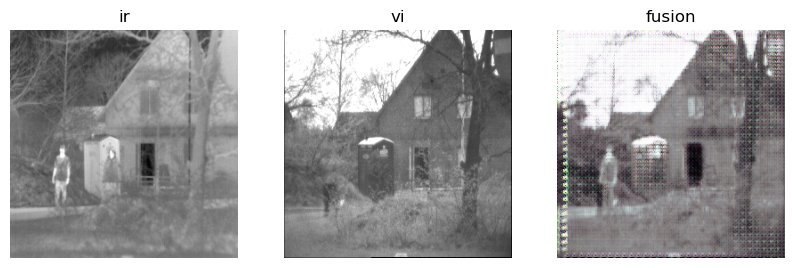

D_epoch_loss:0.061100393533706665,G_epoch_loss7.70930290222168
Epoch: 2492 D_epoch_loss:0.2861612141132355,G_epoch_loss4.779393911361694
Epoch: 2493 D_epoch_loss:2.4706172943115234,G_epoch_loss5.319257497787476
Epoch: 2494 D_epoch_loss:1.6634542047977448,G_epoch_loss4.563957929611206
Epoch: 2495 D_epoch_loss:1.1891418099403381,G_epoch_loss2.820599317550659
Epoch: 2496 D_epoch_loss:1.1689448356628418,G_epoch_loss4.524720668792725
Epoch: 2497 D_epoch_loss:0.676786333322525,G_epoch_loss3.4920082092285156
Epoch: 2498 D_epoch_loss:0.31840527057647705,G_epoch_loss4.422838091850281
Epoch: 2499 D_epoch_loss:0.5772380977869034,G_epoch_loss3.5447118282318115
Epoch: 2500 D_epoch_loss:0.5510859787464142,G_epoch_loss6.480410099029541
Epoch: 2501 D_epoch_loss:0.4491986110806465,G_epoch_loss5.848545074462891
Epoch: 2502 D_epoch_loss:1.8649510741233826,G_epoch_loss3.7151503562927246
Epoch: 2503 D_epoch_loss:1.3827248811721802,G_epoch_loss3.405844569206238
Epoch: 2504 D_epoch_loss:1.030131995677948,G_e

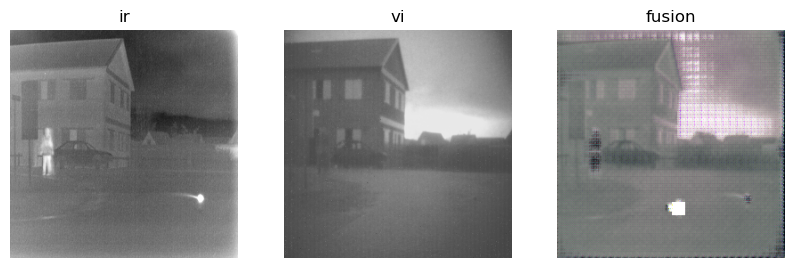

D_epoch_loss:0.29330624639987946,G_epoch_loss5.210538148880005
Epoch: 2539 D_epoch_loss:0.3669012486934662,G_epoch_loss6.013070583343506
Epoch: 2540 D_epoch_loss:0.22666745632886887,G_epoch_loss5.9644575119018555
Epoch: 2541 D_epoch_loss:0.2329251617193222,G_epoch_loss5.216757297515869
Epoch: 2542 D_epoch_loss:0.3846253678202629,G_epoch_loss5.909146070480347
Epoch: 2543 D_epoch_loss:0.2861238867044449,G_epoch_loss6.9584290981292725
Epoch: 2544 D_epoch_loss:0.8807272724807262,G_epoch_loss7.713003873825073
Epoch: 2545 D_epoch_loss:3.8622050285339355,G_epoch_loss3.045561671257019
Epoch: 2546 D_epoch_loss:2.180002808570862,G_epoch_loss3.4862128496170044
Epoch: 2547 D_epoch_loss:2.080145239830017,G_epoch_loss3.416121006011963
Epoch: 2548 D_epoch_loss:1.3909374475479126,G_epoch_loss3.0868592262268066
Epoch: 2549 D_epoch_loss:0.8324646651744843,G_epoch_loss4.368382573127747
Epoch: 2550 D_epoch_loss:0.2704497426748276,G_epoch_loss5.280412197113037
Epoch: 2551 D_epoch_loss:0.24475403875112534,G

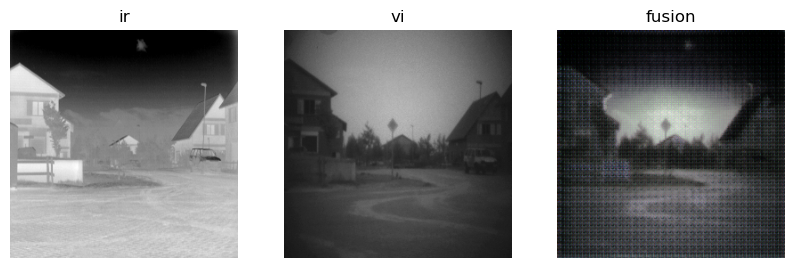

D_epoch_loss:1.4390594065189362,G_epoch_loss5.65399169921875
Epoch: 2586 D_epoch_loss:0.9749560952186584,G_epoch_loss4.571218013763428
Epoch: 2587 D_epoch_loss:0.2088528424501419,G_epoch_loss5.209052562713623
Epoch: 2588 D_epoch_loss:0.38220684230327606,G_epoch_loss5.272266626358032
Epoch: 2589 D_epoch_loss:1.8983036279678345,G_epoch_loss3.9965059757232666
Epoch: 2590 D_epoch_loss:0.8413909673690796,G_epoch_loss4.549473166465759
Epoch: 2591 D_epoch_loss:0.34685561060905457,G_epoch_loss5.026240587234497
Epoch: 2592 D_epoch_loss:0.2195727452635765,G_epoch_loss5.964869022369385
Epoch: 2593 D_epoch_loss:0.12615811079740524,G_epoch_loss9.100220680236816
Epoch: 2594 D_epoch_loss:0.0674840621650219,G_epoch_loss7.55778169631958
Epoch: 2595 D_epoch_loss:0.1362069584429264,G_epoch_loss5.104604482650757
Epoch: 2596 D_epoch_loss:0.31692712008953094,G_epoch_loss5.621537685394287
Epoch: 2597 D_epoch_loss:0.31268729269504547,G_epoch_loss4.286332607269287
Epoch: 2598 D_epoch_loss:0.9738355875015259,G_

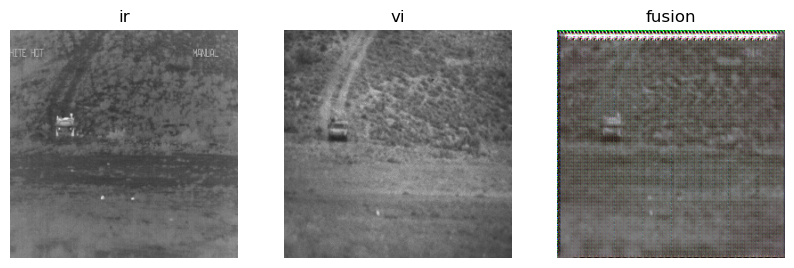

D_epoch_loss:0.035311928018927574,G_epoch_loss6.524519205093384
Epoch: 2633 D_epoch_loss:0.05713571980595589,G_epoch_loss5.270846605300903
Epoch: 2634 D_epoch_loss:0.03905508667230606,G_epoch_loss6.126277923583984
Epoch: 2635 D_epoch_loss:0.024485787376761436,G_epoch_loss7.013176918029785
Epoch: 2636 D_epoch_loss:0.03203034121543169,G_epoch_loss7.138623952865601
Epoch: 2637 D_epoch_loss:0.0386690478771925,G_epoch_loss5.979726791381836
Epoch: 2638 D_epoch_loss:0.03589580953121185,G_epoch_loss6.023952484130859
Epoch: 2639 D_epoch_loss:0.019399275071918964,G_epoch_loss7.628940582275391
Epoch: 2640 D_epoch_loss:0.035360345616936684,G_epoch_loss7.351065635681152
Epoch: 2641 D_epoch_loss:0.025261521339416504,G_epoch_loss6.574388742446899
Epoch: 2642 D_epoch_loss:0.020479357801377773,G_epoch_loss7.849955797195435
Epoch: 2643 D_epoch_loss:0.012364510912448168,G_epoch_loss8.985361576080322
Epoch: 2644 D_epoch_loss:0.03520689718425274,G_epoch_loss5.97690224647522
Epoch: 2645 D_epoch_loss:0.06121

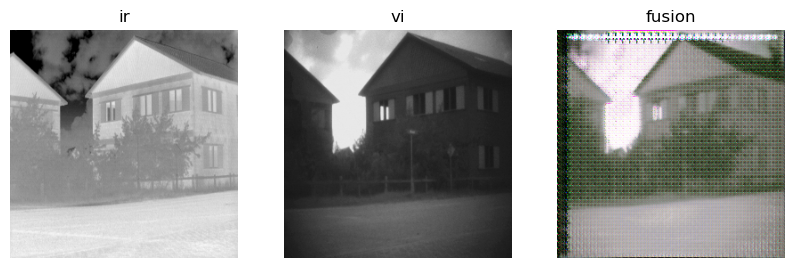

D_epoch_loss:0.17983409948647022,G_epoch_loss7.321207761764526
Epoch: 2680 D_epoch_loss:0.15849579498171806,G_epoch_loss5.319866180419922
Epoch: 2681 D_epoch_loss:0.1768633797764778,G_epoch_loss5.128156423568726
Epoch: 2682 D_epoch_loss:0.13807309418916702,G_epoch_loss5.673133373260498
Epoch: 2683 D_epoch_loss:0.05604663863778114,G_epoch_loss5.892881155014038
Epoch: 2684 D_epoch_loss:0.028187827207148075,G_epoch_loss7.371982097625732
Epoch: 2685 D_epoch_loss:0.021160124335438013,G_epoch_loss7.4213056564331055
Epoch: 2686 D_epoch_loss:0.01777886925265193,G_epoch_loss7.883807182312012
Epoch: 2687 D_epoch_loss:0.028051793575286865,G_epoch_loss6.875464200973511
Epoch: 2688 D_epoch_loss:0.03998661786317825,G_epoch_loss6.692228317260742
Epoch: 2689 D_epoch_loss:0.043293047696352005,G_epoch_loss6.006790399551392
Epoch: 2690 D_epoch_loss:0.02726363856345415,G_epoch_loss7.121857166290283
Epoch: 2691 D_epoch_loss:0.032556934747844934,G_epoch_loss7.576880693435669
Epoch: 2692 D_epoch_loss:0.02105

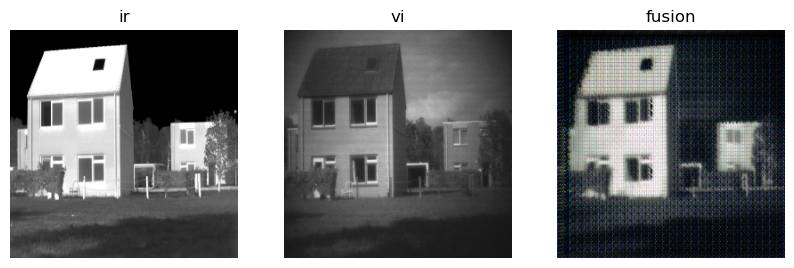

D_epoch_loss:0.0358931515365839,G_epoch_loss6.3291120529174805
Epoch: 2727 D_epoch_loss:0.03972404543310404,G_epoch_loss6.438817501068115
Epoch: 2728 D_epoch_loss:0.06332613714039326,G_epoch_loss7.886178970336914
Epoch: 2729 D_epoch_loss:0.03355679754167795,G_epoch_loss7.2267701625823975
Epoch: 2730 D_epoch_loss:0.014603211544454098,G_epoch_loss7.715490818023682
Epoch: 2731 D_epoch_loss:0.014227529056370258,G_epoch_loss9.10691785812378
Epoch: 2732 D_epoch_loss:0.007427309174090624,G_epoch_loss9.858193397521973
Epoch: 2733 D_epoch_loss:0.010710985399782658,G_epoch_loss8.245124340057373
Epoch: 2734 D_epoch_loss:0.007627426413819194,G_epoch_loss9.327337265014648
Epoch: 2735 D_epoch_loss:0.008498826529830694,G_epoch_loss10.527821063995361
Epoch: 2736 D_epoch_loss:0.007542931009083986,G_epoch_loss8.542540311813354
Epoch: 2737 D_epoch_loss:0.0225613284856081,G_epoch_loss7.424516916275024
Epoch: 2738 D_epoch_loss:0.017437379341572523,G_epoch_loss7.766447067260742
Epoch: 2739 D_epoch_loss:0.02

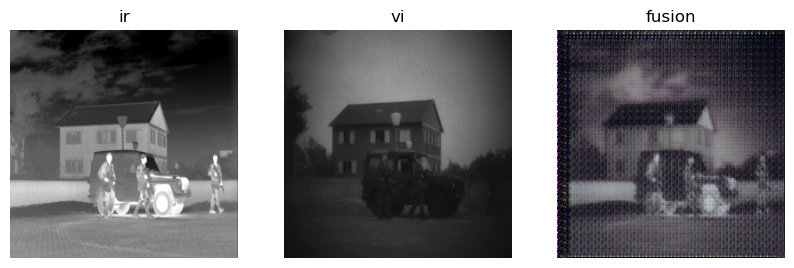

D_epoch_loss:0.004948777845129371,G_epoch_loss10.971624851226807
Epoch: 2774 D_epoch_loss:0.006197526818141341,G_epoch_loss9.757906913757324
Epoch: 2775 D_epoch_loss:0.006294833496212959,G_epoch_loss9.425424575805664
Epoch: 2776 D_epoch_loss:0.008642383385449648,G_epoch_loss8.83128023147583
Epoch: 2777 D_epoch_loss:0.03375277202576399,G_epoch_loss13.511016368865967
Epoch: 2778 D_epoch_loss:0.004990714369341731,G_epoch_loss11.88796329498291
Epoch: 2779 D_epoch_loss:0.006026414223015308,G_epoch_loss11.751389503479004
Epoch: 2780 D_epoch_loss:0.005589240929111838,G_epoch_loss10.335740089416504
Epoch: 2781 D_epoch_loss:0.008016550447791815,G_epoch_loss9.784186840057373
Epoch: 2782 D_epoch_loss:0.014656378654763103,G_epoch_loss8.818478107452393
Epoch: 2783 D_epoch_loss:0.030579838901758194,G_epoch_loss8.250442504882812
Epoch: 2784 D_epoch_loss:0.0075012315064668655,G_epoch_loss9.711310863494873
Epoch: 2785 D_epoch_loss:0.018861614167690277,G_epoch_loss7.907804012298584
Epoch: 2786 D_epoch_l

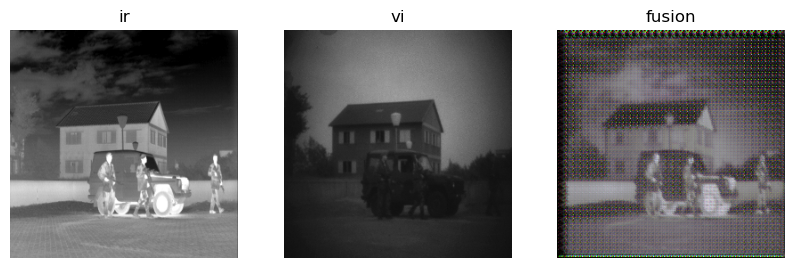

D_epoch_loss:0.030493433121591806,G_epoch_loss8.233986616134644
Epoch: 2821 D_epoch_loss:0.010825715027749538,G_epoch_loss7.548638582229614
Epoch: 2822 D_epoch_loss:0.012041478417813778,G_epoch_loss7.888406991958618
Epoch: 2823 D_epoch_loss:0.00959725771099329,G_epoch_loss8.125580787658691
Epoch: 2824 D_epoch_loss:0.005856462754309177,G_epoch_loss8.6372709274292
Epoch: 2825 D_epoch_loss:0.005205329740419984,G_epoch_loss9.425434589385986
Epoch: 2826 D_epoch_loss:0.003352527040988207,G_epoch_loss9.231322765350342
Epoch: 2827 D_epoch_loss:0.0042359489016234875,G_epoch_loss8.89125108718872
Epoch: 2828 D_epoch_loss:0.004745508544147015,G_epoch_loss8.699318408966064
Epoch: 2829 D_epoch_loss:0.005021626595407724,G_epoch_loss9.095979690551758
Epoch: 2830 D_epoch_loss:0.003310872009024024,G_epoch_loss9.947050094604492
Epoch: 2831 D_epoch_loss:0.00512472097761929,G_epoch_loss9.597700595855713
Epoch: 2832 D_epoch_loss:0.007232892094179988,G_epoch_loss8.942320346832275
Epoch: 2833 D_epoch_loss:0.0

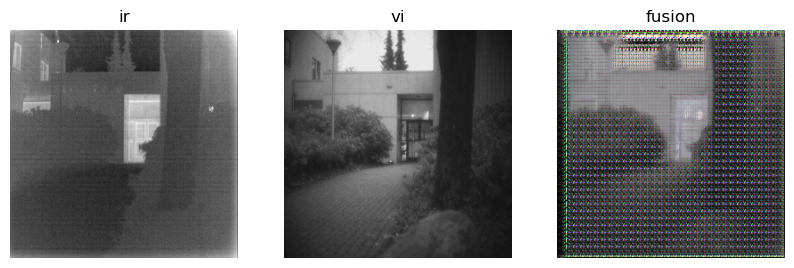

D_epoch_loss:0.0060296389274299145,G_epoch_loss8.892200946807861
Epoch: 2868 D_epoch_loss:0.008440724341198802,G_epoch_loss9.061657428741455
Epoch: 2869 D_epoch_loss:0.004630573559552431,G_epoch_loss9.74360990524292
Epoch: 2870 D_epoch_loss:0.006341384723782539,G_epoch_loss9.222578048706055
Epoch: 2871 D_epoch_loss:0.0035835717571899295,G_epoch_loss9.664347648620605
Epoch: 2872 D_epoch_loss:0.004610869800671935,G_epoch_loss9.540913581848145
Epoch: 2873 D_epoch_loss:0.004662194987758994,G_epoch_loss9.350849151611328
Epoch: 2874 D_epoch_loss:0.007234648102894425,G_epoch_loss8.596399307250977
Epoch: 2875 D_epoch_loss:0.0031517682364210486,G_epoch_loss10.199604034423828
Epoch: 2876 D_epoch_loss:0.003901822492480278,G_epoch_loss9.400572776794434
Epoch: 2877 D_epoch_loss:0.004227379569783807,G_epoch_loss8.927165985107422
Epoch: 2878 D_epoch_loss:0.004408416687510908,G_epoch_loss9.964804649353027
Epoch: 2879 D_epoch_loss:0.005940607283264399,G_epoch_loss9.498328685760498
Epoch: 2880 D_epoch_l

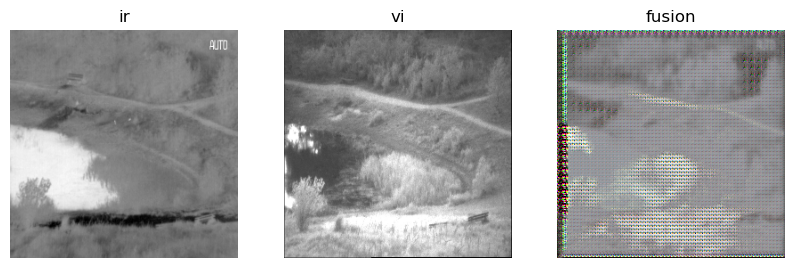

D_epoch_loss:0.004300381755456328,G_epoch_loss10.891477584838867
Epoch: 2915 D_epoch_loss:0.0029314426938071847,G_epoch_loss10.180779933929443
Epoch: 2916 D_epoch_loss:0.004288653843104839,G_epoch_loss9.678682327270508
Epoch: 2917 D_epoch_loss:0.005046258680522442,G_epoch_loss9.299843788146973
Epoch: 2918 D_epoch_loss:0.003570893662981689,G_epoch_loss10.521974563598633
Epoch: 2919 D_epoch_loss:0.0030790005112066865,G_epoch_loss10.131977081298828
Epoch: 2920 D_epoch_loss:0.003246392938308418,G_epoch_loss9.487462043762207
Epoch: 2921 D_epoch_loss:0.0029165121959522367,G_epoch_loss9.861629486083984
Epoch: 2922 D_epoch_loss:0.004397651879116893,G_epoch_loss9.689326286315918
Epoch: 2923 D_epoch_loss:0.0027018735418096185,G_epoch_loss9.975976943969727
Epoch: 2924 D_epoch_loss:0.003086169483140111,G_epoch_loss9.761289119720459
Epoch: 2925 D_epoch_loss:0.004553421633318067,G_epoch_loss9.128193855285645
Epoch: 2926 D_epoch_loss:0.003480050479993224,G_epoch_loss9.82358694076538
Epoch: 2927 D_epo

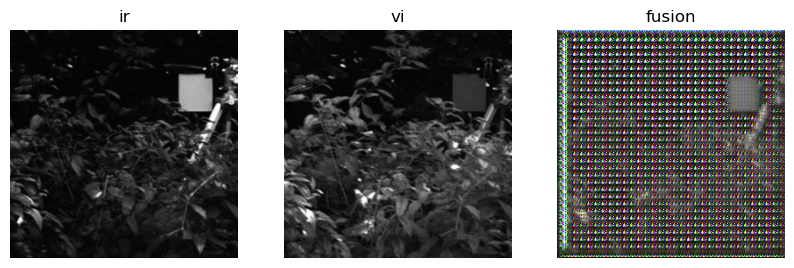

D_epoch_loss:0.006005366216413677,G_epoch_loss10.061969757080078
Epoch: 2962 D_epoch_loss:0.002469236380420625,G_epoch_loss10.823653221130371
Epoch: 2963 D_epoch_loss:0.0039683799259364605,G_epoch_loss9.726551532745361
Epoch: 2964 D_epoch_loss:0.0032803798094391823,G_epoch_loss10.741989135742188
Epoch: 2965 D_epoch_loss:0.002683785744011402,G_epoch_loss10.61653184890747
Epoch: 2966 D_epoch_loss:0.004073455347679555,G_epoch_loss10.313218116760254
Epoch: 2967 D_epoch_loss:0.003153559868223965,G_epoch_loss11.33207893371582
Epoch: 2968 D_epoch_loss:0.0036872487980872393,G_epoch_loss10.541882038116455
Epoch: 2969 D_epoch_loss:0.004299406427890062,G_epoch_loss10.662749290466309
Epoch: 2970 D_epoch_loss:0.0037097084568813443,G_epoch_loss10.12087345123291
Epoch: 2971 D_epoch_loss:0.005596291273832321,G_epoch_loss10.219715595245361
Epoch: 2972 D_epoch_loss:0.0034372344380244613,G_epoch_loss10.857831478118896
Epoch: 2973 D_epoch_loss:0.0028649502201005816,G_epoch_loss10.940267562866211
Epoch: 29

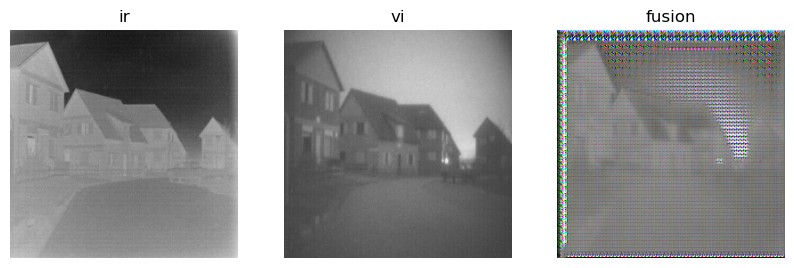

D_epoch_loss:0.006297909654676914,G_epoch_loss9.96953821182251
Epoch: 3009 D_epoch_loss:0.004243460716679692,G_epoch_loss11.63412618637085
Epoch: 3010 D_epoch_loss:0.00789843243546784,G_epoch_loss11.656262874603271
Epoch: 3011 D_epoch_loss:0.007429123390465975,G_epoch_loss10.63147258758545
Epoch: 3012 D_epoch_loss:0.010511379223316908,G_epoch_loss9.59377145767212
Epoch: 3013 D_epoch_loss:0.012530629988759756,G_epoch_loss9.796234130859375
Epoch: 3014 D_epoch_loss:0.0055098580196499825,G_epoch_loss10.108598709106445
Epoch: 3015 D_epoch_loss:0.0032073056790977716,G_epoch_loss11.085185050964355
Epoch: 3016 D_epoch_loss:0.004146335180848837,G_epoch_loss10.359925270080566
Epoch: 3017 D_epoch_loss:0.006077971076592803,G_epoch_loss9.600415229797363
Epoch: 3018 D_epoch_loss:0.003115023544523865,G_epoch_loss11.699249744415283
Epoch: 3019 D_epoch_loss:0.0045470057521015406,G_epoch_loss10.248239994049072
Epoch: 3020 D_epoch_loss:0.008327323943376541,G_epoch_loss9.267242431640625
Epoch: 3021 D_epoc

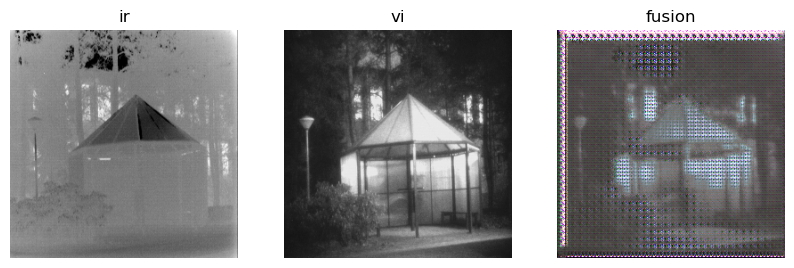

D_epoch_loss:0.007232967298477888,G_epoch_loss10.605148315429688
Epoch: 3056 D_epoch_loss:0.004427987150847912,G_epoch_loss10.775678634643555
Epoch: 3057 D_epoch_loss:0.008114200551062822,G_epoch_loss10.669993877410889
Epoch: 3058 D_epoch_loss:0.007843156345188618,G_epoch_loss10.823284149169922
Epoch: 3059 D_epoch_loss:0.009526164038106799,G_epoch_loss11.066722393035889
Epoch: 3060 D_epoch_loss:0.004663992905989289,G_epoch_loss12.124159336090088
Epoch: 3061 D_epoch_loss:0.006633187178522348,G_epoch_loss12.102089881896973
Epoch: 3062 D_epoch_loss:0.009425163269042969,G_epoch_loss11.129470348358154
Epoch: 3063 D_epoch_loss:0.01104285242035985,G_epoch_loss11.769725322723389
Epoch: 3064 D_epoch_loss:0.006966617424041033,G_epoch_loss11.667558670043945
Epoch: 3065 D_epoch_loss:0.0051324141677469015,G_epoch_loss12.338565826416016
Epoch: 3066 D_epoch_loss:0.004776644753292203,G_epoch_loss12.624256610870361
Epoch: 3067 D_epoch_loss:0.006250341888517141,G_epoch_loss12.093479633331299
Epoch: 3068

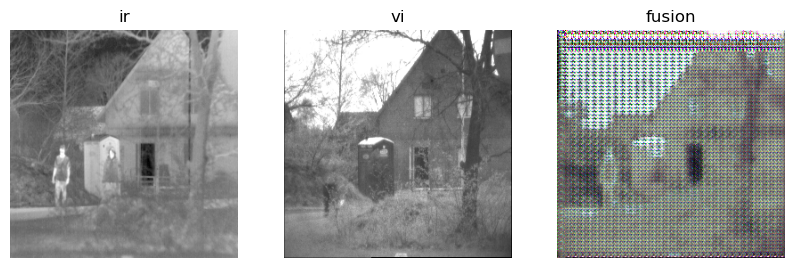

D_epoch_loss:0.005387239390984178,G_epoch_loss11.28898000717163
Epoch: 3103 D_epoch_loss:0.005594271584413946,G_epoch_loss11.29258680343628
Epoch: 3104 D_epoch_loss:0.0027279292698949575,G_epoch_loss17.17451000213623
Epoch: 3105 D_epoch_loss:0.0031312224455177784,G_epoch_loss17.024556159973145
Epoch: 3106 D_epoch_loss:0.002295823651365936,G_epoch_loss16.216301441192627
Epoch: 3107 D_epoch_loss:0.0020391124999150634,G_epoch_loss14.867466449737549
Epoch: 3108 D_epoch_loss:0.004930594353936613,G_epoch_loss12.28775405883789
Epoch: 3109 D_epoch_loss:0.0033009194303303957,G_epoch_loss11.668753147125244
Epoch: 3110 D_epoch_loss:0.004893931560218334,G_epoch_loss10.594895362854004
Epoch: 3111 D_epoch_loss:0.004156726878136396,G_epoch_loss11.569007396697998
Epoch: 3112 D_epoch_loss:0.002569344942457974,G_epoch_loss13.185771942138672
Epoch: 3113 D_epoch_loss:0.0024459974374622107,G_epoch_loss12.932243824005127
Epoch: 3114 D_epoch_loss:0.0042242316994816065,G_epoch_loss11.387409210205078
Epoch: 31

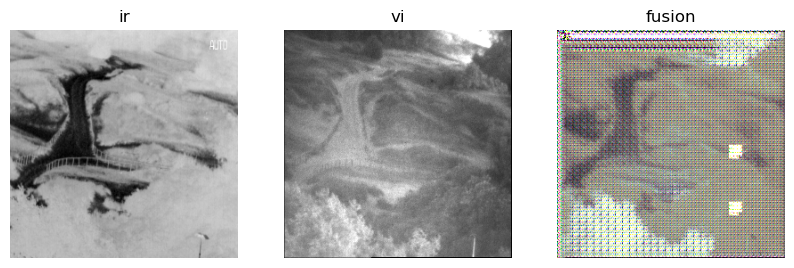

D_epoch_loss:0.0021573909325525165,G_epoch_loss10.94968318939209
Epoch: 3150 D_epoch_loss:0.00325275887735188,G_epoch_loss11.283775329589844
Epoch: 3151 D_epoch_loss:0.006788753089495003,G_epoch_loss10.493406295776367
Epoch: 3152 D_epoch_loss:0.005171894328668714,G_epoch_loss10.109338760375977
Epoch: 3153 D_epoch_loss:0.0053315842524170876,G_epoch_loss9.924938201904297
Epoch: 3154 D_epoch_loss:0.007564485538750887,G_epoch_loss9.941151142120361
Epoch: 3155 D_epoch_loss:0.004016594612039626,G_epoch_loss11.568711757659912
Epoch: 3156 D_epoch_loss:0.0017479524831287563,G_epoch_loss12.515246868133545
Epoch: 3157 D_epoch_loss:0.0028007759246975183,G_epoch_loss11.338934898376465
Epoch: 3158 D_epoch_loss:0.0027180835604667664,G_epoch_loss10.870013236999512
Epoch: 3159 D_epoch_loss:0.0038535583298653364,G_epoch_loss10.991112232208252
Epoch: 3160 D_epoch_loss:0.004598640138283372,G_epoch_loss10.167643070220947
Epoch: 3161 D_epoch_loss:0.002386118925642222,G_epoch_loss11.979102611541748
Epoch: 31

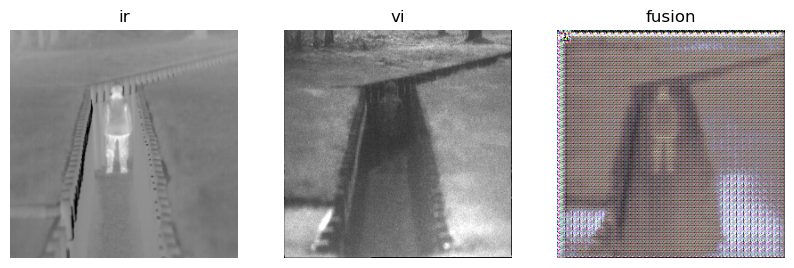

D_epoch_loss:0.0016091633879113942,G_epoch_loss10.163431167602539
Epoch: 3197 D_epoch_loss:0.012351991084869951,G_epoch_loss17.153922080993652
Epoch: 3198 D_epoch_loss:0.0027524308243300766,G_epoch_loss16.583452224731445
Epoch: 3199 D_epoch_loss:0.001997040817514062,G_epoch_loss16.68524169921875
Epoch: 3200 D_epoch_loss:0.0012656034668907523,G_epoch_loss15.404095649719238
Epoch: 3201 D_epoch_loss:0.0013853413984179497,G_epoch_loss15.184837341308594
Epoch: 3202 D_epoch_loss:0.0010388025839347392,G_epoch_loss15.244500160217285
Epoch: 3203 D_epoch_loss:0.00148822704795748,G_epoch_loss14.529693126678467
Epoch: 3204 D_epoch_loss:0.001232656417414546,G_epoch_loss14.471096992492676
Epoch: 3205 D_epoch_loss:0.0027654358418658376,G_epoch_loss14.100868701934814
Epoch: 3206 D_epoch_loss:0.0012142380001023412,G_epoch_loss13.469210624694824
Epoch: 3207 D_epoch_loss:0.001370150945149362,G_epoch_loss12.360465049743652
Epoch: 3208 D_epoch_loss:0.0024051597574725747,G_epoch_loss10.78294563293457
Epoch:

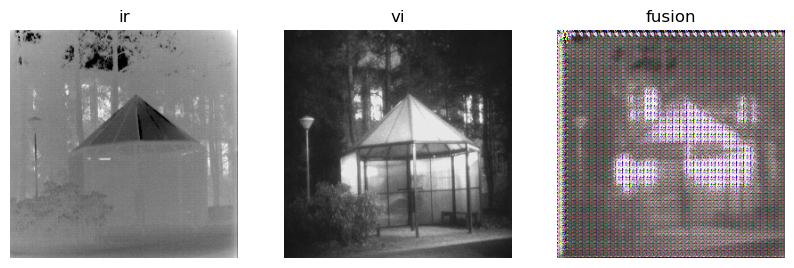

D_epoch_loss:0.00433010864071548,G_epoch_loss9.62725830078125
Epoch: 3244 D_epoch_loss:0.0029651239747181535,G_epoch_loss9.569835186004639
Epoch: 3245 D_epoch_loss:0.0045884158462285995,G_epoch_loss9.104899883270264
Epoch: 3246 D_epoch_loss:0.0026293392293155193,G_epoch_loss9.107385635375977
Epoch: 3247 D_epoch_loss:0.00291671440936625,G_epoch_loss9.273382186889648
Epoch: 3248 D_epoch_loss:0.0031535665038973093,G_epoch_loss8.84815263748169
Epoch: 3249 D_epoch_loss:0.0013983679818920791,G_epoch_loss11.797866821289062
Epoch: 3250 D_epoch_loss:0.0013796878629364073,G_epoch_loss11.7652006149292
Epoch: 3251 D_epoch_loss:0.0036051158094778657,G_epoch_loss9.720208168029785
Epoch: 3252 D_epoch_loss:0.0027351625030860305,G_epoch_loss9.344923973083496
Epoch: 3253 D_epoch_loss:0.002808171324431896,G_epoch_loss10.505899906158447
Epoch: 3254 D_epoch_loss:0.003805489861406386,G_epoch_loss9.713364124298096
Epoch: 3255 D_epoch_loss:0.00551603501662612,G_epoch_loss8.747211933135986
Epoch: 3256 D_epoch_

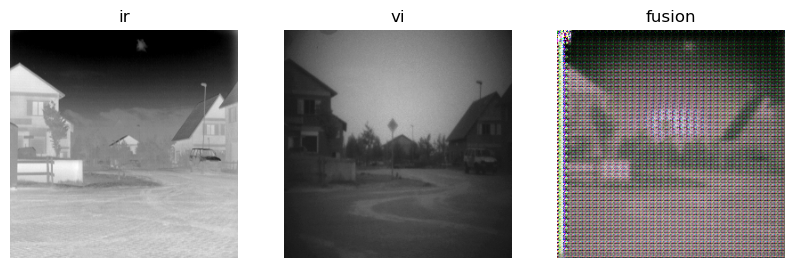

D_epoch_loss:0.001773680909536779,G_epoch_loss10.658138275146484
Epoch: 3291 D_epoch_loss:0.0016015205765143037,G_epoch_loss10.455146789550781
Epoch: 3292 D_epoch_loss:0.00219991581980139,G_epoch_loss9.75680160522461
Epoch: 3293 D_epoch_loss:0.006030595628544688,G_epoch_loss8.756101608276367
Epoch: 3294 D_epoch_loss:0.0018940987647511065,G_epoch_loss12.25007152557373
Epoch: 3295 D_epoch_loss:0.0026646695914678276,G_epoch_loss10.6636381149292
Epoch: 3296 D_epoch_loss:0.0016388043877668679,G_epoch_loss11.777917861938477
Epoch: 3297 D_epoch_loss:0.0034641623497009277,G_epoch_loss10.182200908660889
Epoch: 3298 D_epoch_loss:0.001006529841106385,G_epoch_loss13.291831016540527
Epoch: 3299 D_epoch_loss:0.003192309755831957,G_epoch_loss10.423995971679688
Epoch: 3300 D_epoch_loss:0.0035981988767161965,G_epoch_loss9.97428274154663
Epoch: 3301 D_epoch_loss:0.0035273004323244095,G_epoch_loss9.84283971786499
Epoch: 3302 D_epoch_loss:0.00418394710868597,G_epoch_loss11.333548069000244
Epoch: 3303 D_ep

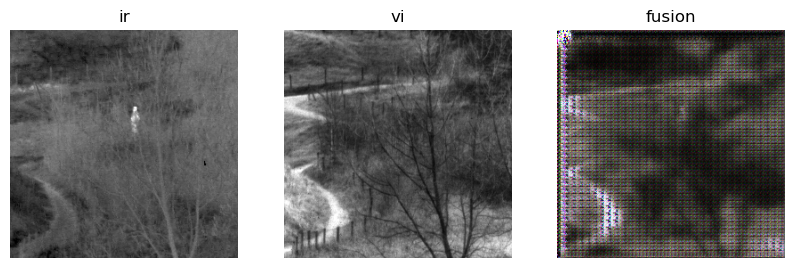

D_epoch_loss:0.001502735773101449,G_epoch_loss12.432549476623535
Epoch: 3338 D_epoch_loss:0.0008376649348065257,G_epoch_loss12.919393539428711
Epoch: 3339 D_epoch_loss:0.002502288785763085,G_epoch_loss9.94622802734375
Epoch: 3340 D_epoch_loss:0.0039286621613428,G_epoch_loss9.627511024475098
Epoch: 3341 D_epoch_loss:0.001638709451071918,G_epoch_loss10.788129329681396
Epoch: 3342 D_epoch_loss:0.005326169077306986,G_epoch_loss10.87605905532837
Epoch: 3343 D_epoch_loss:0.0034286524169147015,G_epoch_loss9.505334377288818
Epoch: 3344 D_epoch_loss:0.0015262719243764877,G_epoch_loss11.14212417602539
Epoch: 3345 D_epoch_loss:0.0013095301110297441,G_epoch_loss10.909074783325195
Epoch: 3346 D_epoch_loss:0.010001727438066155,G_epoch_loss11.300553321838379
Epoch: 3347 D_epoch_loss:0.002855612779967487,G_epoch_loss9.030642986297607
Epoch: 3348 D_epoch_loss:0.0017663951148279011,G_epoch_loss11.361085414886475
Epoch: 3349 D_epoch_loss:0.0013677921961061656,G_epoch_loss11.94461727142334
Epoch: 3350 D_e

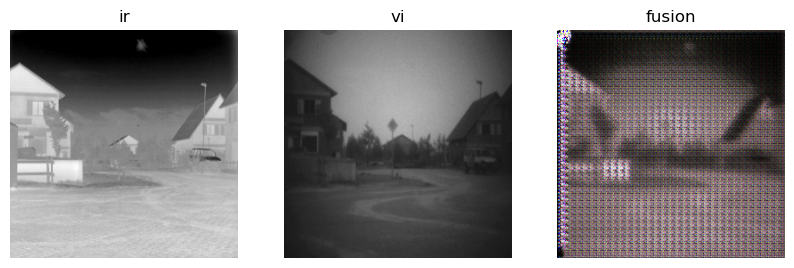

D_epoch_loss:0.0012561243493109941,G_epoch_loss11.061623096466064
Epoch: 3385 D_epoch_loss:0.00143380556255579,G_epoch_loss12.105639457702637
Epoch: 3386 D_epoch_loss:0.0015158664318732917,G_epoch_loss12.063313484191895
Epoch: 3387 D_epoch_loss:0.0020118573447689414,G_epoch_loss11.383378028869629
Epoch: 3388 D_epoch_loss:0.00197475403547287,G_epoch_loss10.059001922607422
Epoch: 3389 D_epoch_loss:0.0010474083246663213,G_epoch_loss11.351276397705078
Epoch: 3390 D_epoch_loss:0.0011276917066425085,G_epoch_loss12.537621021270752
Epoch: 3391 D_epoch_loss:0.0013927746331319213,G_epoch_loss11.908506393432617
Epoch: 3392 D_epoch_loss:0.002252039121231064,G_epoch_loss10.113359928131104
Epoch: 3393 D_epoch_loss:0.0019319512648507953,G_epoch_loss10.744544982910156
Epoch: 3394 D_epoch_loss:0.024316325783729553,G_epoch_loss11.950820922851562
Epoch: 3395 D_epoch_loss:0.0014117337996140122,G_epoch_loss12.076420783996582
Epoch: 3396 D_epoch_loss:0.0035212894435971975,G_epoch_loss9.839427471160889
Epoch

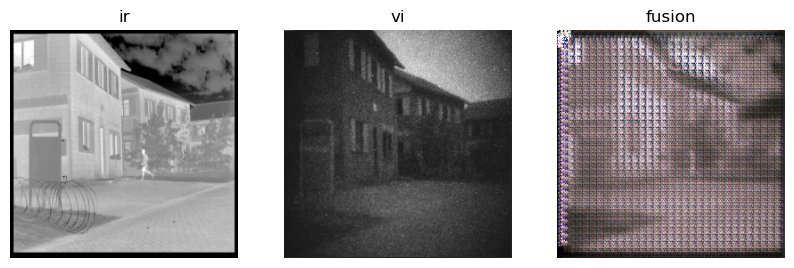

D_epoch_loss:0.002625985536724329,G_epoch_loss10.659493923187256
Epoch: 3432 D_epoch_loss:0.0010030292032752186,G_epoch_loss12.838953971862793
Epoch: 3433 D_epoch_loss:0.004005684866569936,G_epoch_loss10.294685363769531
Epoch: 3434 D_epoch_loss:0.0021189864492043853,G_epoch_loss10.506241798400879
Epoch: 3435 D_epoch_loss:0.0019233783823437989,G_epoch_loss10.130189418792725
Epoch: 3436 D_epoch_loss:0.0009254880424123257,G_epoch_loss12.860133171081543
Epoch: 3437 D_epoch_loss:0.0017089670873247087,G_epoch_loss10.154364585876465
Epoch: 3438 D_epoch_loss:0.0019427282677497715,G_epoch_loss10.516979694366455
Epoch: 3439 D_epoch_loss:0.0014797255862504244,G_epoch_loss11.795933246612549
Epoch: 3440 D_epoch_loss:0.0019468924147076905,G_epoch_loss11.827074527740479
Epoch: 3441 D_epoch_loss:0.002284552319906652,G_epoch_loss12.965350151062012
Epoch: 3442 D_epoch_loss:0.0009137883898802102,G_epoch_loss15.462637424468994
Epoch: 3443 D_epoch_loss:0.0009500613086856902,G_epoch_loss12.448745727539062
E

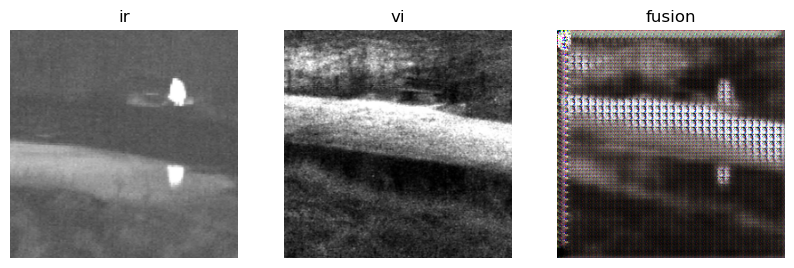

D_epoch_loss:0.0030801250250078738,G_epoch_loss9.684934616088867
Epoch: 3479 D_epoch_loss:0.004107051878236234,G_epoch_loss10.171211242675781
Epoch: 3480 D_epoch_loss:0.0012931214296258986,G_epoch_loss12.055297374725342
Epoch: 3481 D_epoch_loss:0.002391488815192133,G_epoch_loss10.737974643707275
Epoch: 3482 D_epoch_loss:0.001061946531990543,G_epoch_loss11.915542125701904
Epoch: 3483 D_epoch_loss:0.0030332370079122484,G_epoch_loss10.991875171661377
Epoch: 3484 D_epoch_loss:0.002468855120241642,G_epoch_loss9.951000213623047
Epoch: 3485 D_epoch_loss:0.002447969513013959,G_epoch_loss10.930499076843262
Epoch: 3486 D_epoch_loss:0.007194806355983019,G_epoch_loss9.448779582977295
Epoch: 3487 D_epoch_loss:0.0020408726995810866,G_epoch_loss13.670203685760498
Epoch: 3488 D_epoch_loss:0.001948411576449871,G_epoch_loss10.805419921875
Epoch: 3489 D_epoch_loss:0.0023958610836416483,G_epoch_loss9.805553436279297
Epoch: 3490 D_epoch_loss:0.0027251597493886948,G_epoch_loss10.392438888549805
Epoch: 3491 

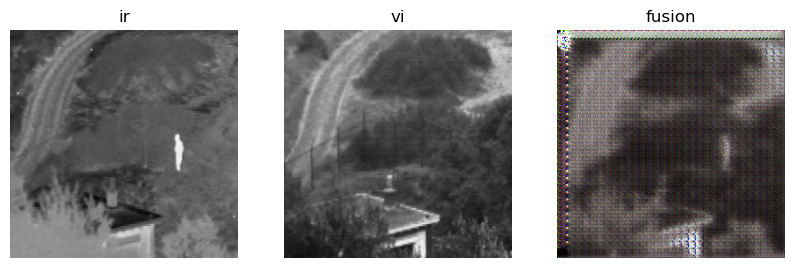

D_epoch_loss:0.0007679593691136688,G_epoch_loss12.036011219024658
Epoch: 3526 D_epoch_loss:0.0014230047236196697,G_epoch_loss10.5076265335083
Epoch: 3527 D_epoch_loss:0.0011423320975154638,G_epoch_loss11.594233989715576
Epoch: 3528 D_epoch_loss:0.0012741715181618929,G_epoch_loss12.143333435058594
Epoch: 3529 D_epoch_loss:0.0030543974426109344,G_epoch_loss12.574783325195312
Epoch: 3530 D_epoch_loss:0.0019110229914076626,G_epoch_loss11.919159889221191
Epoch: 3531 D_epoch_loss:0.0013711245846934617,G_epoch_loss12.04425573348999
Epoch: 3532 D_epoch_loss:0.003039446863112971,G_epoch_loss10.623641014099121
Epoch: 3533 D_epoch_loss:0.001478509366279468,G_epoch_loss11.463592529296875
Epoch: 3534 D_epoch_loss:0.000899758655577898,G_epoch_loss13.594867706298828
Epoch: 3535 D_epoch_loss:0.006398359022568911,G_epoch_loss11.205615520477295
Epoch: 3536 D_epoch_loss:0.003019969444721937,G_epoch_loss10.215983390808105
Epoch: 3537 D_epoch_loss:0.003810030728345737,G_epoch_loss12.165435314178467
Epoch: 

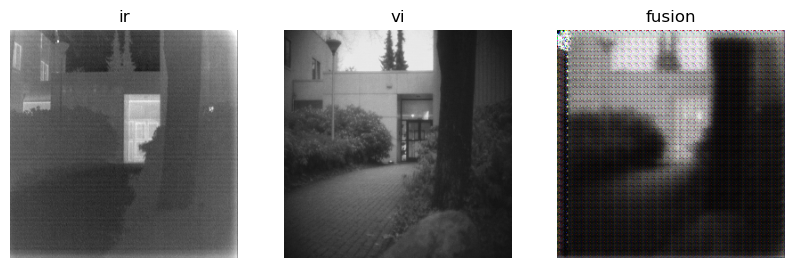

D_epoch_loss:0.00629495398607105,G_epoch_loss11.325500011444092
Epoch: 3573 D_epoch_loss:0.0017659002332948148,G_epoch_loss12.094303607940674
Epoch: 3574 D_epoch_loss:0.0024011008790694177,G_epoch_loss13.713748931884766
Epoch: 3575 D_epoch_loss:0.016236228402704,G_epoch_loss9.856130599975586
Epoch: 3576 D_epoch_loss:0.010811422485858202,G_epoch_loss12.543050765991211
Epoch: 3577 D_epoch_loss:0.008289773832075298,G_epoch_loss13.593001365661621
Epoch: 3578 D_epoch_loss:0.008522864431142807,G_epoch_loss9.814120769500732
Epoch: 3579 D_epoch_loss:0.005338951654266566,G_epoch_loss14.600472450256348
Epoch: 3580 D_epoch_loss:0.023131969734095037,G_epoch_loss11.747403144836426
Epoch: 3581 D_epoch_loss:0.008360264939256012,G_epoch_loss13.413633823394775
Epoch: 3582 D_epoch_loss:0.0020463704131543636,G_epoch_loss12.04871940612793
Epoch: 3583 D_epoch_loss:0.0026952489279210567,G_epoch_loss11.300699710845947
Epoch: 3584 D_epoch_loss:0.21376842813333496,G_epoch_loss17.474692344665527
Epoch: 3585 D_e

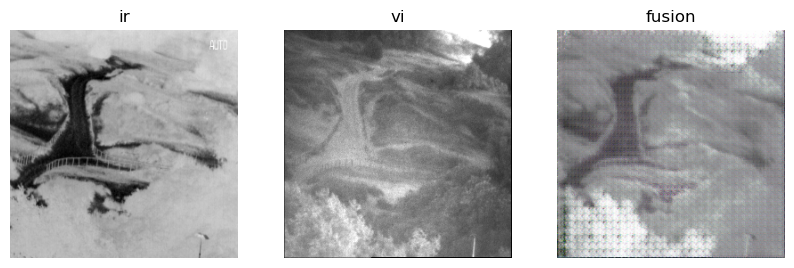

D_epoch_loss:1.1692537069320679,G_epoch_loss2.6212027072906494
Epoch: 3620 D_epoch_loss:0.8867404460906982,G_epoch_loss3.5123515129089355
Epoch: 3621 D_epoch_loss:0.39936627447605133,G_epoch_loss3.165022611618042
Epoch: 3622 D_epoch_loss:0.5563022196292877,G_epoch_loss3.4528366327285767
Epoch: 3623 D_epoch_loss:0.3669530749320984,G_epoch_loss3.557032346725464
Epoch: 3624 D_epoch_loss:0.36474691331386566,G_epoch_loss3.8067331314086914
Epoch: 3625 D_epoch_loss:0.4994107186794281,G_epoch_loss3.7376019954681396
Epoch: 3626 D_epoch_loss:0.5343837589025497,G_epoch_loss2.860721707344055
Epoch: 3627 D_epoch_loss:1.8156805038452148,G_epoch_loss4.210753440856934
Epoch: 3628 D_epoch_loss:0.9780851900577545,G_epoch_loss2.4568222761154175
Epoch: 3629 D_epoch_loss:1.3535102605819702,G_epoch_loss2.5010730028152466
Epoch: 3630 D_epoch_loss:1.2836764454841614,G_epoch_loss2.0937283039093018
Epoch: 3631 D_epoch_loss:0.8466872572898865,G_epoch_loss2.3764370679855347
Epoch: 3632 D_epoch_loss:0.862145334482

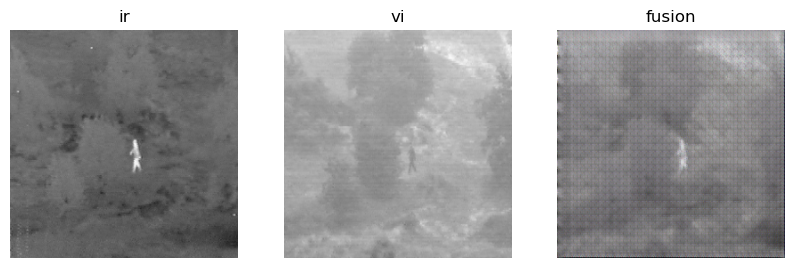

D_epoch_loss:1.1703208088874817,G_epoch_loss2.813295006752014
Epoch: 3667 D_epoch_loss:1.0066747069358826,G_epoch_loss2.6998080015182495
Epoch: 3668 D_epoch_loss:1.6272183656692505,G_epoch_loss2.4002410173416138
Epoch: 3669 D_epoch_loss:1.260933756828308,G_epoch_loss2.4116817116737366
Epoch: 3670 D_epoch_loss:1.8056359887123108,G_epoch_loss2.8395625352859497
Epoch: 3671 D_epoch_loss:1.2352051138877869,G_epoch_loss2.9993191957473755
Epoch: 3672 D_epoch_loss:1.3613905906677246,G_epoch_loss2.4306893348693848
Epoch: 3673 D_epoch_loss:1.2721173763275146,G_epoch_loss2.631520628929138
Epoch: 3674 D_epoch_loss:1.2924367189407349,G_epoch_loss2.8496363162994385
Epoch: 3675 D_epoch_loss:1.1018406748771667,G_epoch_loss2.680763363838196
Epoch: 3676 D_epoch_loss:1.0345725417137146,G_epoch_loss3.098339796066284
Epoch: 3677 D_epoch_loss:1.322589933872223,G_epoch_loss1.9344736337661743
Epoch: 3678 D_epoch_loss:2.1238409280776978,G_epoch_loss2.7942947149276733
Epoch: 3679 D_epoch_loss:1.4180194735527039

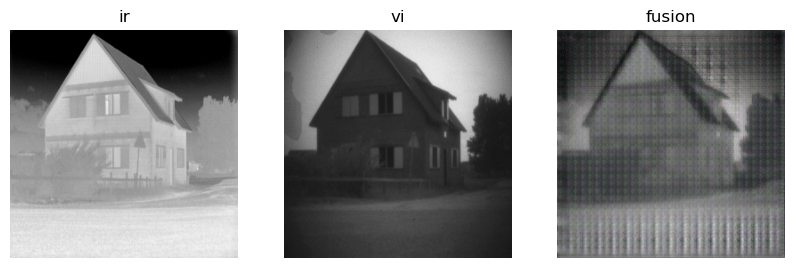

D_epoch_loss:0.4302819073200226,G_epoch_loss3.640070676803589
Epoch: 3714 D_epoch_loss:0.3233538419008255,G_epoch_loss4.301906228065491
Epoch: 3715 D_epoch_loss:0.22300225496292114,G_epoch_loss4.358259916305542
Epoch: 3716 D_epoch_loss:0.2506532520055771,G_epoch_loss4.155011892318726
Epoch: 3717 D_epoch_loss:0.23410283774137497,G_epoch_loss4.226653337478638
Epoch: 3718 D_epoch_loss:0.21478383243083954,G_epoch_loss3.8586628437042236
Epoch: 3719 D_epoch_loss:0.5746482610702515,G_epoch_loss4.632214546203613
Epoch: 3720 D_epoch_loss:2.0005155205726624,G_epoch_loss3.1937676668167114
Epoch: 3721 D_epoch_loss:1.908252477645874,G_epoch_loss2.1533239483833313
Epoch: 3722 D_epoch_loss:1.936887264251709,G_epoch_loss2.7571775913238525
Epoch: 3723 D_epoch_loss:1.7348139882087708,G_epoch_loss2.136483907699585
Epoch: 3724 D_epoch_loss:1.5771868824958801,G_epoch_loss2.7513688802719116
Epoch: 3725 D_epoch_loss:1.4271928668022156,G_epoch_loss2.578862190246582
Epoch: 3726 D_epoch_loss:1.3026959300041199,

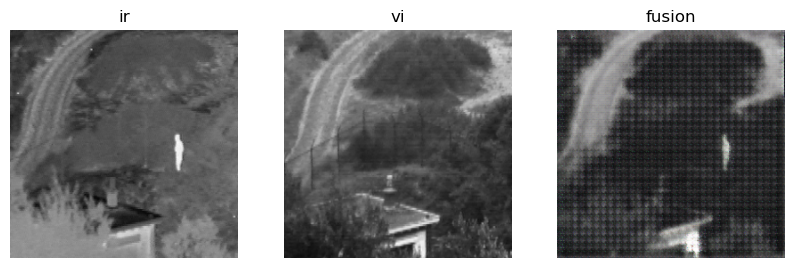

D_epoch_loss:0.23013456165790558,G_epoch_loss4.916214942932129
Epoch: 3761 D_epoch_loss:0.15809015184640884,G_epoch_loss5.0326149463653564
Epoch: 3762 D_epoch_loss:0.13722778856754303,G_epoch_loss4.874170541763306
Epoch: 3763 D_epoch_loss:0.17360755801200867,G_epoch_loss5.4595887660980225
Epoch: 3764 D_epoch_loss:0.16829971969127655,G_epoch_loss5.094972610473633
Epoch: 3765 D_epoch_loss:0.15734322369098663,G_epoch_loss5.016058921813965
Epoch: 3766 D_epoch_loss:0.13260607421398163,G_epoch_loss5.279460430145264
Epoch: 3767 D_epoch_loss:0.17408890277147293,G_epoch_loss5.6000120639801025
Epoch: 3768 D_epoch_loss:0.10738055780529976,G_epoch_loss5.502787828445435
Epoch: 3769 D_epoch_loss:0.2860497832298279,G_epoch_loss6.389401435852051
Epoch: 3770 D_epoch_loss:1.3545574247837067,G_epoch_loss3.358402192592621
Epoch: 3771 D_epoch_loss:1.3564066886901855,G_epoch_loss4.0105085372924805
Epoch: 3772 D_epoch_loss:1.0358605980873108,G_epoch_loss3.8756659030914307
Epoch: 3773 D_epoch_loss:1.936849892

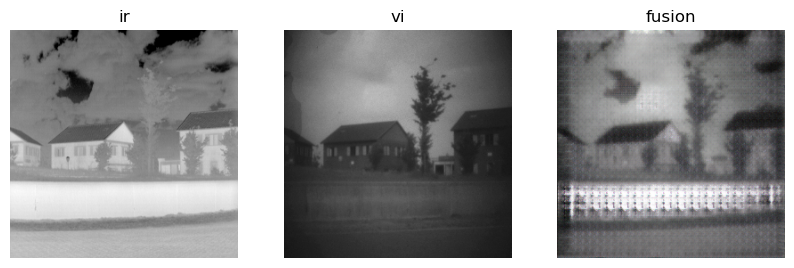

D_epoch_loss:1.3941653370857239,G_epoch_loss2.0342737436294556
Epoch: 3808 D_epoch_loss:1.3678236603736877,G_epoch_loss2.4155433177948
Epoch: 3809 D_epoch_loss:1.376673400402069,G_epoch_loss2.1205779314041138
Epoch: 3810 D_epoch_loss:1.1544854044914246,G_epoch_loss2.36674427986145
Epoch: 3811 D_epoch_loss:1.3912529945373535,G_epoch_loss2.0552691221237183
Epoch: 3812 D_epoch_loss:1.7382382154464722,G_epoch_loss3.0063568353652954
Epoch: 3813 D_epoch_loss:1.2427331805229187,G_epoch_loss1.759365737438202
Epoch: 3814 D_epoch_loss:1.4913151264190674,G_epoch_loss2.487441062927246
Epoch: 3815 D_epoch_loss:1.2945804595947266,G_epoch_loss2.2867204546928406
Epoch: 3816 D_epoch_loss:1.1041240096092224,G_epoch_loss2.0349912643432617
Epoch: 3817 D_epoch_loss:1.242905616760254,G_epoch_loss2.3313766717910767
Epoch: 3818 D_epoch_loss:1.2005365490913391,G_epoch_loss2.4398252964019775
Epoch: 3819 D_epoch_loss:1.0406277775764465,G_epoch_loss2.7924323081970215
Epoch: 3820 D_epoch_loss:1.322049617767334,G_e

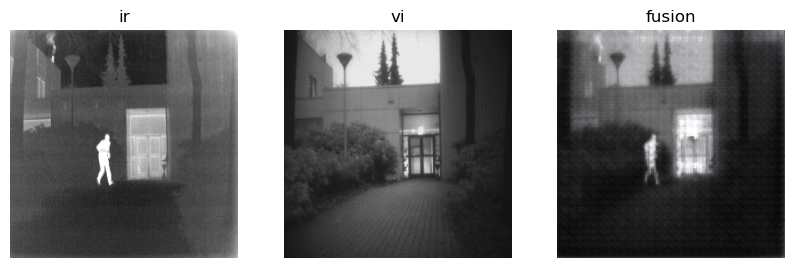

D_epoch_loss:1.5668693780899048,G_epoch_loss2.948500633239746
Epoch: 3855 D_epoch_loss:1.242457389831543,G_epoch_loss2.2459996938705444
Epoch: 3856 D_epoch_loss:1.2925159335136414,G_epoch_loss2.652871608734131
Epoch: 3857 D_epoch_loss:1.3767054677009583,G_epoch_loss2.8055503964424133
Epoch: 3858 D_epoch_loss:1.2086065411567688,G_epoch_loss2.3578388690948486
Epoch: 3859 D_epoch_loss:1.1210684180259705,G_epoch_loss2.556766629219055
Epoch: 3860 D_epoch_loss:1.0845243334770203,G_epoch_loss2.364836096763611
Epoch: 3861 D_epoch_loss:0.87961745262146,G_epoch_loss2.681534767150879
Epoch: 3862 D_epoch_loss:0.778908759355545,G_epoch_loss2.7838802337646484
Epoch: 3863 D_epoch_loss:0.8604313731193542,G_epoch_loss2.5625205039978027
Epoch: 3864 D_epoch_loss:1.7637470364570618,G_epoch_loss3.8953901529312134
Epoch: 3865 D_epoch_loss:1.137272834777832,G_epoch_loss2.5646692514419556
Epoch: 3866 D_epoch_loss:1.2534505128860474,G_epoch_loss2.943397283554077
Epoch: 3867 D_epoch_loss:1.0568908154964447,G_ep

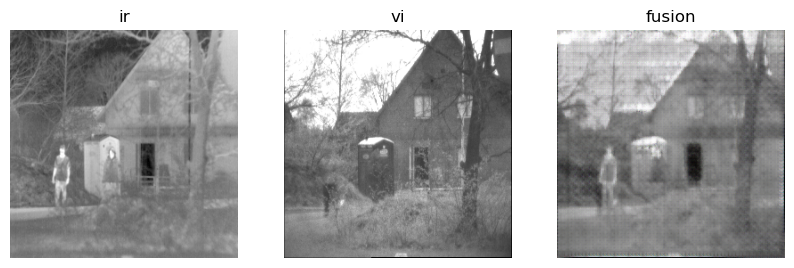

D_epoch_loss:0.7949399948120117,G_epoch_loss2.9790180921554565
Epoch: 3902 D_epoch_loss:0.6272060871124268,G_epoch_loss2.8589946031570435
Epoch: 3903 D_epoch_loss:0.6740388125181198,G_epoch_loss3.069104313850403
Epoch: 3904 D_epoch_loss:0.5532923638820648,G_epoch_loss3.2163310050964355
Epoch: 3905 D_epoch_loss:1.1165521442890167,G_epoch_loss3.298034906387329
Epoch: 3906 D_epoch_loss:0.4243610203266144,G_epoch_loss3.4406877756118774
Epoch: 3907 D_epoch_loss:2.046038568019867,G_epoch_loss3.711913824081421
Epoch: 3908 D_epoch_loss:1.3119944036006927,G_epoch_loss2.8664603233337402
Epoch: 3909 D_epoch_loss:1.174235075712204,G_epoch_loss2.7702577114105225
Epoch: 3910 D_epoch_loss:1.0539286732673645,G_epoch_loss2.9621912240982056
Epoch: 3911 D_epoch_loss:0.6729352325201035,G_epoch_loss3.1405558586120605
Epoch: 3912 D_epoch_loss:0.578530341386795,G_epoch_loss3.294316053390503
Epoch: 3913 D_epoch_loss:0.7766144871711731,G_epoch_loss3.376649022102356
Epoch: 3914 D_epoch_loss:0.34402911365032196,

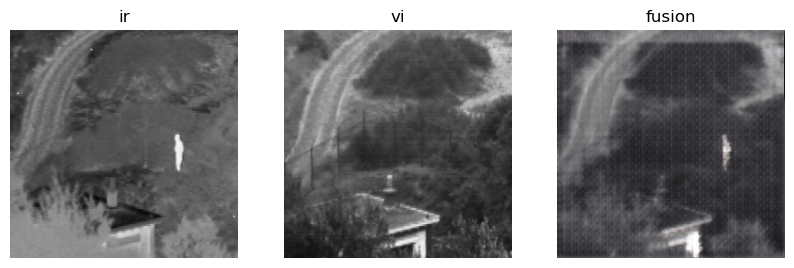

D_epoch_loss:1.367184817790985,G_epoch_loss2.4287331104278564
Epoch: 3949 D_epoch_loss:1.1204320192337036,G_epoch_loss2.0390992164611816
Epoch: 3950 D_epoch_loss:0.9999201893806458,G_epoch_loss2.48593270778656
Epoch: 3951 D_epoch_loss:0.9987560510635376,G_epoch_loss2.0527995824813843
Epoch: 3952 D_epoch_loss:2.2528780698776245,G_epoch_loss2.8435535430908203
Epoch: 3953 D_epoch_loss:1.289593756198883,G_epoch_loss2.203820824623108
Epoch: 3954 D_epoch_loss:1.0566655397415161,G_epoch_loss2.3511645793914795
Epoch: 3955 D_epoch_loss:1.0322538316249847,G_epoch_loss2.8394038677215576
Epoch: 3956 D_epoch_loss:1.0979031324386597,G_epoch_loss2.5607874393463135
Epoch: 3957 D_epoch_loss:0.9911571145057678,G_epoch_loss3.0390591621398926
Epoch: 3958 D_epoch_loss:1.066716343164444,G_epoch_loss2.404116213321686
Epoch: 3959 D_epoch_loss:1.2748174667358398,G_epoch_loss2.8685104846954346
Epoch: 3960 D_epoch_loss:1.2648711800575256,G_epoch_loss2.416068911552429
Epoch: 3961 D_epoch_loss:1.3087830543518066,G

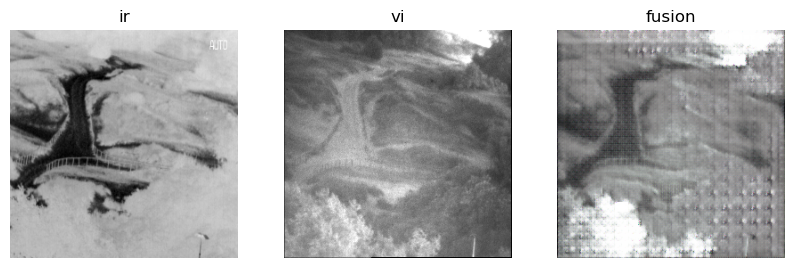

D_epoch_loss:0.945850133895874,G_epoch_loss3.451529026031494
Epoch: 3996 D_epoch_loss:1.5304992198944092,G_epoch_loss2.419965088367462
Epoch: 3997 D_epoch_loss:1.7161918878555298,G_epoch_loss2.860204339027405
Epoch: 3998 D_epoch_loss:1.1821998953819275,G_epoch_loss2.432606816291809
Epoch: 3999 D_epoch_loss:1.6856517791748047,G_epoch_loss2.82215678691864
Epoch: 4000 D_epoch_loss:1.1633703708648682,G_epoch_loss2.4744560718536377
Epoch: 4001 D_epoch_loss:1.237467885017395,G_epoch_loss2.4983534812927246
Epoch: 4002 D_epoch_loss:0.8980287909507751,G_epoch_loss2.7193368673324585
Epoch: 4003 D_epoch_loss:1.3869609832763672,G_epoch_loss2.3616338968276978
Epoch: 4004 D_epoch_loss:1.227428138256073,G_epoch_loss2.6822978258132935
Epoch: 4005 D_epoch_loss:0.971854567527771,G_epoch_loss2.6567991971969604
Epoch: 4006 D_epoch_loss:1.2066811919212341,G_epoch_loss2.2467775344848633
Epoch: 4007 D_epoch_loss:0.9832203984260559,G_epoch_loss2.6858052015304565
Epoch: 4008 D_epoch_loss:1.0217838287353516,G_e

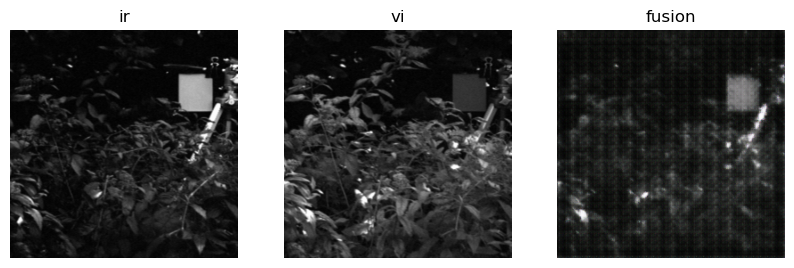

D_epoch_loss:0.6360638439655304,G_epoch_loss3.8880447149276733
Epoch: 4043 D_epoch_loss:0.7542423903942108,G_epoch_loss2.9030345678329468
Epoch: 4044 D_epoch_loss:2.1245461106300354,G_epoch_loss3.9647305011749268
Epoch: 4045 D_epoch_loss:1.6416112184524536,G_epoch_loss2.106718063354492
Epoch: 4046 D_epoch_loss:1.0549634099006653,G_epoch_loss2.7607141733169556
Epoch: 4047 D_epoch_loss:1.2331905961036682,G_epoch_loss2.2598977088928223
Epoch: 4048 D_epoch_loss:1.0305885523557663,G_epoch_loss2.860379457473755
Epoch: 4049 D_epoch_loss:1.0152840316295624,G_epoch_loss2.723137617111206
Epoch: 4050 D_epoch_loss:1.5953220427036285,G_epoch_loss2.946218967437744
Epoch: 4051 D_epoch_loss:1.322677731513977,G_epoch_loss2.579209327697754
Epoch: 4052 D_epoch_loss:0.9298148155212402,G_epoch_loss2.1574432849884033
Epoch: 4053 D_epoch_loss:1.3369963765144348,G_epoch_loss2.511749744415283
Epoch: 4054 D_epoch_loss:1.1093292832374573,G_epoch_loss2.2575870752334595
Epoch: 4055 D_epoch_loss:0.8509925305843353,

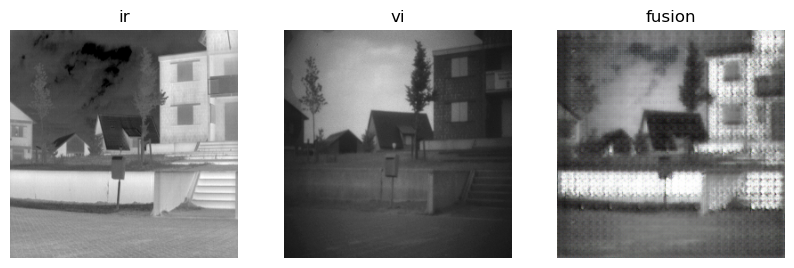

D_epoch_loss:0.8473406434059143,G_epoch_loss2.874365448951721
Epoch: 4090 D_epoch_loss:0.7416051626205444,G_epoch_loss2.796124219894409
Epoch: 4091 D_epoch_loss:0.7873446345329285,G_epoch_loss3.2247698307037354
Epoch: 4092 D_epoch_loss:0.7244921326637268,G_epoch_loss2.92648446559906
Epoch: 4093 D_epoch_loss:0.6123079359531403,G_epoch_loss2.7052464485168457
Epoch: 4094 D_epoch_loss:0.826486736536026,G_epoch_loss3.7211787700653076
Epoch: 4095 D_epoch_loss:0.667709469795227,G_epoch_loss2.8633081912994385
Epoch: 4096 D_epoch_loss:0.8977513015270233,G_epoch_loss4.011964321136475
Epoch: 4097 D_epoch_loss:0.9101748466491699,G_epoch_loss2.919922709465027
Epoch: 4098 D_epoch_loss:1.4872578084468842,G_epoch_loss3.858770251274109
Epoch: 4099 D_epoch_loss:1.1751065254211426,G_epoch_loss2.3503477573394775
Epoch: 4100 D_epoch_loss:0.8528068661689758,G_epoch_loss4.179358720779419
Epoch: 4101 D_epoch_loss:0.5372646450996399,G_epoch_loss3.5053619146347046
Epoch: 4102 D_epoch_loss:1.2692541182041168,G_e

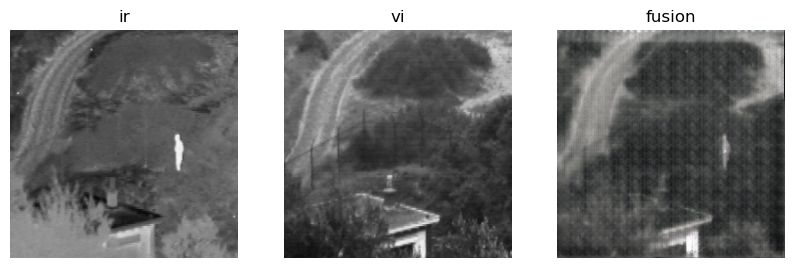

D_epoch_loss:0.8216140866279602,G_epoch_loss2.9901872873306274
Epoch: 4137 D_epoch_loss:0.8096126616001129,G_epoch_loss2.503299355506897
Epoch: 4138 D_epoch_loss:1.2526189684867859,G_epoch_loss3.0021008253097534
Epoch: 4139 D_epoch_loss:0.7301555871963501,G_epoch_loss2.600082516670227
Epoch: 4140 D_epoch_loss:0.8874608874320984,G_epoch_loss2.7344653606414795
Epoch: 4141 D_epoch_loss:1.9570348858833313,G_epoch_loss3.7028361558914185
Epoch: 4142 D_epoch_loss:1.0615073442459106,G_epoch_loss2.2185285091400146
Epoch: 4143 D_epoch_loss:1.1546329855918884,G_epoch_loss3.486691117286682
Epoch: 4144 D_epoch_loss:0.9440373480319977,G_epoch_loss2.253123641014099
Epoch: 4145 D_epoch_loss:1.2061482667922974,G_epoch_loss2.6106691360473633
Epoch: 4146 D_epoch_loss:0.9053514897823334,G_epoch_loss2.5206044912338257
Epoch: 4147 D_epoch_loss:0.5446550846099854,G_epoch_loss2.9735310077667236
Epoch: 4148 D_epoch_loss:0.2748822122812271,G_epoch_loss4.355522155761719
Epoch: 4149 D_epoch_loss:1.070688545703888

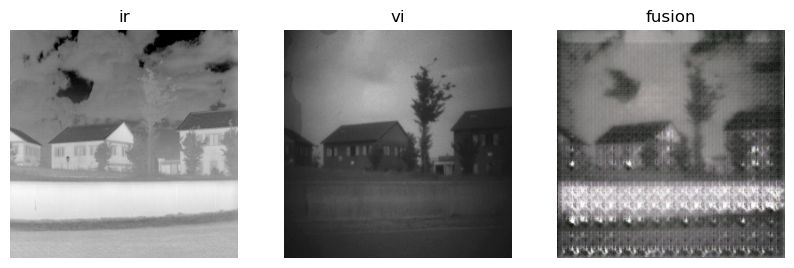

D_epoch_loss:0.9581316709518433,G_epoch_loss2.479952335357666
Epoch: 4184 D_epoch_loss:1.024143636226654,G_epoch_loss2.530088424682617
Epoch: 4185 D_epoch_loss:1.4270576238632202,G_epoch_loss2.291692614555359
Epoch: 4186 D_epoch_loss:1.7729679346084595,G_epoch_loss2.6167733669281006
Epoch: 4187 D_epoch_loss:1.0633398592472076,G_epoch_loss2.222231864929199
Epoch: 4188 D_epoch_loss:1.1966968774795532,G_epoch_loss2.1951072216033936
Epoch: 4189 D_epoch_loss:0.8702166080474854,G_epoch_loss2.562864661216736
Epoch: 4190 D_epoch_loss:0.8115621507167816,G_epoch_loss2.711611270904541
Epoch: 4191 D_epoch_loss:0.9744921922683716,G_epoch_loss2.5503499507904053
Epoch: 4192 D_epoch_loss:1.068507730960846,G_epoch_loss3.0707569122314453
Epoch: 4193 D_epoch_loss:1.0720687210559845,G_epoch_loss3.086651563644409
Epoch: 4194 D_epoch_loss:0.9037405252456665,G_epoch_loss3.0711305141448975
Epoch: 4195 D_epoch_loss:2.315730929374695,G_epoch_loss2.805469036102295
Epoch: 4196 D_epoch_loss:1.1983321607112885,G_ep

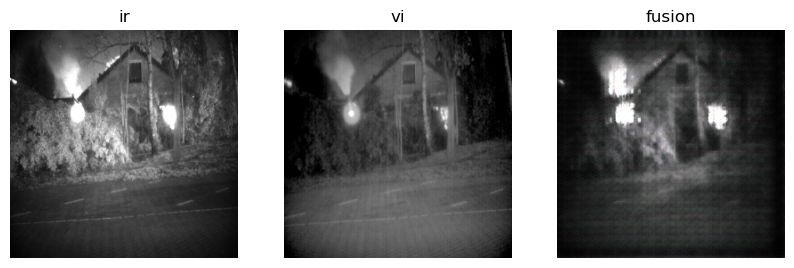

D_epoch_loss:0.7877664268016815,G_epoch_loss2.7101540565490723
Epoch: 4231 D_epoch_loss:0.7707042694091797,G_epoch_loss2.7080949544906616
Epoch: 4232 D_epoch_loss:0.6330481767654419,G_epoch_loss2.9699151515960693
Epoch: 4233 D_epoch_loss:0.7014448642730713,G_epoch_loss2.863216519355774
Epoch: 4234 D_epoch_loss:0.6698887646198273,G_epoch_loss2.9744067192077637
Epoch: 4235 D_epoch_loss:0.5503395199775696,G_epoch_loss3.640197277069092
Epoch: 4236 D_epoch_loss:0.8494340479373932,G_epoch_loss3.1230599880218506
Epoch: 4237 D_epoch_loss:0.4562179744243622,G_epoch_loss3.5551397800445557
Epoch: 4238 D_epoch_loss:0.5438403636217117,G_epoch_loss3.6408450603485107
Epoch: 4239 D_epoch_loss:0.557579442858696,G_epoch_loss3.2549192905426025
Epoch: 4240 D_epoch_loss:0.6142289042472839,G_epoch_loss4.499268054962158
Epoch: 4241 D_epoch_loss:1.412893295288086,G_epoch_loss2.902909278869629
Epoch: 4242 D_epoch_loss:2.07178270816803,G_epoch_loss3.7432548999786377
Epoch: 4243 D_epoch_loss:1.5532655119895935,G

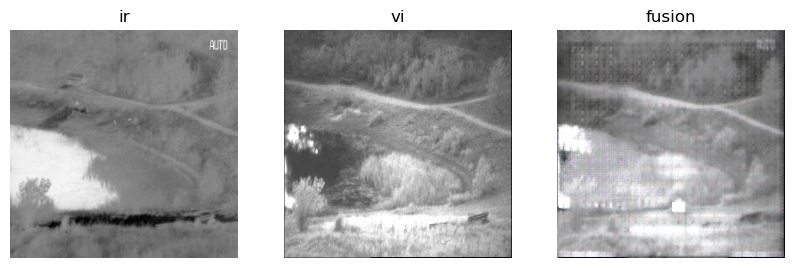

D_epoch_loss:1.5417421460151672,G_epoch_loss2.554567813873291
Epoch: 4278 D_epoch_loss:1.209047019481659,G_epoch_loss2.6782957315444946
Epoch: 4279 D_epoch_loss:1.409979522228241,G_epoch_loss2.445942759513855
Epoch: 4280 D_epoch_loss:1.5640445947647095,G_epoch_loss2.3945285081863403
Epoch: 4281 D_epoch_loss:1.308625042438507,G_epoch_loss2.274134397506714
Epoch: 4282 D_epoch_loss:1.1159693598747253,G_epoch_loss2.388679265975952
Epoch: 4283 D_epoch_loss:0.9990679025650024,G_epoch_loss2.245615005493164
Epoch: 4284 D_epoch_loss:0.8137918412685394,G_epoch_loss2.611992835998535
Epoch: 4285 D_epoch_loss:0.8220728039741516,G_epoch_loss2.6194580793380737
Epoch: 4286 D_epoch_loss:0.9493906199932098,G_epoch_loss2.648278594017029
Epoch: 4287 D_epoch_loss:1.412780910730362,G_epoch_loss2.084326982498169
Epoch: 4288 D_epoch_loss:1.711588740348816,G_epoch_loss2.4471490383148193
Epoch: 4289 D_epoch_loss:1.0501070618629456,G_epoch_loss2.3814398050308228
Epoch: 4290 D_epoch_loss:0.9548909068107605,G_epoc

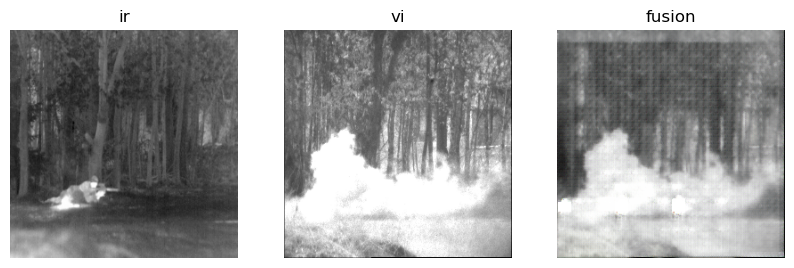

D_epoch_loss:0.5282606333494186,G_epoch_loss3.1543835401535034
Epoch: 4325 D_epoch_loss:1.1381598114967346,G_epoch_loss3.331516146659851
Epoch: 4326 D_epoch_loss:0.5626416057348251,G_epoch_loss3.222666025161743
Epoch: 4327 D_epoch_loss:0.7419631481170654,G_epoch_loss3.1846542358398438
Epoch: 4328 D_epoch_loss:0.6050130128860474,G_epoch_loss3.1222360134124756
Epoch: 4329 D_epoch_loss:0.3890089839696884,G_epoch_loss3.550589084625244
Epoch: 4330 D_epoch_loss:0.5289238691329956,G_epoch_loss3.2504701614379883
Epoch: 4331 D_epoch_loss:0.5119168758392334,G_epoch_loss3.4623806476593018
Epoch: 4332 D_epoch_loss:0.5564541667699814,G_epoch_loss3.845574140548706
Epoch: 4333 D_epoch_loss:0.8290165662765503,G_epoch_loss3.255231261253357
Epoch: 4334 D_epoch_loss:1.687125325202942,G_epoch_loss3.209826111793518
Epoch: 4335 D_epoch_loss:1.4423857927322388,G_epoch_loss3.034027099609375
Epoch: 4336 D_epoch_loss:1.1323432922363281,G_epoch_loss2.7505109310150146
Epoch: 4337 D_epoch_loss:0.8959343731403351,G

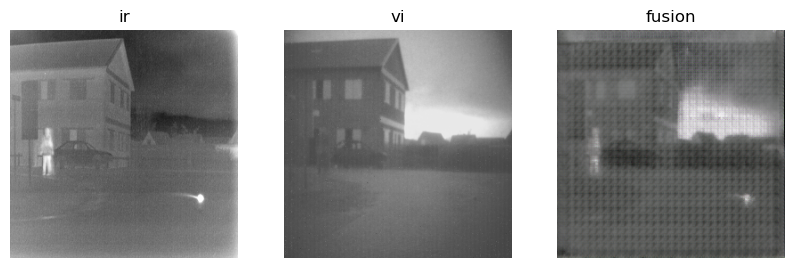

D_epoch_loss:0.7375596091151237,G_epoch_loss4.313145995140076
Epoch: 4372 D_epoch_loss:0.4182431399822235,G_epoch_loss3.797845482826233
Epoch: 4373 D_epoch_loss:0.6048308610916138,G_epoch_loss3.731340169906616
Epoch: 4374 D_epoch_loss:0.5842632353305817,G_epoch_loss3.425561308860779
Epoch: 4375 D_epoch_loss:0.9210143685340881,G_epoch_loss3.3443572521209717
Epoch: 4376 D_epoch_loss:0.6471528708934784,G_epoch_loss3.2190154790878296
Epoch: 4377 D_epoch_loss:0.11336702853441238,G_epoch_loss8.457993507385254
Epoch: 4378 D_epoch_loss:0.26854661852121353,G_epoch_loss8.18848991394043
Epoch: 4379 D_epoch_loss:0.10418878495693207,G_epoch_loss7.352918386459351
Epoch: 4380 D_epoch_loss:0.09228604473173618,G_epoch_loss7.372390031814575
Epoch: 4381 D_epoch_loss:0.07426059991121292,G_epoch_loss6.603390455245972
Epoch: 4382 D_epoch_loss:0.04345681518316269,G_epoch_loss7.180420875549316
Epoch: 4383 D_epoch_loss:0.0441437978297472,G_epoch_loss6.978925943374634
Epoch: 4384 D_epoch_loss:0.0613801367580890

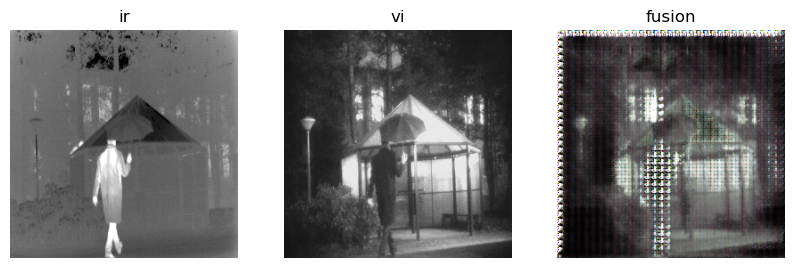

D_epoch_loss:0.05080384574830532,G_epoch_loss6.788126707077026
Epoch: 4419 D_epoch_loss:0.07212243229150772,G_epoch_loss6.641062498092651
Epoch: 4420 D_epoch_loss:0.041339609771966934,G_epoch_loss6.479546785354614
Epoch: 4421 D_epoch_loss:0.05090794712305069,G_epoch_loss6.384087085723877
Epoch: 4422 D_epoch_loss:0.0419409554451704,G_epoch_loss6.66905403137207
Epoch: 4423 D_epoch_loss:0.0385646540671587,G_epoch_loss6.275035858154297
Epoch: 4424 D_epoch_loss:0.07181505672633648,G_epoch_loss6.60857367515564
Epoch: 4425 D_epoch_loss:0.044179122895002365,G_epoch_loss6.095646858215332
Epoch: 4426 D_epoch_loss:0.04418236389756203,G_epoch_loss6.340004205703735
Epoch: 4427 D_epoch_loss:0.04037805646657944,G_epoch_loss6.125700950622559
Epoch: 4428 D_epoch_loss:0.0570678636431694,G_epoch_loss6.343621253967285
Epoch: 4429 D_epoch_loss:0.040566008538007736,G_epoch_loss5.790347337722778
Epoch: 4430 D_epoch_loss:0.07154799625277519,G_epoch_loss5.925075531005859
Epoch: 4431 D_epoch_loss:0.054748121649

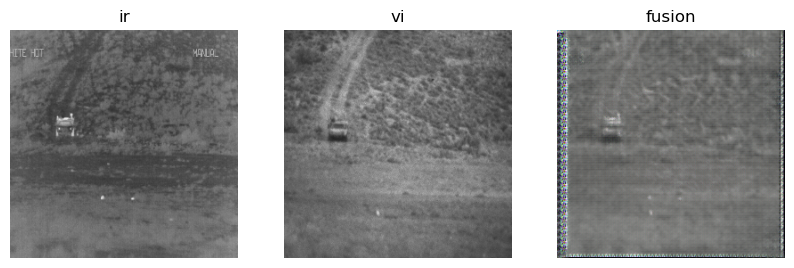

D_epoch_loss:0.0740708764642477,G_epoch_loss5.484795570373535
Epoch: 4466 D_epoch_loss:0.07598373666405678,G_epoch_loss5.64152717590332
Epoch: 4467 D_epoch_loss:0.0547115933150053,G_epoch_loss5.94892692565918
Epoch: 4468 D_epoch_loss:0.06081552244722843,G_epoch_loss6.398746967315674
Epoch: 4469 D_epoch_loss:0.06340571865439415,G_epoch_loss5.851162433624268
Epoch: 4470 D_epoch_loss:0.07714471966028214,G_epoch_loss7.394377708435059
Epoch: 4471 D_epoch_loss:0.043577782809734344,G_epoch_loss6.682559251785278
Epoch: 4472 D_epoch_loss:0.07156741991639137,G_epoch_loss6.37842869758606
Epoch: 4473 D_epoch_loss:0.10137179866433144,G_epoch_loss5.686070442199707
Epoch: 4474 D_epoch_loss:0.11935029737651348,G_epoch_loss6.3334290981292725
Epoch: 4475 D_epoch_loss:0.039198669604957104,G_epoch_loss7.402992010116577
Epoch: 4476 D_epoch_loss:0.02299347845837474,G_epoch_loss9.07460880279541
Epoch: 4477 D_epoch_loss:0.020588007755577564,G_epoch_loss10.727245330810547
Epoch: 4478 D_epoch_loss:0.01814092695

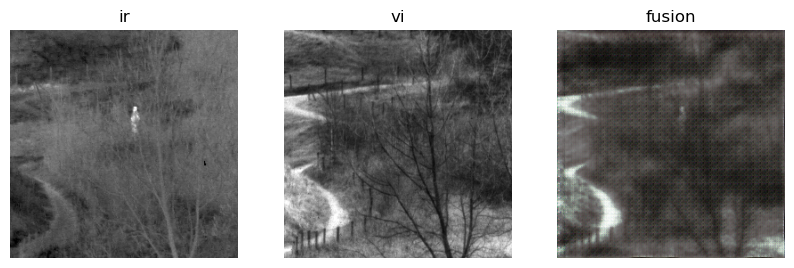

D_epoch_loss:0.48366549611091614,G_epoch_loss4.236966609954834
Epoch: 4513 D_epoch_loss:0.6939614415168762,G_epoch_loss3.067020535469055
Epoch: 4514 D_epoch_loss:1.5816829204559326,G_epoch_loss2.8553029894828796
Epoch: 4515 D_epoch_loss:1.4629684686660767,G_epoch_loss3.115042209625244
Epoch: 4516 D_epoch_loss:0.9696439206600189,G_epoch_loss2.7500816583633423
Epoch: 4517 D_epoch_loss:0.7601028382778168,G_epoch_loss2.968538522720337
Epoch: 4518 D_epoch_loss:0.7518681585788727,G_epoch_loss3.0341635942459106
Epoch: 4519 D_epoch_loss:1.0297412276268005,G_epoch_loss2.773730993270874
Epoch: 4520 D_epoch_loss:1.0650505423545837,G_epoch_loss3.4018332958221436
Epoch: 4521 D_epoch_loss:0.7852720320224762,G_epoch_loss3.3450212478637695
Epoch: 4522 D_epoch_loss:1.8459259569644928,G_epoch_loss2.364616870880127
Epoch: 4523 D_epoch_loss:1.4193905591964722,G_epoch_loss3.0251145362854004
Epoch: 4524 D_epoch_loss:1.1794222295284271,G_epoch_loss2.921334743499756
Epoch: 4525 D_epoch_loss:0.9537886679172516

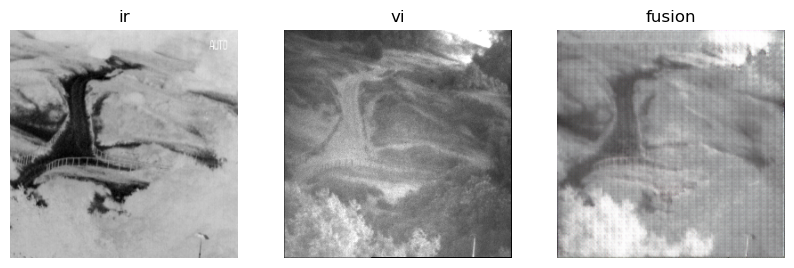

D_epoch_loss:0.8692162334918976,G_epoch_loss3.046018123626709
Epoch: 4560 D_epoch_loss:0.7295069992542267,G_epoch_loss2.952024817466736
Epoch: 4561 D_epoch_loss:1.027485877275467,G_epoch_loss2.9881391525268555
Epoch: 4562 D_epoch_loss:0.8473085165023804,G_epoch_loss3.646548867225647
Epoch: 4563 D_epoch_loss:0.941135823726654,G_epoch_loss4.1707024574279785
Epoch: 4564 D_epoch_loss:1.7396222352981567,G_epoch_loss2.392072558403015
Epoch: 4565 D_epoch_loss:1.260120153427124,G_epoch_loss3.9181712865829468
Epoch: 4566 D_epoch_loss:1.5542659163475037,G_epoch_loss2.595873475074768
Epoch: 4567 D_epoch_loss:1.0588766932487488,G_epoch_loss2.7895408868789673
Epoch: 4568 D_epoch_loss:1.2111528813838959,G_epoch_loss3.1507502794265747
Epoch: 4569 D_epoch_loss:1.1427873373031616,G_epoch_loss2.769517183303833
Epoch: 4570 D_epoch_loss:0.9043612778186798,G_epoch_loss2.758678436279297
Epoch: 4571 D_epoch_loss:0.5184288918972015,G_epoch_loss3.214498519897461
Epoch: 4572 D_epoch_loss:0.9633906781673431,G_ep

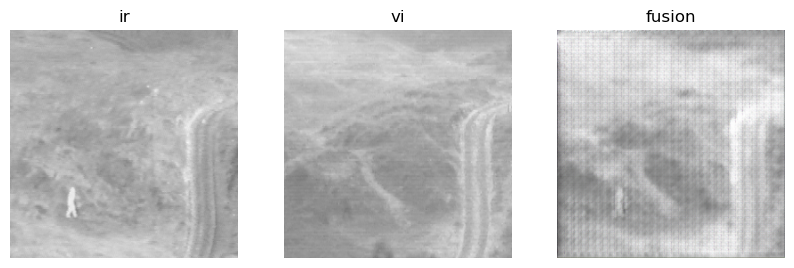

D_epoch_loss:0.8884729146957397,G_epoch_loss3.362971782684326
Epoch: 4607 D_epoch_loss:0.7822225689888,G_epoch_loss2.8833765983581543
Epoch: 4608 D_epoch_loss:0.7387375831604004,G_epoch_loss3.639781951904297
Epoch: 4609 D_epoch_loss:0.8193890750408173,G_epoch_loss3.16947603225708
Epoch: 4610 D_epoch_loss:0.6883950531482697,G_epoch_loss3.5845911502838135
Epoch: 4611 D_epoch_loss:0.5868809521198273,G_epoch_loss3.356738805770874
Epoch: 4612 D_epoch_loss:0.49294570088386536,G_epoch_loss3.967649221420288
Epoch: 4613 D_epoch_loss:1.1990877240896225,G_epoch_loss3.0445477962493896
Epoch: 4614 D_epoch_loss:1.1505964398384094,G_epoch_loss3.5339478254318237
Epoch: 4615 D_epoch_loss:1.061063826084137,G_epoch_loss2.880605697631836
Epoch: 4616 D_epoch_loss:0.9057604372501373,G_epoch_loss3.4148696660995483
Epoch: 4617 D_epoch_loss:0.7809879779815674,G_epoch_loss2.7258217334747314
Epoch: 4618 D_epoch_loss:0.9136103987693787,G_epoch_loss3.0512478351593018
Epoch: 4619 D_epoch_loss:0.7763718664646149,G_e

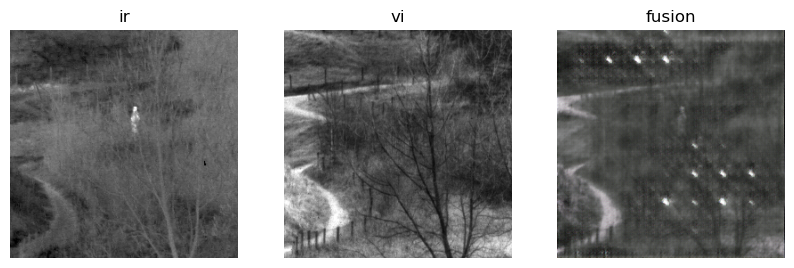

D_epoch_loss:1.1108353734016418,G_epoch_loss2.8165589570999146
Epoch: 4654 D_epoch_loss:0.49157246947288513,G_epoch_loss3.2554831504821777
Epoch: 4655 D_epoch_loss:0.6245829164981842,G_epoch_loss3.100391149520874
Epoch: 4656 D_epoch_loss:0.4788123667240143,G_epoch_loss3.55385684967041
Epoch: 4657 D_epoch_loss:0.33542436361312866,G_epoch_loss3.4908761978149414
Epoch: 4658 D_epoch_loss:0.3397188261151314,G_epoch_loss4.212623238563538
Epoch: 4659 D_epoch_loss:0.2912522703409195,G_epoch_loss3.9758238792419434
Epoch: 4660 D_epoch_loss:0.6176928132772446,G_epoch_loss3.5128769874572754
Epoch: 4661 D_epoch_loss:0.8796911239624023,G_epoch_loss5.129902243614197
Epoch: 4662 D_epoch_loss:1.3657071590423584,G_epoch_loss2.751587152481079
Epoch: 4663 D_epoch_loss:2.1823692321777344,G_epoch_loss3.2325631380081177
Epoch: 4664 D_epoch_loss:1.3362823724746704,G_epoch_loss2.6207385063171387
Epoch: 4665 D_epoch_loss:0.8805768489837646,G_epoch_loss2.6269001960754395
Epoch: 4666 D_epoch_loss:0.51319450139999

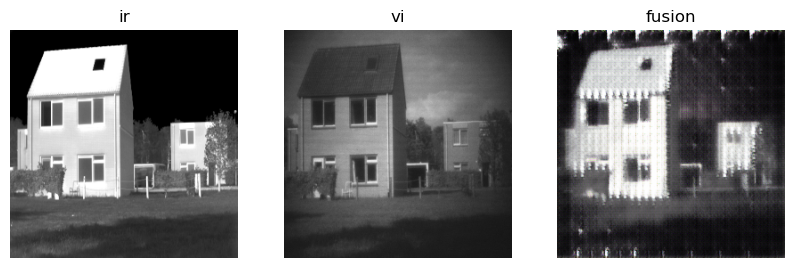

D_epoch_loss:0.08873432129621506,G_epoch_loss7.446739912033081
Epoch: 4701 D_epoch_loss:0.05987105332314968,G_epoch_loss7.142205238342285
Epoch: 4702 D_epoch_loss:0.07822076231241226,G_epoch_loss6.421152591705322
Epoch: 4703 D_epoch_loss:0.11760620027780533,G_epoch_loss5.6136314868927
Epoch: 4704 D_epoch_loss:0.10136758536100388,G_epoch_loss6.006853103637695
Epoch: 4705 D_epoch_loss:0.2005612626671791,G_epoch_loss5.1895647048950195
Epoch: 4706 D_epoch_loss:0.23429006338119507,G_epoch_loss5.031538724899292
Epoch: 4707 D_epoch_loss:0.13369836658239365,G_epoch_loss5.4112548828125
Epoch: 4708 D_epoch_loss:0.141272634267807,G_epoch_loss5.657533884048462
Epoch: 4709 D_epoch_loss:0.15762555599212646,G_epoch_loss5.896911382675171
Epoch: 4710 D_epoch_loss:0.14006415009498596,G_epoch_loss5.550056219100952
Epoch: 4711 D_epoch_loss:0.22686507552862167,G_epoch_loss5.534156322479248
Epoch: 4712 D_epoch_loss:0.1237281858921051,G_epoch_loss5.58487868309021
Epoch: 4713 D_epoch_loss:0.0935322530567646,G

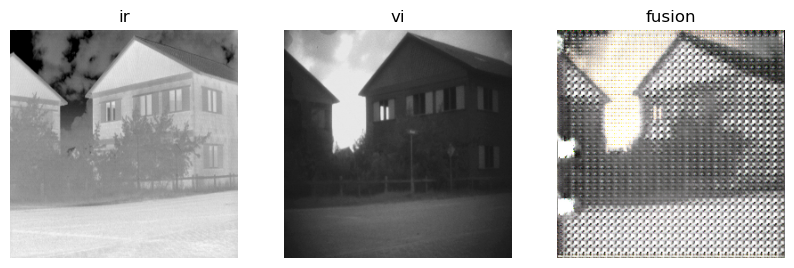

D_epoch_loss:0.035395894199609756,G_epoch_loss6.771213054656982
Epoch: 4748 D_epoch_loss:0.06245709955692291,G_epoch_loss5.652957201004028
Epoch: 4749 D_epoch_loss:0.1319439448416233,G_epoch_loss5.44675350189209
Epoch: 4750 D_epoch_loss:0.12165378406643867,G_epoch_loss5.369879961013794
Epoch: 4751 D_epoch_loss:0.2857952415943146,G_epoch_loss5.595928430557251
Epoch: 4752 D_epoch_loss:0.06395706906914711,G_epoch_loss6.427814960479736
Epoch: 4753 D_epoch_loss:0.10243458300828934,G_epoch_loss8.250227928161621
Epoch: 4754 D_epoch_loss:0.055332137271761894,G_epoch_loss6.972607135772705
Epoch: 4755 D_epoch_loss:0.045998355373740196,G_epoch_loss6.721022129058838
Epoch: 4756 D_epoch_loss:0.08915617316961288,G_epoch_loss5.516143798828125
Epoch: 4757 D_epoch_loss:0.04331440292298794,G_epoch_loss7.172069072723389
Epoch: 4758 D_epoch_loss:0.09399467706680298,G_epoch_loss5.468471527099609
Epoch: 4759 D_epoch_loss:0.03800512105226517,G_epoch_loss7.832626581192017
Epoch: 4760 D_epoch_loss:0.0979279167

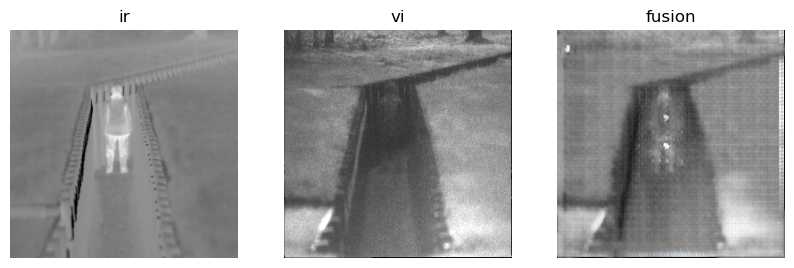

D_epoch_loss:0.9727518558502197,G_epoch_loss3.2690011262893677
Epoch: 4795 D_epoch_loss:0.5803045928478241,G_epoch_loss2.8026371002197266
Epoch: 4796 D_epoch_loss:0.9863223731517792,G_epoch_loss2.7808812856674194
Epoch: 4797 D_epoch_loss:0.6812627017498016,G_epoch_loss2.9776378870010376
Epoch: 4798 D_epoch_loss:1.083313226699829,G_epoch_loss2.904063582420349
Epoch: 4799 D_epoch_loss:1.0403752326965332,G_epoch_loss2.634886622428894
Epoch: 4800 D_epoch_loss:0.6389387547969818,G_epoch_loss3.402604818344116
Epoch: 4801 D_epoch_loss:0.46730755269527435,G_epoch_loss3.5602651834487915
Epoch: 4802 D_epoch_loss:0.624762237071991,G_epoch_loss2.529624581336975
Epoch: 4803 D_epoch_loss:0.8267079591751099,G_epoch_loss5.074607610702515
Epoch: 4804 D_epoch_loss:0.5173987150192261,G_epoch_loss3.6772948503494263
Epoch: 4805 D_epoch_loss:0.7330317944288254,G_epoch_loss3.3494138717651367
Epoch: 4806 D_epoch_loss:0.8328776061534882,G_epoch_loss4.821160078048706
Epoch: 4807 D_epoch_loss:0.694658137857914,G

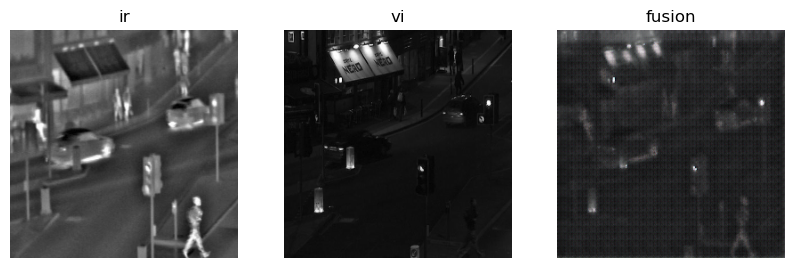

D_epoch_loss:0.42609699070453644,G_epoch_loss3.3830641508102417
Epoch: 4842 D_epoch_loss:0.6226949393749237,G_epoch_loss3.8106871843338013
Epoch: 4843 D_epoch_loss:0.5370197892189026,G_epoch_loss4.832245826721191
Epoch: 4844 D_epoch_loss:0.19454354047775269,G_epoch_loss4.43978476524353
Epoch: 4845 D_epoch_loss:0.7437182068824768,G_epoch_loss4.974440813064575
Epoch: 4846 D_epoch_loss:0.5809184014797211,G_epoch_loss4.677153825759888
Epoch: 4847 D_epoch_loss:0.4135736711323261,G_epoch_loss6.479891300201416
Epoch: 4848 D_epoch_loss:0.2672644630074501,G_epoch_loss9.890799045562744
Epoch: 4849 D_epoch_loss:0.07711627706885338,G_epoch_loss8.20896291732788
Epoch: 4850 D_epoch_loss:0.027095324359834194,G_epoch_loss7.130399942398071
Epoch: 4851 D_epoch_loss:0.05970825348049402,G_epoch_loss6.187872409820557
Epoch: 4852 D_epoch_loss:0.11843058466911316,G_epoch_loss5.020555734634399
Epoch: 4853 D_epoch_loss:0.11342736333608627,G_epoch_loss5.755513668060303
Epoch: 4854 D_epoch_loss:0.350962229073047

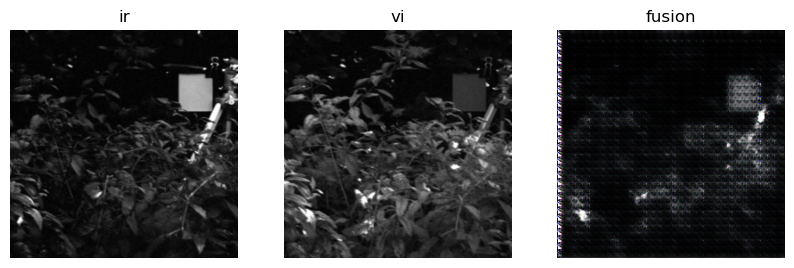

D_epoch_loss:0.05191591754555702,G_epoch_loss6.5753014087677
Epoch: 4889 D_epoch_loss:0.05175819247961044,G_epoch_loss6.4947898387908936
Epoch: 4890 D_epoch_loss:0.05043954961001873,G_epoch_loss6.613817453384399
Epoch: 4891 D_epoch_loss:0.02982151508331299,G_epoch_loss7.0333967208862305
Epoch: 4892 D_epoch_loss:0.033140890300273895,G_epoch_loss6.465802192687988
Epoch: 4893 D_epoch_loss:0.04209153167903423,G_epoch_loss6.467104911804199
Epoch: 4894 D_epoch_loss:0.09210292529314756,G_epoch_loss6.552838087081909
Epoch: 4895 D_epoch_loss:0.03904948756098747,G_epoch_loss6.01075553894043
Epoch: 4896 D_epoch_loss:0.06355806812644005,G_epoch_loss6.357134819030762
Epoch: 4897 D_epoch_loss:0.09454560279846191,G_epoch_loss6.101315259933472
Epoch: 4898 D_epoch_loss:0.10917651653289795,G_epoch_loss6.343233823776245
Epoch: 4899 D_epoch_loss:0.12410690635442734,G_epoch_loss5.837742805480957
Epoch: 4900 D_epoch_loss:0.1004149280488491,G_epoch_loss6.829198122024536
Epoch: 4901 D_epoch_loss:0.11783950775

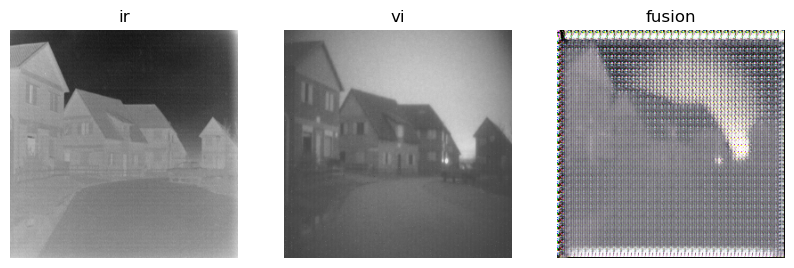

D_epoch_loss:0.045854903757572174,G_epoch_loss8.010932445526123
Epoch: 4936 D_epoch_loss:0.05737913213670254,G_epoch_loss7.963038444519043
Epoch: 4937 D_epoch_loss:0.09387011080980301,G_epoch_loss7.5686633586883545
Epoch: 4938 D_epoch_loss:0.06816231831908226,G_epoch_loss7.322208642959595
Epoch: 4939 D_epoch_loss:0.07111838832497597,G_epoch_loss7.798034906387329
Epoch: 4940 D_epoch_loss:0.07295974716544151,G_epoch_loss8.02808165550232
Epoch: 4941 D_epoch_loss:0.08723828196525574,G_epoch_loss7.843075752258301
Epoch: 4942 D_epoch_loss:0.06139119900763035,G_epoch_loss7.970034122467041
Epoch: 4943 D_epoch_loss:0.06685210764408112,G_epoch_loss7.959546327590942
Epoch: 4944 D_epoch_loss:0.07221755385398865,G_epoch_loss7.738137722015381
Epoch: 4945 D_epoch_loss:0.08099382370710373,G_epoch_loss8.266177654266357
Epoch: 4946 D_epoch_loss:0.06890178844332695,G_epoch_loss8.210469245910645
Epoch: 4947 D_epoch_loss:0.08100828714668751,G_epoch_loss9.151920318603516
Epoch: 4948 D_epoch_loss:0.059154815

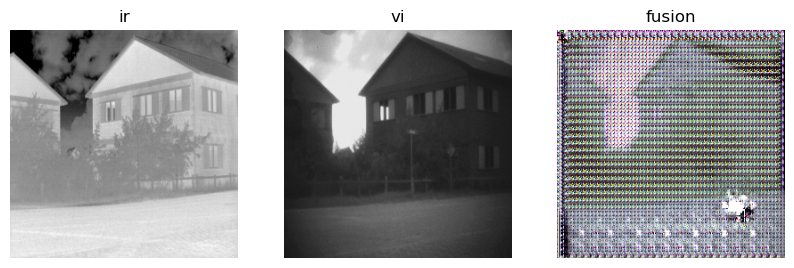

D_epoch_loss:0.046740349382162094,G_epoch_loss9.262413501739502
Epoch: 4983 D_epoch_loss:0.04761909134685993,G_epoch_loss8.942952156066895
Epoch: 4984 D_epoch_loss:0.05930823087692261,G_epoch_loss8.642068862915039
Epoch: 4985 D_epoch_loss:0.058424774557352066,G_epoch_loss8.535955429077148
Epoch: 4986 D_epoch_loss:0.06371078453958035,G_epoch_loss8.753550052642822
Epoch: 4987 D_epoch_loss:0.07565299049019814,G_epoch_loss8.355778217315674
Epoch: 4988 D_epoch_loss:0.050410639494657516,G_epoch_loss8.907450199127197
Epoch: 4989 D_epoch_loss:0.03580483980476856,G_epoch_loss8.77170991897583
Epoch: 4990 D_epoch_loss:0.05940455198287964,G_epoch_loss8.673297882080078
Epoch: 4991 D_epoch_loss:0.05299511179327965,G_epoch_loss8.456881523132324
Epoch: 4992 D_epoch_loss:0.034852730110287666,G_epoch_loss8.554146766662598
Epoch: 4993 D_epoch_loss:0.02748436387628317,G_epoch_loss8.809120178222656
Epoch: 4994 D_epoch_loss:0.06138869374990463,G_epoch_loss8.472235202789307
Epoch: 4995 D_epoch_loss:0.0370803

In [26]:
# 
D_loss = []
G_loss = []
res = []
for epoch in range(5000):
    D_epoch_loss = 0
    G_epoch_loss = 0
    count = len(train_dl)
    for step,(vi,ir) in enumerate(train_dl):
        ir = ir.to(device)
        vi = vi.to(device)
        d_optimizer.zero_grad()
        #输入真实图片，判别器判定为真
        disc_real_output = dis(ir,vi) #输入真实的成对图片
        d_real_loss = loss_fn(disc_real_output,torch.ones_like(disc_real_output,device = device))
        d_real_loss.backward()
        #输入生成图片，判定为假
        gen_output = gen(vi,ir)
        disc_gen_output = dis(ir,gen_output.detach())#输入生成图像
        d_fake_loss = loss_fn(disc_gen_output,torch.zeros_like(disc_gen_output,device = device))
        d_fake_loss.backward()
        # 判定器的loss由两部分组成
        disc_loss = d_real_loss + d_fake_loss
        #更新判别器参数
        d_optimizer.step()
        
        g_optimizer.zero_grad()
        # 将生成的图片放入判别器
        disc_gen_out = dis(ir,gen_output)
        # 得到生成器的损失
        gen_loss_crossentropyloss = loss_fn(disc_gen_out,torch.ones_like(disc_gen_out,device = device))
        gen_l1_loss = torch.mean(torch.abs(gen_output - vi*0.5 - ir*0.5 ))
        gen_loss = gen_loss_crossentropyloss + LAMDA*gen_l1_loss
        gen_loss.backward()
        #更新生成器梯度
        g_optimizer.step()
        with torch.no_grad():
            D_epoch_loss += disc_loss.item()
            G_epoch_loss += gen_loss.item()
    with torch.no_grad():
        D_epoch_loss /=count
        G_epoch_loss /=count
        D_loss.append(D_epoch_loss)
        G_loss.append(G_epoch_loss)
        # 训练完一个epoch就打印输出
        print("Epoch:",epoch,end=' ')
        if epoch%47==0:
            ress = genarate_images(gen,ir,vi)
            res.append(ress)
        print(f'D_epoch_loss:{D_epoch_loss},G_epoch_loss{G_epoch_loss}')

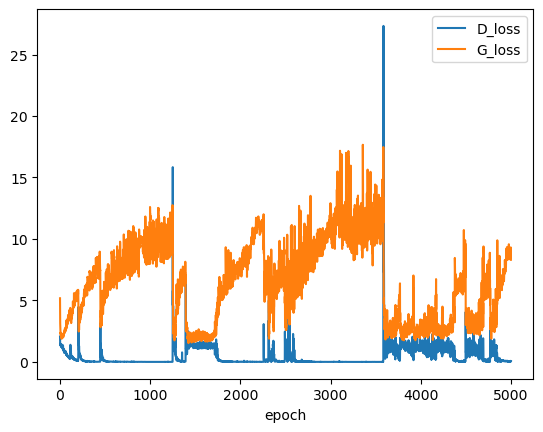

In [27]:
plt.plot(range(1, len(D_loss)+1), D_loss, label='D_loss')
plt.plot(range(1, len(G_loss)+1), G_loss, label='G_loss')
plt.xlabel('epoch')
plt.legend()
plt.show()

In [28]:
import pandas as pd
data = pd.DataFrame()
data['res'] = res
data['Gloss'] = G_loss[len(res)]
data['Dloss'] = D_loss[len(res)]
data.to_excel('excel/02.xlsx')
# 模型参数保存
torch.save(gen.state_dict(), 'w/model_02.pth')